In [1]:
#py3.8
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import anndata
import seaborn as sns

In [2]:
import warnings
warnings.filterwarnings('ignore')
import os
print(os.getcwd())

/Users/gaos1/Library/CloudStorage/OneDrive-MemorialSloanKetteringCancerCenter/bioinformatics_working/SG_scrna_0


Working on adata v1.3, after iterative clean up and annotation

# Loading & Saving

In [3]:
adata = sc.read_h5ad('intermediate/adata_from_mdata_gex_annotation1.4.h5ad')

In [4]:
adata_LN = adata[adata.obs['organ'] =='LN']
adata_LV = adata[adata.obs['organ'] =='LV']

In [ ]:
adata_4groups = adata[adata.obs['genotype'] != '3KO']
# exluding samples from the 3KO genotype

In [38]:
# after sc.tl.rank_genes_groups(adata, 'annotation', method='wilcoxon', key_added = "wilcoxon_anno")
adata.write_h5ad('intermediate/adata_from_mdata_gex_annotation1.4.h5ad')

## Formating

In [5]:
adata_LV.obs['genotype'].cat.reorder_categories(['WT', 'RII', 'PD1', '2KO', '3KO'], inplace=True)
adata_LN.obs['genotype'].cat.reorder_categories(['WT', 'RII', 'PD1', '2KO', '3KO'], inplace=True)
adata.obs['genotype'].cat.reorder_categories(['WT', 'RII', 'PD1', '2KO', '3KO'], inplace=True)

In [15]:
# annotation of clusters
print(*sorted(adata.obs['annotation'].unique()), sep='\n')

00_Naive_Trbv
01_Naive
02_Activated
03_Tfh
04_Precursor_Th1
05_Tfh_like_Th1
06_Th1
07_TRM_like_Th1
08_TEM_like_Th1
09_Miscellaneous_Th
10_Treg
11_Proliferating


## Color palette

In [6]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['annotation'].dropna().astype('string').unique())

# Define a color palette for them (ensure it has enough colors)
colors = plt.cm.tab20(np.linspace(0, 1, len(categories_order)))
colors_tab20 = plt.cm.tab20(np.linspace(0, 1, len(categories_order)))
palette_dict_anno = dict(zip(categories_order, colors))

In [7]:
# Extract unique categories for 'annotation_1.4' and ensure consistent order
categories_order = sorted(adata.obs['pheno_louvain'].unique())

# Define a color palette for them using "Set2" palette
colors = sns.color_palette("Set2", n_colors=len(categories_order))
palette_dict_pheno = dict(zip(categories_order, colors))

In [8]:
# Define the keys
keys = ['WT', 'RII', 'PD1', '2KO', '3KO']
# Define the hex colors
hex_colors = ['#CACACA', '#7CAE00', '#1F78B4', '#F8766D', '#C77CFF']

# Create the color palette dictionary
palette_dict_geno = dict(zip(keys, hex_colors))

## Customized functions

### volcano plot

In [17]:
def plot_volcano(group, results, significance_thresh=0.05, logfoldchange_thresh=1, show=True):
    """
    Plots a volcano plot for a given group from scanpy.tl.rank_genes_groups results.
    
    Parameters:
    - group: The group to plot.
    - results: The .uns['rank_genes_groups'] result from an AnnData object.
    - significance_thresh: Threshold for significance based on adjusted p-values.
    - logfoldchange_thresh: Threshold for log fold change to highlight significant genes.
    - show: Whether to show the plot.
    """
    # Extract data for the group
    pvals_adj = results['pvals_adj'][group]
    logfoldchanges = results['logfoldchanges'][group]
    names = results['names'][group]
    
    # Calculate -log10(pvals_adj)
    neg_log_pvals_adj = -np.log10(pvals_adj)
    
    # Setup mask for significant points
    sig = (pvals_adj < significance_thresh) & (np.abs(logfoldchanges) > logfoldchange_thresh)
    
    # Plot
    plt.figure(figsize=(4, 3))
    plt.scatter(logfoldchanges[~sig], neg_log_pvals_adj[~sig], color='grey', alpha=0.5, label='Not significant')
    plt.scatter(logfoldchanges[sig], neg_log_pvals_adj[sig], color='red', alpha=0.5, label='Significant')
    
    plt.title(f'Volcano Plot for {group}')
    plt.xlabel('Log Fold Change')
    plt.ylabel('-Log10(Adjusted P-value)')
    plt.axhline(-np.log10(significance_thresh), color='black', linestyle='--', lw=1)
    plt.axvline(-logfoldchange_thresh, color='black', linestyle='--', lw=1)
    plt.axvline(logfoldchange_thresh, color='black', linestyle='--', lw=1)
    plt.legend()
    
    if show:
        plt.show()


### get_top_n_upregulated_genes

In [ ]:
def get_top_n_upregulated_genes(adata, n, pval_threshold=0.05):
    """
    Extracts the top n upregulated genes for each cluster based on significance and log fold change.

    Parameters:
    - adata: AnnData object containing the single-cell dataset and rank_genes_groups results.
    - n: Number of top upregulated genes to extract.
    - pval_threshold: P-value threshold for filtering significant genes.

    Returns:
    - A dictionary with cluster names as keys and lists of top n upregulated genes as values.
    """
    top_n_upregulated_genes = {}

    # Iterate through each group in the results
    for group in adata.uns['wilcoxon_anno']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata.uns['wilcoxon_anno'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)

        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]

        # Sort by the absolute value of log fold change, keeping only upregulated genes
        df_upregulated = df_significant[df_significant['logfoldchanges'] > 0].sort_values(by='logfoldchanges', ascending=False)

        # Extract the top n upregulated genes
        top_genes = df_upregulated.head(n)['names'].tolist()
        
        # Update the dictionary with the top n upregulated genes for the cluster
        top_n_upregulated_genes[group] = top_genes

    return top_n_upregulated_genes

# Test:
# top_genes_dict = get_top_n_upregulated_genes(adata, n=20)
# print(top_genes_dict)

### plot cluster maps

In [18]:
def plot_clustermap(top_genes_dict, adata, color_palette, outbase=None, plot_dendrogram=True):
    """
    Plots a clustermap of the average expression of top genes for each cluster with optional dendrogram
    and saving.

    Parameters:
    - top_genes_dict: Dictionary with cluster names as keys and lists of top genes as values.
    - adata: An AnnData object containing the dataset.
    - color_palette: A dictionary mapping clusters to colors.
    - outbase: Base path for saving the figure. If None, the figure will not be saved.
    - plot_dendrogram: Boolean indicating whether to plot the column dendrogram.
    - save_fig: Boolean indicating whether to save the figure to a file.
    """
    ALLMARKERS = []
    for key, value in top_genes_dict.items():
        top_genes_dict[key] = [gene for gene in value if gene in adata.var_names]
        ALLMARKERS += top_genes_dict[key]

    # Assign colors to cell types based on the palette dictionary
    celltype_col = []
    for key, value in top_genes_dict.items():
        if key in color_palette:
            celltype_col += [color_palette[key]] * len(value)
        else:
            print(f"Warning: {key} not found in color_palette, using a fallback color.")
            celltype_col += ["#000000"] * len(value)  # Fallback color (black) if key not found
            
    # Preparing the subset data
    sub_data = adata.X[:, [adata.var_names.get_loc(j) for j in ALLMARKERS]]
    sub_data = pd.DataFrame(sub_data, columns = ALLMARKERS, index = adata.obs_names)
    sub_data['Cluster'] = adata.obs['annotation']

    sub_data_avg = sub_data.groupby('Cluster').mean()

    # If not plotting the dendrogram, sort the clusters alphabetically
    if not plot_dendrogram:
        sub_data_avg = sub_data_avg.sort_index()
    
    # Adjust figure size based on the number of genes to be plotted
    fig_height = max(10, len(ALLMARKERS) * 0.3)  # Adjust figure height based on the number of genes

    # Plotting the clustermap
    g = sns.clustermap(sub_data_avg.T, standard_scale=0, row_cluster=False, col_cluster=plot_dendrogram,
                       figsize=(5, 10), linewidths=0.000, cbar_pos=(0.05, .15, .05, .1), row_colors=celltype_col)
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize=7)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize=7)
    g.ax_heatmap.set_xlabel('Cluster', fontsize=7)
    g.ax_heatmap.grid(False)  # Turn off the grid

    # Drawing the legend bar for the clusters, only if dendrogram is plotted
    if plot_dendrogram:
        for label, color in color_palette.items():
            g.ax_col_dendrogram.bar(0, 0, color=color, label=label, linewidth=0)
        g.ax_col_dendrogram.legend(ncol=1, bbox_to_anchor=(-0.1, -1), fontsize=7, markerscale=3)

    # Saving the figure if required
    if outbase:
        plt.savefig(f"{outbase}_clustermap.png", dpi=300, bbox_inches = 'tight')
        print(f"Figure saved as {outbase}_clustermap.png")

# Example usage:
# plot_clustermap(top_genes_dict, adata, palette_dict_anno, 'output/path/to/save', plot_dendrogram=False, save_fig=True)

### write DEG to csv

In [20]:
def write_to_csv(adata, key_added, pval_threshold=0.05,  output = 'new.csv'):
    """
    Write results of DEG from rank_genes_group to cvs files

    Parameters:
    - adata: AnnData object containing the single-cell dataset and rank_genes_groups results.
    - key_added: the key to access the rank_genes_groups results in adata.uns
    - pval_threshold: P-value threshold for filtering significant genes.
    - output: path of the output file

    Returns:
    - nothing
    """
    # Open an Excel writer
    with pd.ExcelWriter(output) as writer:
        # Assume pval_threshold is defined somewhere above this block
        pval_threshold = pval_threshold
        
        # Iterate through each group in the results
        for group in adata.uns[key_added]['names'].dtype.names:
            # For each group, create a DataFrame of results
            data = {key: adata.uns[key_added][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
            df = pd.DataFrame(data)
            
            # Filter genes based on significance
            df_significant = df[df['pvals_adj'] <= pval_threshold]
            
            # Sort by the absolute value of log fold change
            df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
            
            # Split into upregulated and downregulated based on log fold change
            df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
            df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
            
            # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
            df_up = df_up.drop(columns=['abs_logfoldchanges'])
            df_down = df_down.drop(columns=['abs_logfoldchanges'])
            
            # Write to different sheets within the same Excel file
            df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
            df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

# Data distribution

## UMAPs

In [9]:
adata

AnnData object with n_obs × n_vars = 33466 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'indices', 'genotype_milo'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'pheno_louv

In [22]:
adata_4groups = adata[adata.obs['genotype'] != '3KO']
adata_4groups

View of AnnData object with n_obs × n_vars = 27767 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'indices', 'genotype_milo'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'ph

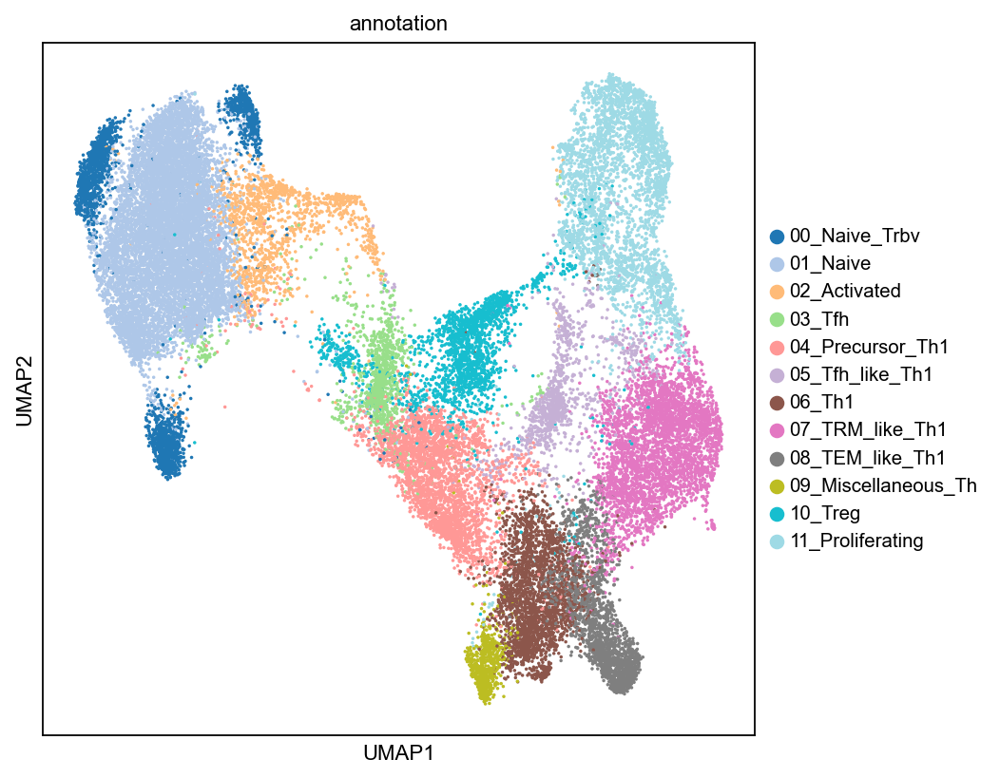

In [301]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=300, frameon=True, vector_friendly=True, 
                     fontsize=10, figsize=[6,6], color_map=None, format='pdf', 
                     facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.umap(adata, color = 'annotation', s = 10, palette = palette_dict_anno, ncols = 1) #save = '2a_1_UMAP.pdf'

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


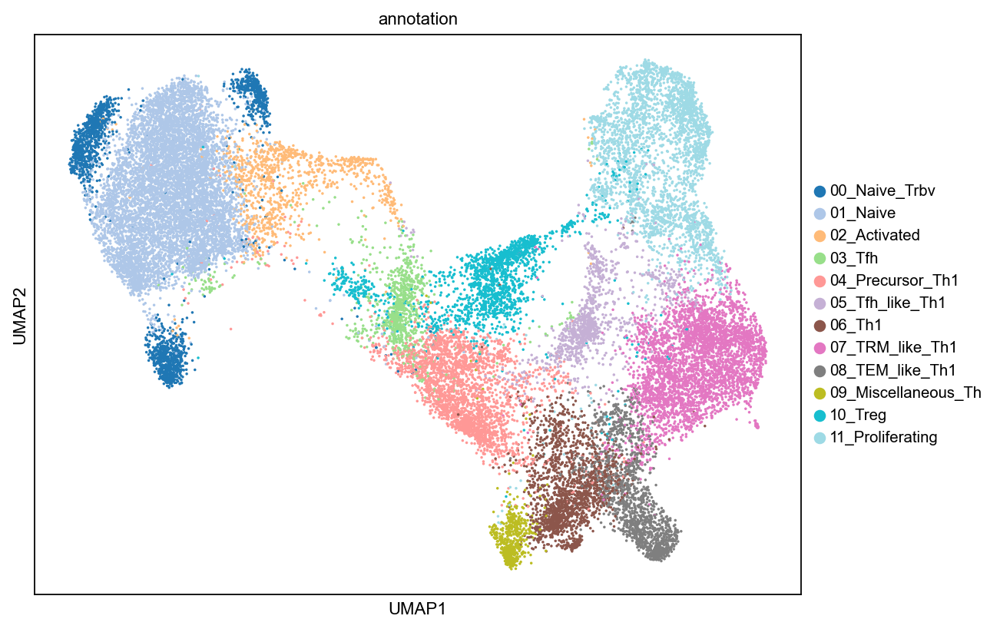

In [13]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=300, frameon=True, vector_friendly=True, 
                     fontsize=10, figsize=[8,6], color_map=None, format='pdf', 
                     facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.umap(adata_4groups, color = 'annotation', s = 10, palette = palette_dict_anno, ncols = 1, save = 'UMAP_4groups.pdf') #save = '2a_1_UMAP.pdf'

## Hash
show the distribution and count of each hash tag for each of the sample:
- LN: WT, RII, PD1, 2KO, 3KO
- LV: WT, RII_1 (very few), RII_2, PD1, 2KO, 3KO

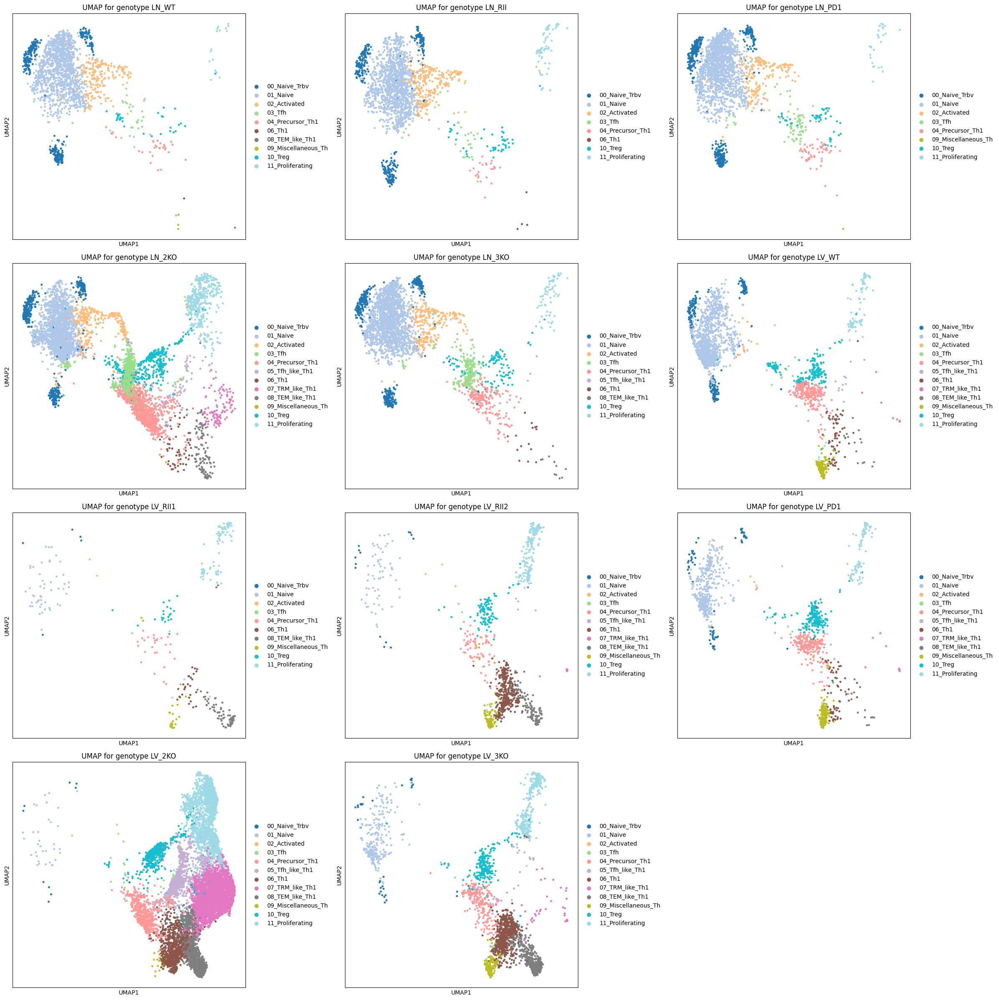

In [17]:
unique_sample = adata.obs['hash'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, hash in enumerate(unique_sample):
    adata_subset = adata[adata.obs['hash'] == hash]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='annotation', s=50, palette=palette_dict_anno,
               title=f'UMAP for genotype {hash}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_sample):
    for i in range(len(unique_sample), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

In [12]:
value_counts = adata.obs['hash'].value_counts()

LV_2KO     10232
LN_2KO      6004
LN_3KO      3165
LV_3KO      2534
LV_WT       2465
LN_PD1      2403
LN_RII      2011
LN_WT       1935
LV_PD1      1317
LV_RII2     1073
LV_RII1      327
Name: hash, dtype: int64

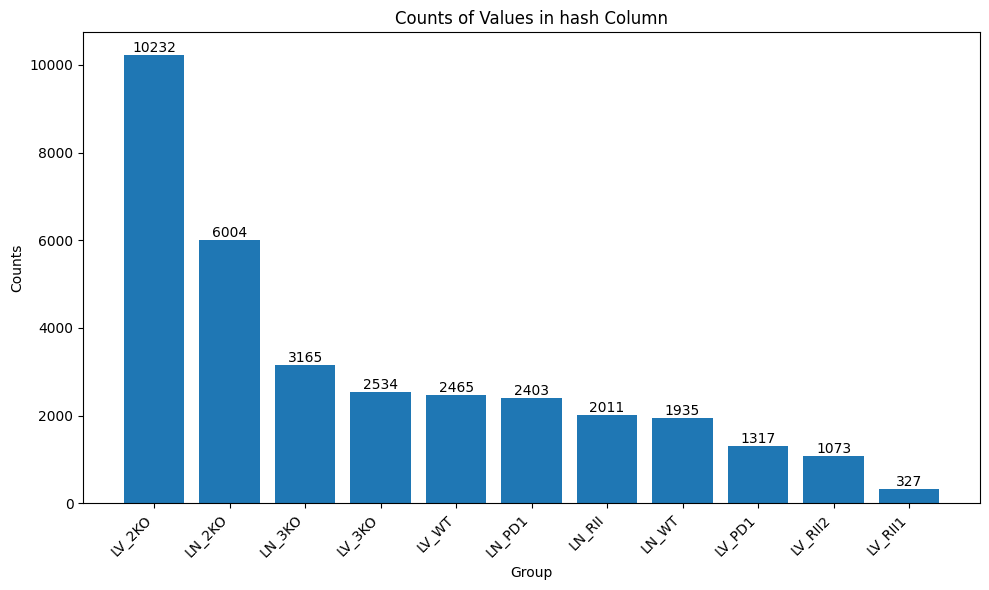

In [18]:
# Count occurrences of each unique value in the 'hash' column
value_counts = adata.obs['hash'].value_counts()

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(value_counts.index, value_counts.values)
plt.xlabel('Group')
plt.ylabel('Counts')
plt.xticks(rotation=45, ha="right")

# Add the text annotations on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.5, yval, ha='center', va='bottom')

plt.title('Counts of Values in hash Column')
plt.tight_layout()  # Adjust layout to not cut off labels
plt.show()


## Sample
show the distribution and count of each hash tag for each of the sample:
- LN: WT, RII, PD1, 2KO, 3KO
- LV: WT, RII (RII_1 (very few) + RII_2), PD1, 2KO, 3KO

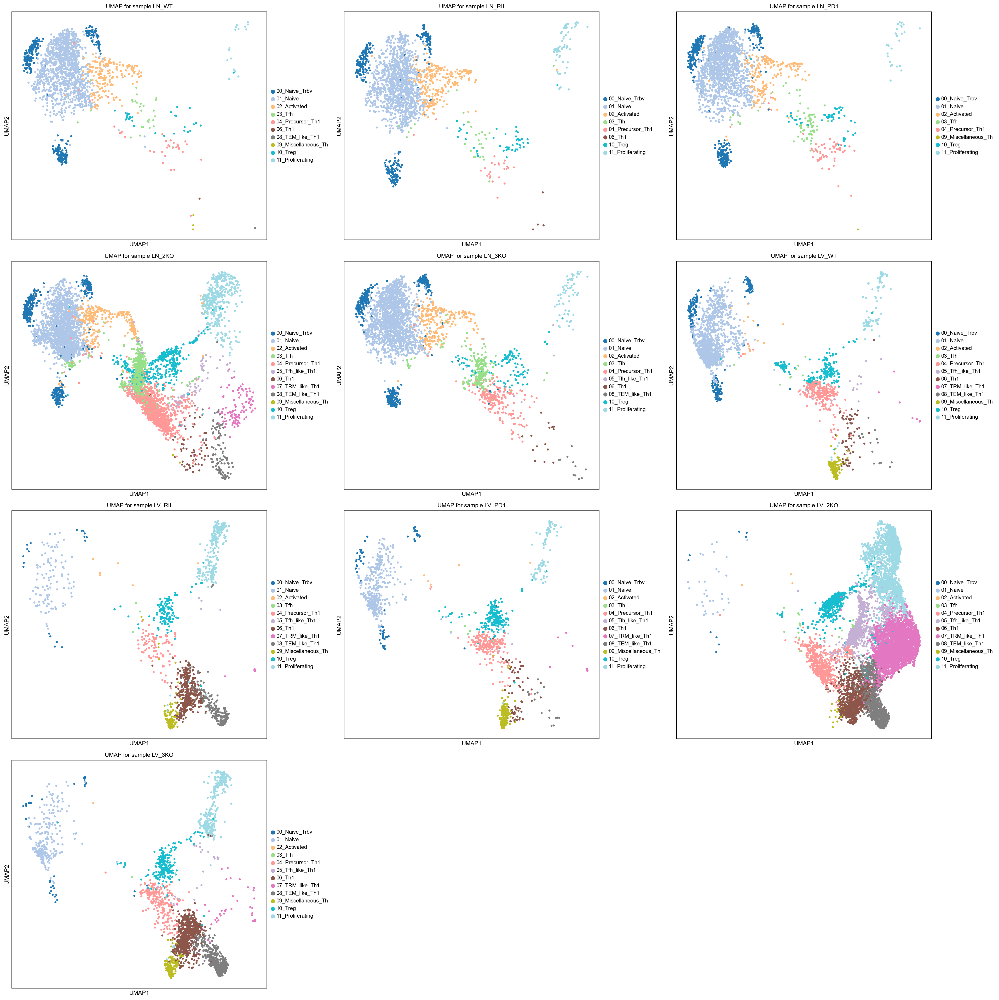

In [33]:
unique_sample = adata.obs['sample'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, sample in enumerate(unique_sample):
    adata_subset = adata[adata.obs['sample'] == sample]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='annotation', s=50, palette=palette_dict_anno,
               title=f'UMAP for sample {sample}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_sample):
    for i in range(len(unique_sample), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

In [ ]:
fig.savefig('grant_figure/2b_1_UMAP_sample_by_annotation14_cluster.pdf', format='pdf', dpi=300)
fig.savefig('UMAP_sample_by_annotation14_cluster.png', dpi = 150, bbox_inches = 'tight')

In [36]:
value_counts = adata.obs['sample'].value_counts()
value_counts

LV_2KO    10232
LN_2KO     6004
LN_3KO     3165
LV_3KO     2534
LV_WT      2465
LN_PD1     2403
LN_RII     2011
LN_WT      1935
LV_RII     1400
LV_PD1     1317
Name: sample, dtype: int64

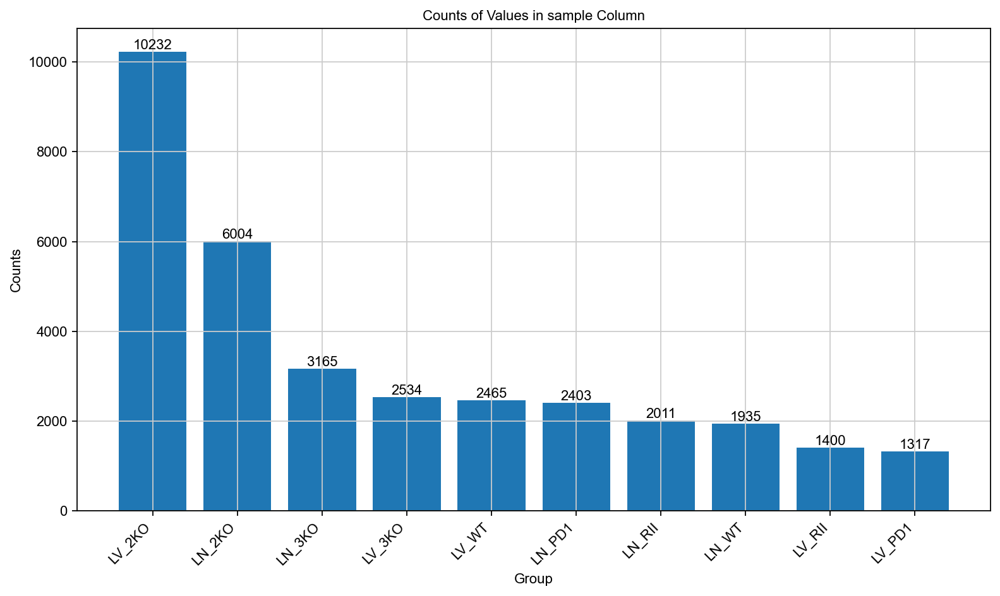

In [37]:
# Count occurrences of each unique value in the 'hash' column
value_counts = adata.obs['sample'].value_counts()

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(value_counts.index, value_counts.values)
plt.xlabel('Group')
plt.ylabel('Counts')
plt.xticks(rotation=45, ha="right")

# Add the text annotations on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.5, yval, ha='center', va='bottom')

plt.title('Counts of Values in sample Column')
plt.tight_layout()  # Adjust layout to not cut off labels
plt.show()

## Genotype

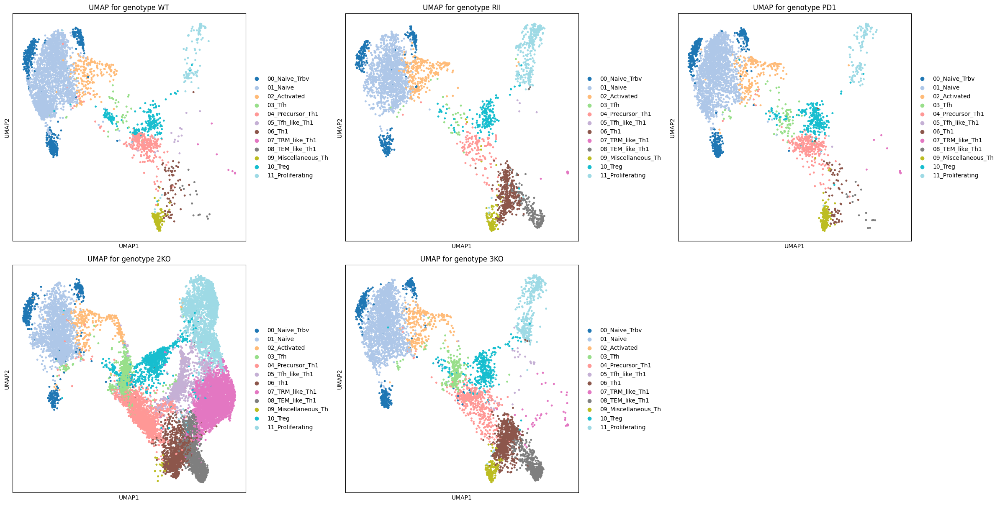

In [20]:
unique_sample = adata.obs['genotype'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, hash in enumerate(unique_sample):
    adata_subset = adata[adata.obs['genotype'] == hash]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='annotation', s=50, palette=palette_dict_anno,
               title=f'UMAP for genotype {hash}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_sample):
    for i in range(len(unique_sample), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

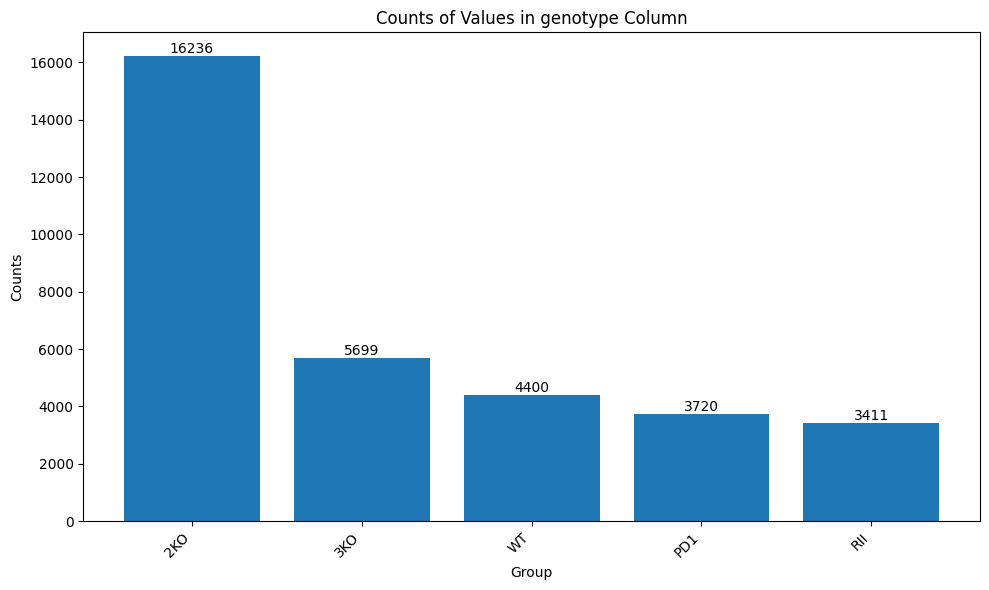

In [26]:
# Count occurrences of each unique value in the 'hash' column
value_counts = adata.obs['genotype'].value_counts()

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(value_counts.index, value_counts.values)
plt.xlabel('Group')
plt.ylabel('Counts')
plt.xticks(rotation=45, ha="right")

# Add the text annotations on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.5, yval, ha='center', va='bottom')

plt.title('Counts of Values in genotype Column')
plt.tight_layout()  # Adjust layout to not cut off labels
plt.show()


#### proportion by annotation

In [30]:
grouped = adata.obs.groupby(['sample', 'annotation']).size().reset_index(name='counts')
grouped = pd.merge(grouped, adata.obs[['annotation']].drop_duplicates(), on='annotation', how='left')
# Write the DataFrame to a CSV file
grouped.to_csv('counts_genotype_annotation.csv', index=False)
grouped

,sample,annotation,counts
0,LN_2KO,00_Naive_Trbv,543
1,LN_2KO,01_Naive,1946
2,LN_2KO,02_Activated,320
3,LN_2KO,03_Tfh,730
4,LN_2KO,04_Precursor_Th1,1265
...,...,...,...
115,LV_WT,07_TRM_like_Th1,10
116,LV_WT,08_TEM_like_Th1,14
117,LV_WT,09_Miscellaneous_Th,191
118,LV_WT,10_Treg,215


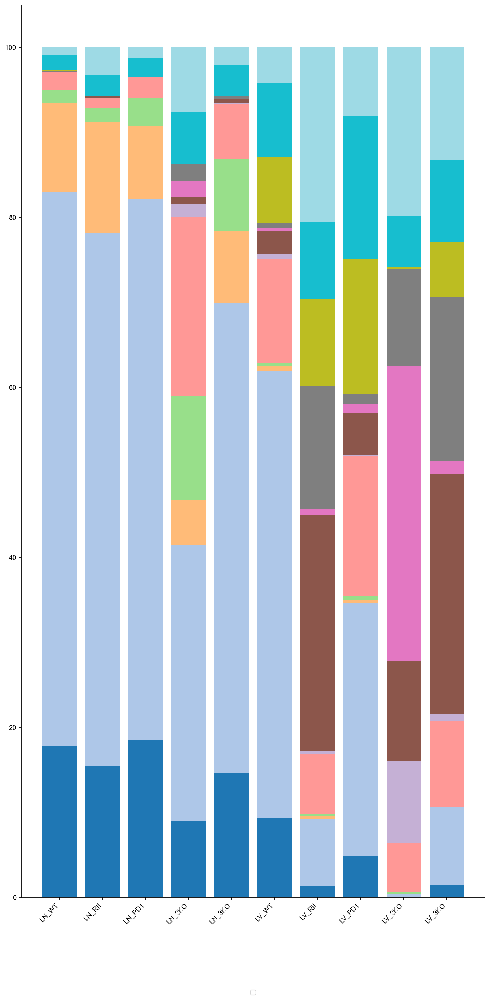

In [32]:
#unique_samples = grouped['sample'].unique()
unique_samples = ['LN_WT', 'LN_RII', 'LN_PD1','LN_2KO', 'LN_3KO', 'LV_WT', 'LV_RII',  'LV_PD1', 'LV_2KO', 'LV_3KO']

fig, ax = plt.subplots(figsize=(10, len(unique_samples)*2))
plot_data = []  # List to collect data used for plotting

# Prepare an Excel writer
with pd.ExcelWriter('counts_genotype_annotation_percent.xlsx') as writer:
    for i, sample in enumerate(unique_samples):
        sample_data = grouped[grouped['sample'] == sample].copy()
        sample_data['percentage'] = sample_data['counts'] / sample_data['counts'].sum() * 100
        sample_data = sample_data.sort_values(by=['sample', 'annotation'])
        
        # Write sample data to a separate sheet in the Excel file
        sample_data.to_excel(writer, sheet_name=sample, index=False)

        bottom_value = 0
        
        for _, row in sample_data.iterrows():
            # Get the color from the color map using the annotation
            color = palette_dict_anno.get(row['annotation'], 'grey')  # Set to grey if annotation is not in the color map
            
            ax.bar(
                i,  # x-coordinate for the bar (using index)
                row['percentage'],  # height of the bar
                bottom=bottom_value,  # starting point of the bar
                color=color,  # color of the bar
            )
            bottom_value += row['percentage']  # update the bottom_value for the next bar

# Label the x-axis with the sample names
ax.set_xticks(range(len(unique_samples)))
ax.set_xticklabels(unique_samples, rotation=45, ha="right")

# Add a unique legend
handles, labels = ax.get_legend_handles_labels()
unique_labels = dict(zip(labels, handles))  # Removes duplicate labels in legend
ax.legend(unique_labels.values(), unique_labels.keys(), loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=2)
ax.grid(False)
# Display the plot
plt.tight_layout()
plt.show()

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_13137/1471386836.py:38: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


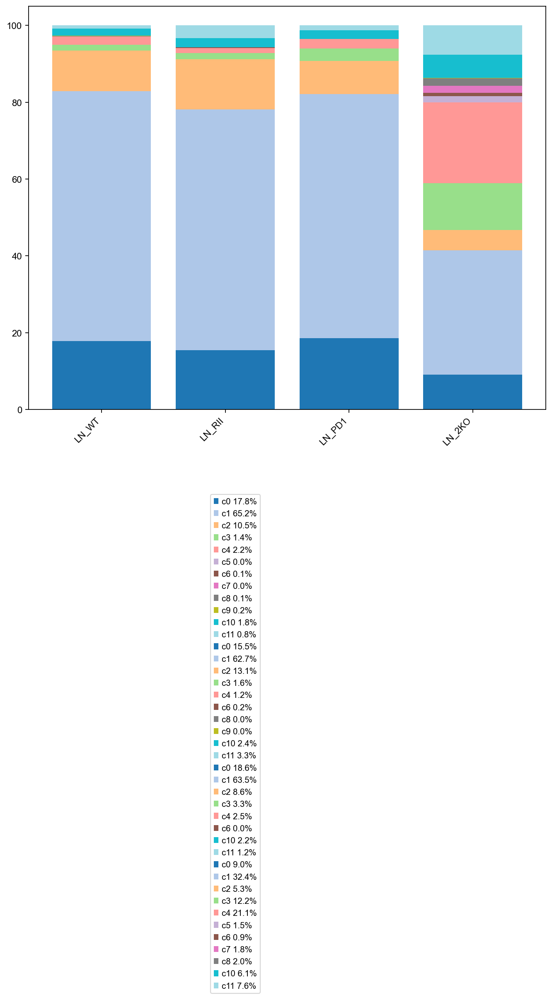

In [ ]:
# Find the unique samples
#unique_samples = grouped['sample'].unique()
unique_samples = ['LN_WT', 'LN_RII', 'LN_PD1','LN_2KO']

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, len(unique_samples)*2))

# Loop through each unique sample and plot a stacked bar
for i, sample in enumerate(unique_samples):
    sample_data = grouped[grouped['sample'] == sample].copy()
    sample_data['percentage'] = sample_data['counts'] / sample_data['counts'].sum() * 100
    sample_data = sample_data.sort_values(by=['sample', 'annotation'])
    bottom_value = 0  # Initialize the bottom value to start stacking bars
    
    for _, row in sample_data.iterrows():
        # Get the color from the color map using the annotation
        color = palette_dict.get(row['annotation'], 'grey')  # Set to grey if annotation is not in the color map
        
        ax.bar(
            i,  # x-coordinate for the bar (using index)
            row['percentage'],  # height of the bar
            bottom=bottom_value,  # starting point of the bar
            color=color,  # color of the bar
            label=f"{row['annotation_1.4_short']} {row['percentage']:.1f}%"
        )
        bottom_value += row['percentage']  # update the bottom_value for the next bar

# Label the x-axis with the sample names
ax.set_xticks(range(len(unique_samples)))
ax.set_xticklabels(unique_samples, rotation=45, ha="right")

# Add a unique legend
handles, labels = ax.get_legend_handles_labels()
unique_labels = dict(zip(labels, handles))  # Removes duplicate labels in legend
ax.legend(unique_labels.values(), unique_labels.keys(), loc='upper center', bbox_to_anchor=(0.4, -0.2), ncol=1)
ax.grid(False)
# Display the plot
plt.tight_layout()
plt.show()
fig.savefig('grant_figure/2b_2_LN_bar.pdf', format='pdf', dpi=300)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_13137/1450564481.py:38: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


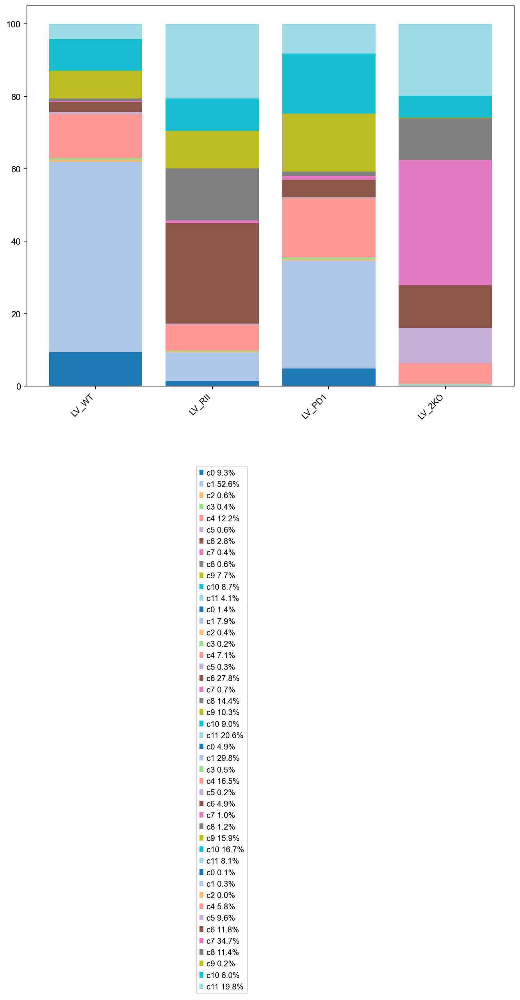

In [ ]:
# Find the unique samples
#unique_samples = grouped['sample'].unique()
unique_samples = ['LV_WT', 'LV_RII',  'LV_PD1', 'LV_2KO']

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, len(unique_samples)*2))

# Loop through each unique sample and plot a stacked bar
for i, sample in enumerate(unique_samples):
    sample_data = grouped[grouped['sample'] == sample].copy()
    sample_data['percentage'] = sample_data['counts'] / sample_data['counts'].sum() * 100
    sample_data = sample_data.sort_values(by=['sample', 'annotation'])
    bottom_value = 0  # Initialize the bottom value to start stacking bars
    
    for _, row in sample_data.iterrows():
        # Get the color from the color map using the annotation
        color = palette_dict.get(row['annotation'], 'grey')  # Set to grey if annotation is not in the color map
        
        ax.bar(
            i,  # x-coordinate for the bar (using index)
            row['percentage'],  # height of the bar
            bottom=bottom_value,  # starting point of the bar
            color=color,  # color of the bar
            label=f"{row['annotation_1.4_short']} {row['percentage']:.1f}%"
        )
        bottom_value += row['percentage']  # update the bottom_value for the next bar

# Label the x-axis with the sample names
ax.set_xticks(range(len(unique_samples)))
ax.set_xticklabels(unique_samples, rotation=45, ha="right")

# Add a unique legend
handles, labels = ax.get_legend_handles_labels()
unique_labels = dict(zip(labels, handles))  # Removes duplicate labels in legend
ax.legend(unique_labels.values(), unique_labels.keys(), loc='upper center', bbox_to_anchor=(0.4, -0.2), ncol=1)
ax.grid(False)
# Display the plot
plt.tight_layout()
plt.show()
fig.savefig('grant_figure/2a_3_LV_bar.pdf', format='pdf', dpi=300)

/var/folders/8g/fl2p12vx3y339stf1qwv7p7x1xtc_r/T/ipykernel_13137/150493001.py:38: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


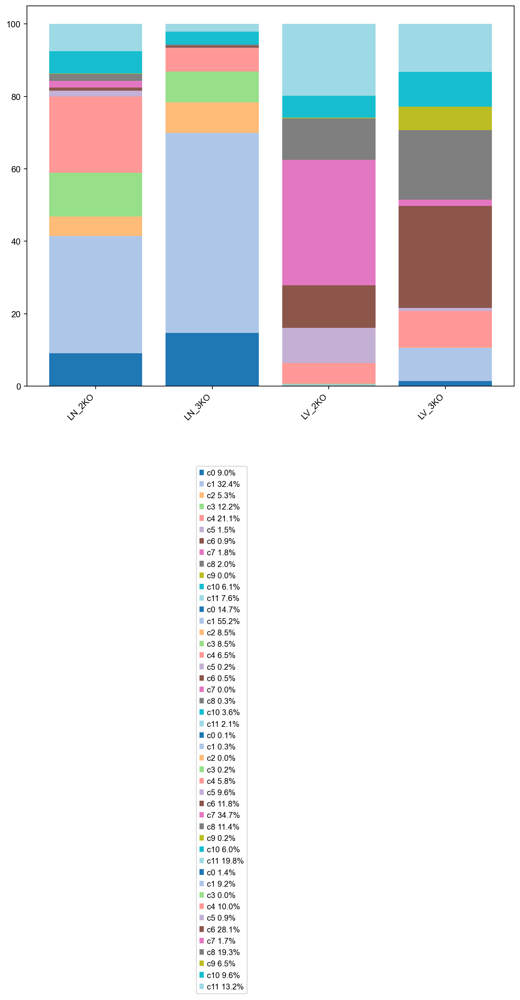

In [ ]:
# Find the unique samples
#unique_samples = grouped['sample'].unique()
unique_samples = ['LN_2KO', 'LN_3KO',  'LV_2KO', 'LV_3KO']

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, len(unique_samples)*2))

# Loop through each unique sample and plot a stacked bar
for i, sample in enumerate(unique_samples):
    sample_data = grouped[grouped['sample'] == sample].copy()
    sample_data['percentage'] = sample_data['counts'] / sample_data['counts'].sum() * 100
    sample_data = sample_data.sort_values(by=['sample', 'annotation'])
    bottom_value = 0  # Initialize the bottom value to start stacking bars
    
    for _, row in sample_data.iterrows():
        # Get the color from the color map using the annotation
        color = palette_dict.get(row['annotation'], 'grey')  # Set to grey if annotation is not in the color map
        
        ax.bar(
            i,  # x-coordinate for the bar (using index)
            row['percentage'],  # height of the bar
            bottom=bottom_value,  # starting point of the bar
            color=color,  # color of the bar
            label=f"{row['annotation_1.4_short']} {row['percentage']:.1f}%"
        )
        bottom_value += row['percentage']  # update the bottom_value for the next bar

# Label the x-axis with the sample names
ax.set_xticks(range(len(unique_samples)))
ax.set_xticklabels(unique_samples, rotation=45, ha="right")

# Add a unique legend
handles, labels = ax.get_legend_handles_labels()
unique_labels = dict(zip(labels, handles))  # Removes duplicate labels in legend
ax.legend(unique_labels.values(), unique_labels.keys(), loc='upper center', bbox_to_anchor=(0.4, -0.2), ncol=1)
ax.grid(False)
# Display the plot
plt.tight_layout()
plt.show()
fig.savefig('grant_figure/2e_3KO_bar.pdf', format='pdf', dpi=300)

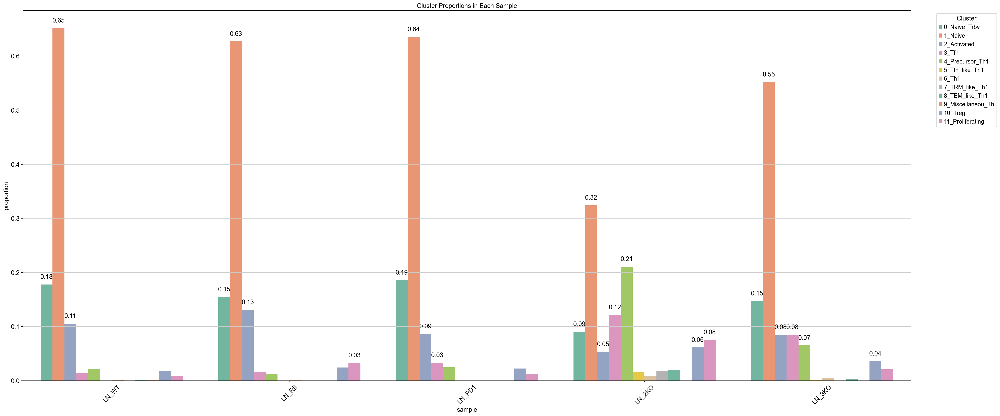

In [ ]:
grouped = adata.obs.groupby(['sample', 'annotation']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='sample', y='proportion', hue='annotation', 
            data=grouped, palette='Set2', width = 0.8, order=sample_order)

# Title and Legend
plt.title('Cluster Proportions in Each Sample')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Cluster')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()


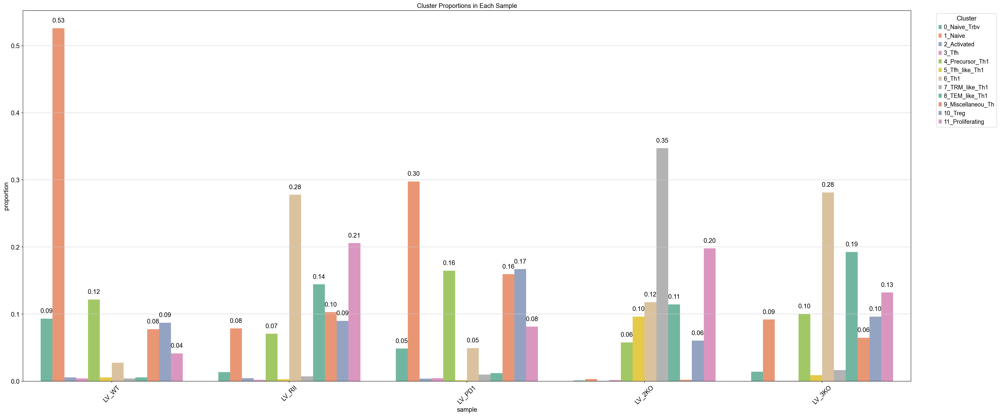

In [ ]:
grouped = adata.obs.groupby(['sample', 'annotation']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LV_WT', 'LV_RII', 'LV_PD1', 'LV_2KO', 'LV_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='sample', y='proportion', hue='annotation', 
            data=grouped, palette='Set2', width = 0.8, order=sample_order)

# Title and Legend
plt.title('Cluster Proportions in Each Sample')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Cluster')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()


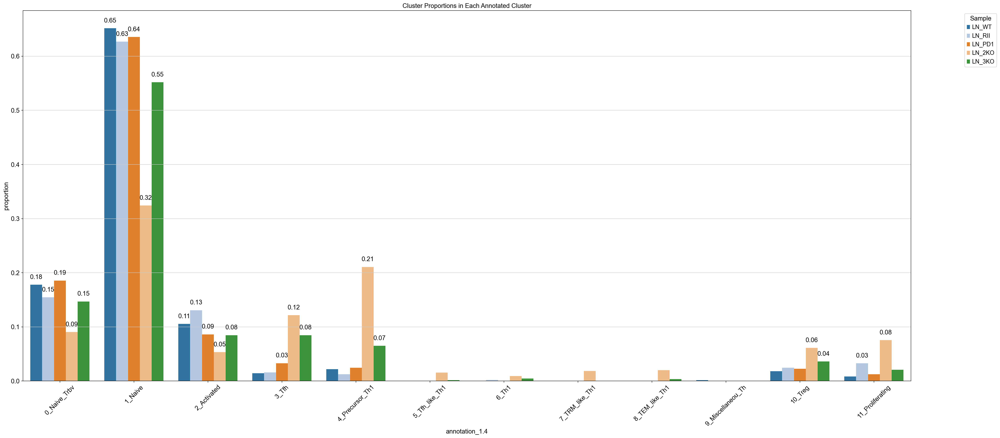

In [ ]:
# Assuming adata.obs['sample'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'annotation_1.4']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LN_WT', 'LN_RII', 'LN_PD1', 'LN_2KO', 'LN_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='annotation_1.4', y='proportion', hue='sample', 
            data=grouped, palette='tab20', width=0.8,
            hue_order=sample_order)  # You can keep hue_order if you want to control the order of the hue

# Title and Legend
plt.title('Cluster Proportions in Each Annotated Cluster')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Sample')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()


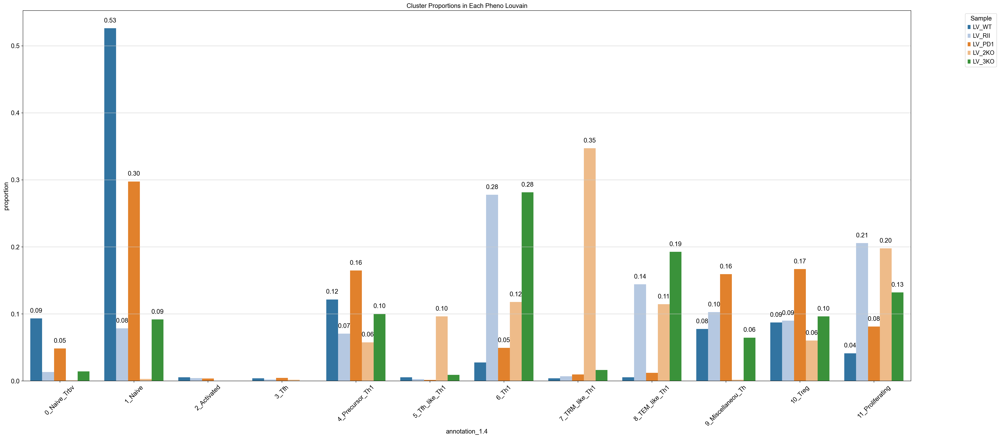

In [ ]:
# Assuming adata.obs['sample'] contains sample IDs and adata.obs['cluster'] contains cluster labels
grouped = adata.obs.groupby(['sample', 'annotation_1.4']).size().reset_index(name='counts')

# Calculate the total count for each sample
total_count = grouped.groupby('sample')['counts'].sum().reset_index()
total_count = total_count.rename(columns={'counts': 'total_count'})

# Merge this total count back to the original dataframe
grouped = pd.merge(grouped, total_count, on='sample', how='left')

# Calculate the proportion for each cluster in each sample
grouped['proportion'] = grouped['counts'] / grouped['total_count']

# Define the order in which you want the samples to appear
sample_order = ['LV_WT', 'LV_RII', 'LV_PD1', 'LV_2KO', 'LV_3KO']

# Create the plot with an extended x-axis
plt.figure(figsize=(35, 15)) 
# Now, plot these proportions
bar_plot = sns.barplot(x='annotation_1.4', y='proportion', hue='sample', 
            data=grouped, palette='tab20', width=0.8,
            hue_order=sample_order)  # You can keep hue_order if you want to control the order of the hue

# Title and Legend
plt.title('Cluster Proportions in Each Pheno Louvain')
plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1), title='Sample')

# Annotate the bars at the bottom
for p in bar_plot.patches:
    height = p.get_height()
    if height > 0.03:  # Adjust the threshold as needed
        bar_plot.annotate(f"{height:.2f}", 
                          (p.get_x() + p.get_width() / 2., height),
                          ha='center', va='bottom',
                          xytext=(0, 10),  
                          textcoords='offset points')

# Rotate x-axis labels if necessary
plt.xticks(rotation=45)

plt.show()


## Organ
lymph node and liver

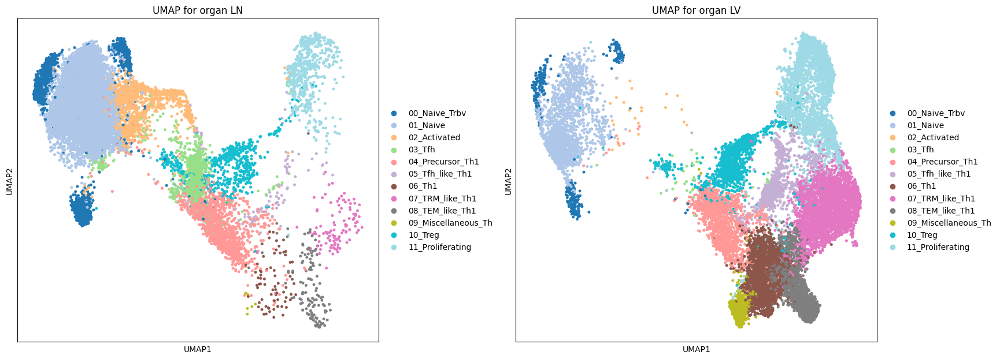

In [21]:
unique_sample = adata.obs['organ'].unique()

nrows = 4
ncols = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(8*ncols, 6*nrows))
axs = axs.flatten()  # Flatten to easily iterate over

for i, hash in enumerate(unique_sample):
    adata_subset = adata[adata.obs['organ'] == hash]
    
    # Plot in the correct subplot with consistent color palette and order
    sc.pl.umap(adata_subset, color='annotation', s=50, palette=palette_dict_anno,
               title=f'UMAP for organ {hash}', ax=axs[i], show=False)

# Remove unused subplots
if len(axs) > len(unique_sample):
    for i in range(len(unique_sample), len(axs)):
        fig.delaxes(axs[i])

plt.tight_layout()
plt.show()

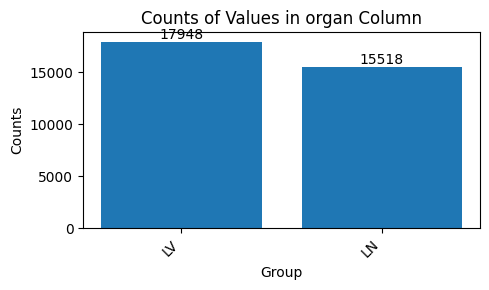

In [25]:
value_counts = adata.obs['organ'].value_counts()
# Create a bar plot
plt.figure(figsize=(5, 3))
bars = plt.bar(value_counts.index, value_counts.values)
plt.xlabel('Group')
plt.ylabel('Counts')
plt.xticks(rotation=45, ha="right")

# Add the text annotations on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.5, yval, ha='center', va='bottom')

plt.title('Counts of Values in organ Column')
plt.tight_layout()  # Adjust layout to not cut off labels
plt.show()


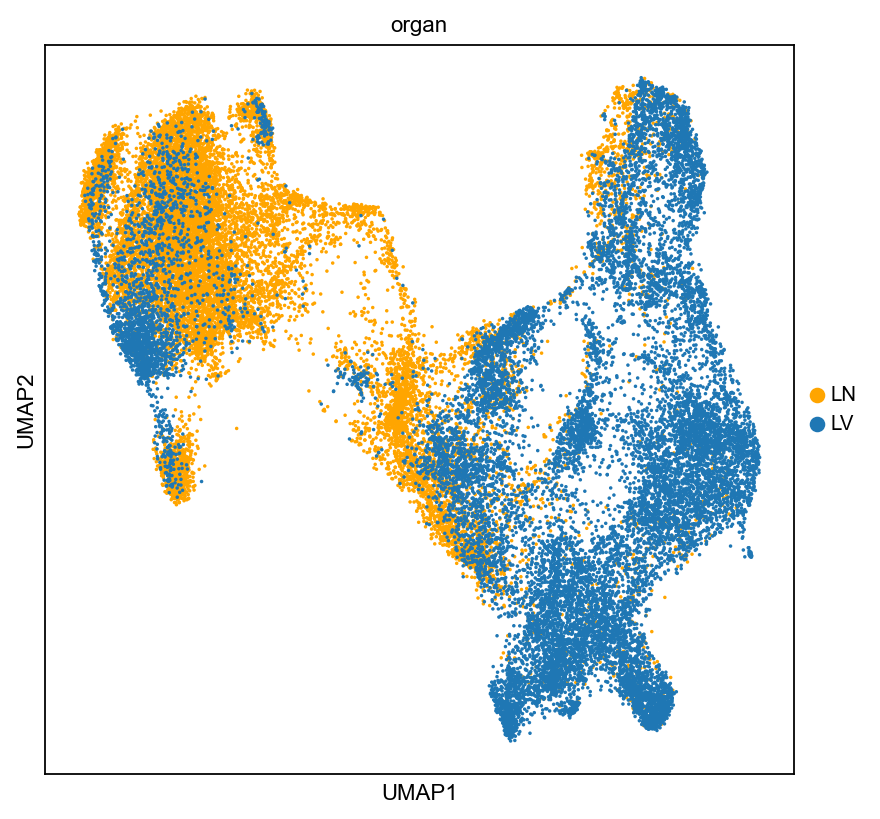

In [14]:
# Define the keys
keys = ['LN', 'LV']
# Define the hex colors
hex_colors = ['#FFA500', '#1F77B4']

# Create the color palette dictionary
palette_dict_organ = dict(zip(keys, hex_colors))

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=300, frameon=True, vector_friendly=True, 
                     fontsize=10, figsize=[6,6], color_map=None, format='pdf', 
                     facecolor=None, transparent=False, ipython_format='png2x')
sc.pl.umap(adata, color = 'organ', s = 10, palette = palette_dict_organ, ncols = 1, save = 'figures/UMAP_organ') #save = '2a_1_UMAP.pdf'

In [ ]:
adata_LN

View of AnnData object with n_obs × n_vars = 15518 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'indices', 'genotype_milo'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'ph

In [ ]:
adata_LV

View of AnnData object with n_obs × n_vars = 17948 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'indices', 'genotype_milo'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'ph

# GOI
genes of interest

## UMAPs

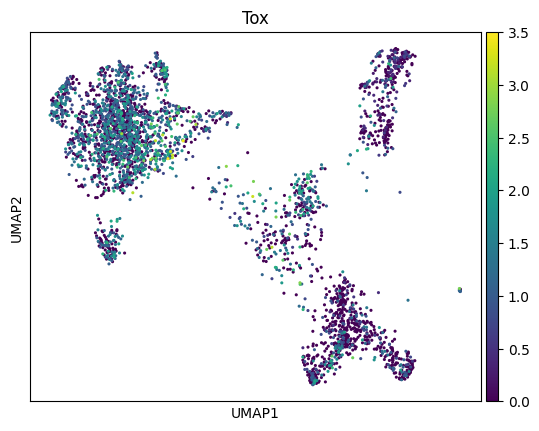

In [65]:
sc.pl.umap(adata[adata.obs['genotype']== 'RII'], color = 'Tox', s = 20)

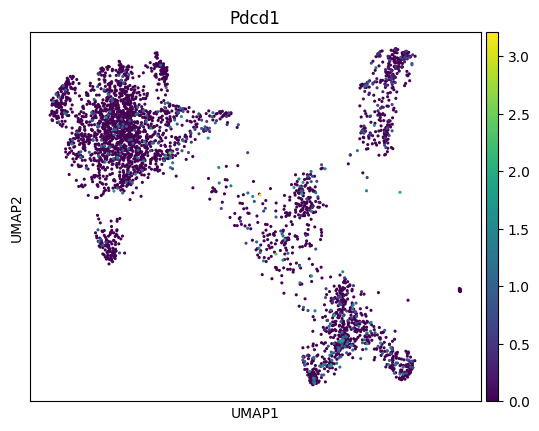

In [67]:
sc.pl.umap(adata[adata.obs['genotype']== 'RII'], color = 'Pdcd1', s = 20)

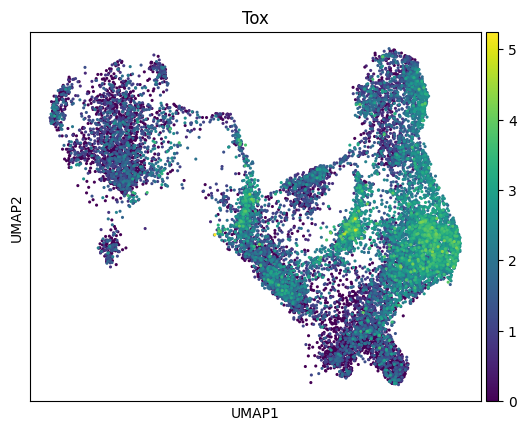

In [66]:
sc.pl.umap(adata[adata.obs['genotype']== '2KO'], color = 'Tox', s = 20)

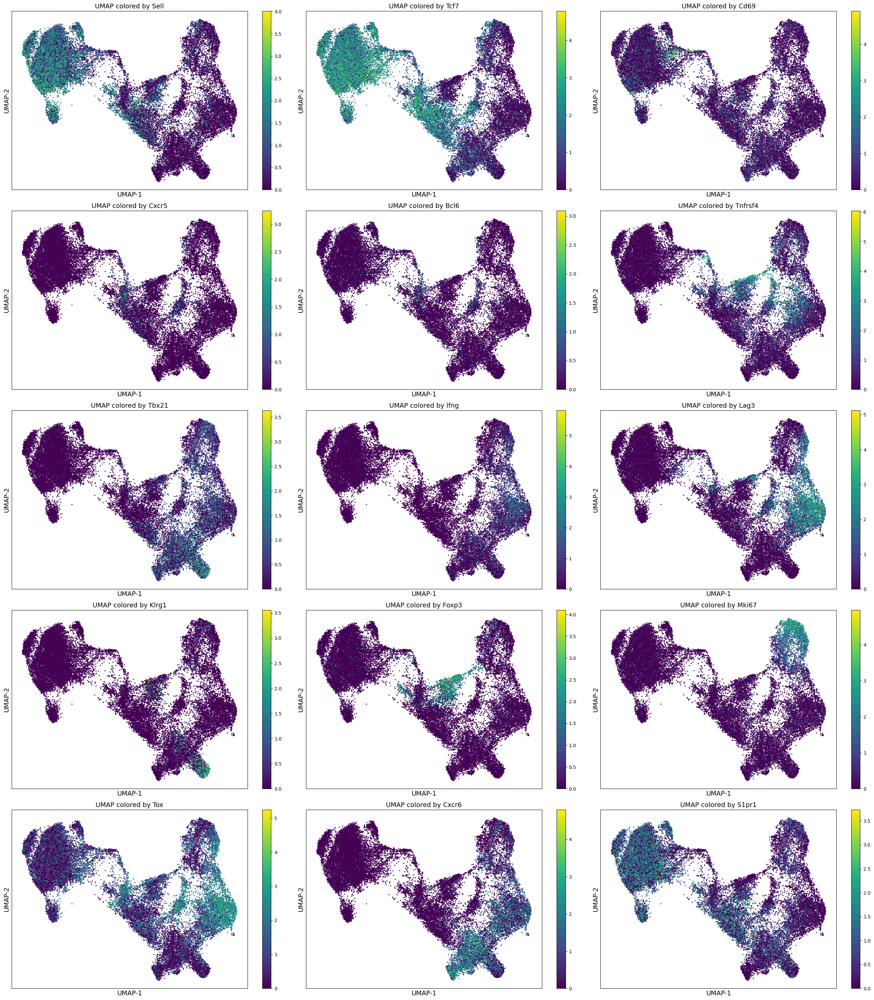

In [12]:
genes = ['Sell', 'Tcf7', 'Cd69', 'Cxcr5','Bcl6','Tnfrsf4', 'Tbx21', 'Ifng','Lag3', 'Klrg1', 'Foxp3', 'Mki67', 'Tox', 'Cxcr6', 'S1pr1']

fig_nrow = 5
fig_ncol = 3

fig = plt.figure(figsize = (9*fig_ncol, 6*fig_nrow))
count = 0
for gene_name in genes:
    ax = fig.add_subplot(fig_nrow, fig_ncol, count + 1)
    col_gene = adata.X[:, adata.var_names.get_loc(gene_name)]
    im1 = ax.scatter(adata.obsm['X_umap'][:, 0], adata.obsm['X_umap'][:, 1], s = 2, c = col_gene, 
                    cmap = 'viridis')
    ax.set_xlabel('UMAP-1', fontsize = 14)
    ax.set_ylabel('UMAP-2', fontsize = 14)
    ax.set_title('UMAP colored by ' + gene_name, fontsize = 14)
    ax.set_xticks([])
    ax.set_yticks([])
    fig.colorbar(im1)
    count = count + 1
plt.tight_layout()

## Violin plot

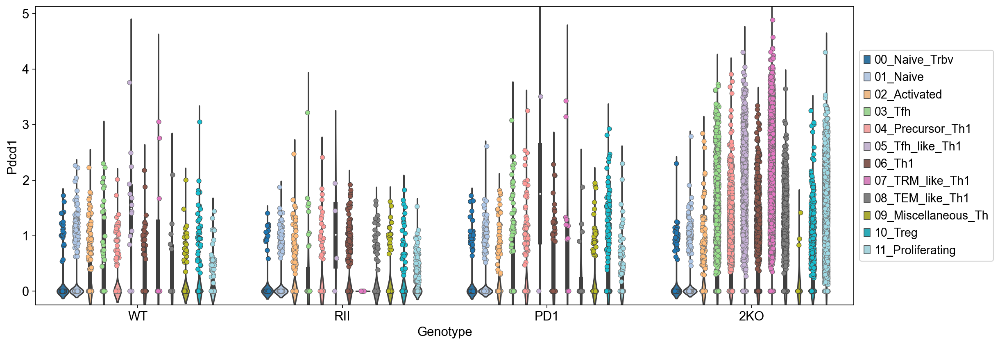

In [ ]:
# cell_subtype_v1
query = 'Pdcd1'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata.obs['annotation'], 
                        'Genotype': adata.obs['genotype'], 
                        query: adata.X[:, adata.var_names.get_loc(query)]}, index = adata.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_anno, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_anno, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#fig.savefig('grant_figure/6b_2_Pdcd1_v2.pdf', format='pdf', dpi=300)

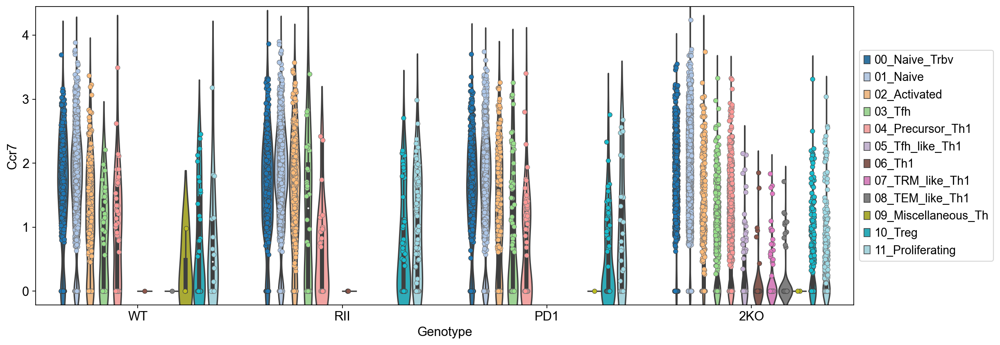

In [ ]:
query = 'Ccr7'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata_LN.obs['annotation'], 
                        'Genotype': adata_LN.obs['genotype'], 
                        query: adata_LN.X[:, adata_LN.var_names.get_loc(query)]}, index = adata_LN.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_anno, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_anno, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))


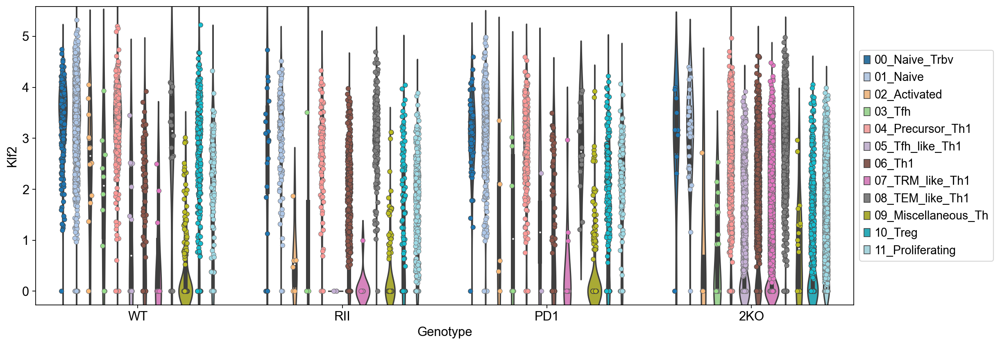

In [ ]:
query = 'Klf2'
# check whether they express 
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'Cluster': adata_LV.obs['annotation'], 
                        'Genotype': adata_LV.obs['genotype'], 
                        query: adata_LV.X[:, adata_LV.var_names.get_loc(query)]}, index = adata_LV.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO']

fig = plt.figure(figsize = (8*2, 6))
ax = fig.add_subplot(1, 1, 1)
sns.violinplot(x = "Genotype", y = query,  hue='Cluster', data = df_temp, ax = ax, 
            palette = palette_dict_anno, order = sample_order)
ax.get_legend().remove()
# Adding swarmplot on top of the boxplot
sns.stripplot(x="Genotype", y=query, hue='Cluster', data=df_temp, ax=ax, 
              palette=palette_dict_anno, order=sample_order, dodge=True, size=5, edgecolor="gray", linewidth=0.5, legend = False)
ax.grid(False)
# Adjust the position of the legend
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

## Bar graph

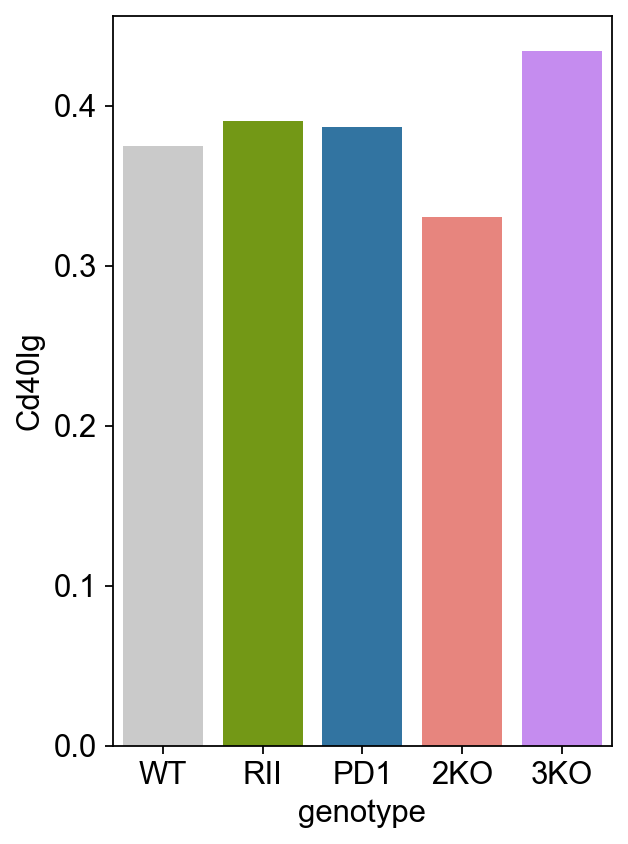

In [13]:
# check whether they express Cd40lg
sc.set_figure_params(scanpy=True, fontsize = 14)
df_temp = pd.DataFrame({'pheno_louvain': adata.obs['pheno_louvain'], 
                        'genotype': adata.obs['genotype'], 
                        'Cd40lg': adata.X[:, adata.var_names.get_loc('Cd40lg')]}, index = adata.obs.index)
sample_order = ['WT', 'RII', 'PD1', '2KO', '3KO']
fig = plt.figure(figsize = (4, 6))
ax = fig.add_subplot(1, 1, 1)
sns.barplot(x = "genotype", y = "Cd40lg",  data = df_temp, ax = ax, 
            palette = palette_dict_geno,  errorbar = None, order = sample_order)
ax.grid(False)

## Dotplot

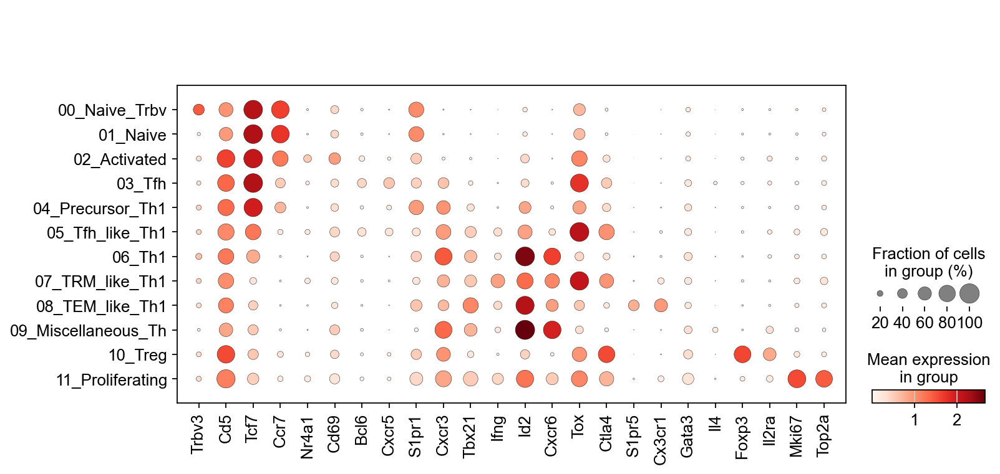

In [14]:
to_save = 'figures/dotplot_R01_resubmission.pdf'
markers = ['Trbv3',
           'Tcf7', 'Ccr7', 'Sell',
           'Nr4a1', 'Cd69', 
           'Bcl6', 'Cxcr5',
           'S1pr1', 'Cxcr3',
           'Tbx21', 'Ifng',
           'Id2', 'Cxcr6',
           'Tox', 'Ctla4',
           'S1pr5','Cx3cr1',
           'Gata3', 'Il4',
           'Foxp3', 'Il2ra',
           'Mki67', 'Top2a']
sc.pl.dotplot(adata, markers, groupby='annotation', save = to_save)

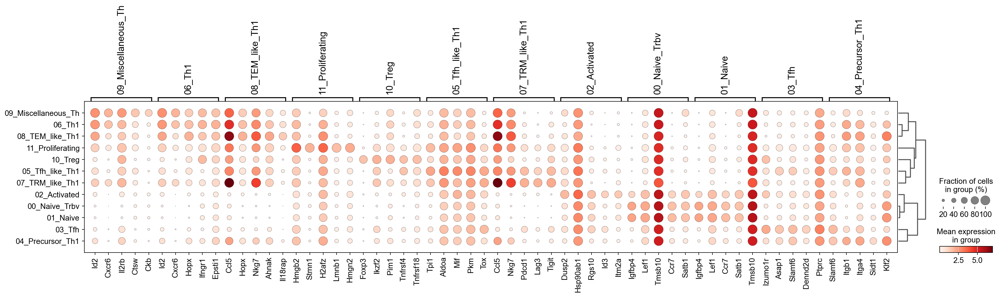

In [15]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, key="wilcoxon_anno")

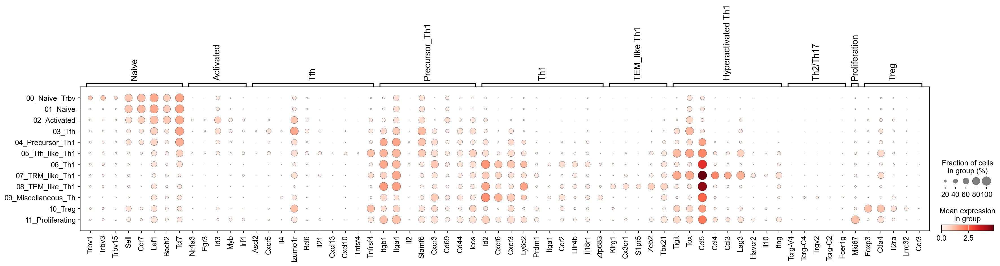

In [28]:
goi = {'Naive': ['Trbv1', 'Trbv3', 'Trbv15', 'Sell', 'Ccr7', 'Lef1', 'Bach2', 'Tcf7'],
                'Activated':['Nr4a3', 'Egr3', 'Id3', 'Myb', 'Irf4'],
                'Tfh':['Ascl2','Cxcr5', 'Il4', 'Izumo1r','Bcl6', 'Il21','Cxcl13','Cxcl10','Tnfsf4','Tnfrsf4'],
                'Precursor_Th1': ['Itgb1', 'Itga4', 'Il2', 'Slamf6', 'Cxcr3', 'Cd69', 'Cd44', 'Icos'],
                'Th1': ['Id2', 'Cxcr6', 'Cxcr3', 'Ly6c2','Prdm1', 'Itga1', 'Ccr2', 'Lilr4b', 'Il18r1','Zfp683'],
                'TEM_like Th1':['Klrg1', 'Cx3cr1', 'S1pr5', 'Zeb2', 'Tbx21',],
                'Hyperactivated Th1':['Tigit', 'Tox',
                                      'Ccl5', 'Ccl4', 'Ccl3', 'Lag3', 'Havcr2', 'Il10','Ifng', ],
                'Th2/Th17': ['Tcrg-V4', 'Tcrg-C4', 'Trgv2', 'Tcrg-C2', 'Fcer1g'],
                'Proliferation': ['Mki67'],
                'Treg':['Foxp3', 'Ctla4','Il2ra','Lrrc32', 'Ccr3'],
               }
ac = sc.pl.dotplot(adata, goi, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = False)

/Users/gaos1/anaconda3/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


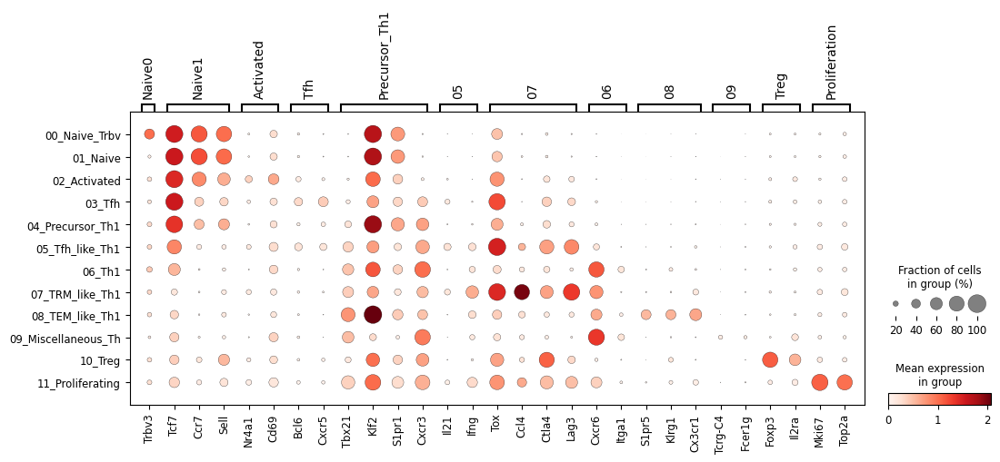

In [9]:
goi2 = {'Naive0': ['Trbv3'],
                 'Naive1':  ['Tcf7', 'Ccr7', 'Sell'],
                'Activated':['Nr4a1', 'Cd69'],
                'Tfh':['Bcl6','Cxcr5'],
                'Precursor_Th1': ['Tbx21','Klf2','S1pr1', 'Cxcr3'],
                '05':['Il21','Ifng'],
                '07':['Tox','Ccl4', 'Ctla4', 'Lag3'],
                '06': ['Cxcr6','Itga1'],
                
                '08':['S1pr5', 'Klrg1', 'Cx3cr1' ],
                '09': ['Tcrg-C4','Fcer1g'],
                'Treg':['Foxp3','Il2ra'],
                'Proliferation': ['Mki67', "Top2a"],
               }
ac = sc.pl.dotplot(adata, goi2, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, save ='dotplot_0504')

### dotplot across GT by cluster

#### LV

In [18]:
goi3 = {'Naive0': ['Trbv3', 'Cd5'],
                 'Naive1':  ['Tcf7', 'Ccr7', 'Sell'],
                'Activated':['Id3', 'Cd69'],
                'Tfh':['Bcl6','Cxcr5'],
                'Precursor_Th1': ['Tbx21','Klf2','S1pr1'],
                '05':['Il21','Ifng'],
                '06': ['Cxcr6','Itga1'],
                '07':['Tox','Ccl4'],
                '08':['S1pr5', 'Klrg1' ],
                '09': ['Tcrg-C4','Fcer1g'],
                'Treg':['Foxp3','Il2ra'],
                'Proliferation': ['Mki67', "Top2a"],
                'Others': ['Pdcd1', 'Ctla4', 'Lag3', 'Tigit', 'Havcr2', 'S1pr4', 'Klf3', 'Ly6a', 'Cxcr3']
               }

In [32]:
print(*adata.obs['annotation'].unique(), sep='\n')

01_Naive
02_Activated
00_Naive_Trbv
04_Precursor_Th1
11_Proliferating
03_Tfh
10_Treg
08_TEM_like_Th1
09_Miscellaneous_Th
06_Th1
07_TRM_like_Th1
05_Tfh_like_Th1


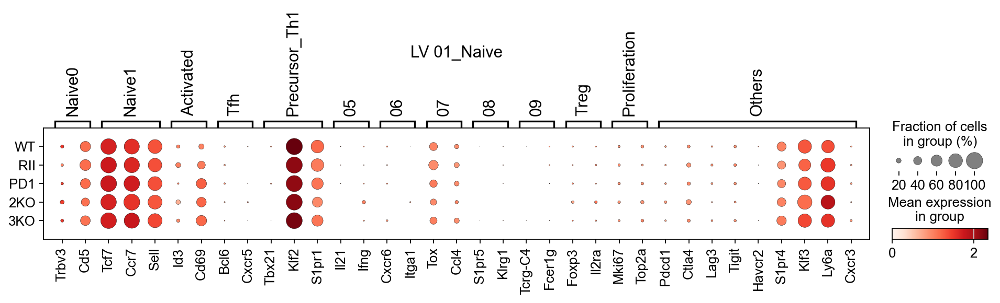

In [28]:
dataset = adata_LV
cluster = '01_Naive'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

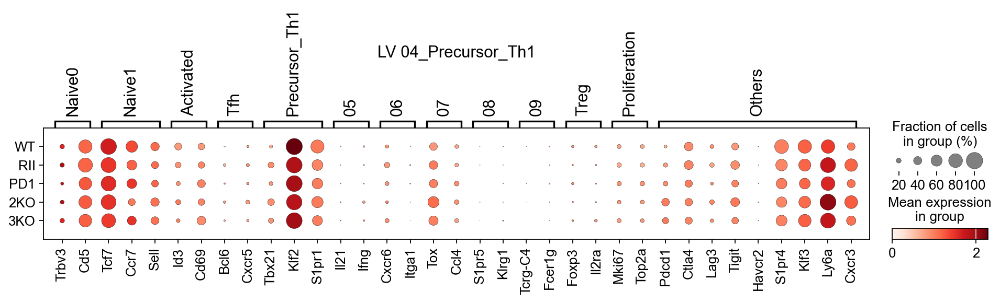

In [30]:
dataset = adata_LV
cluster = '04_Precursor_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

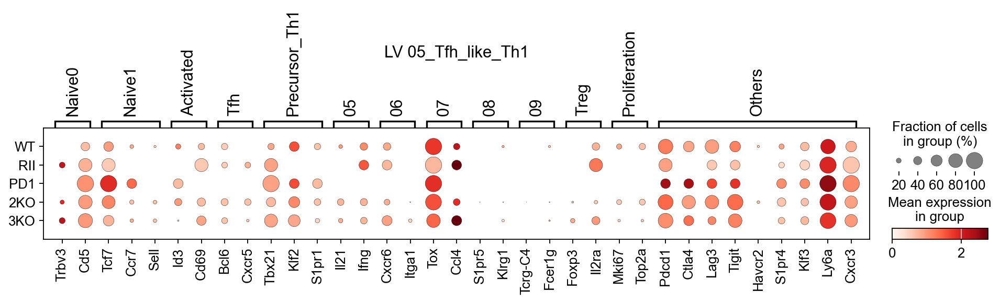

In [33]:
dataset = adata_LV
cluster = '05_Tfh_like_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

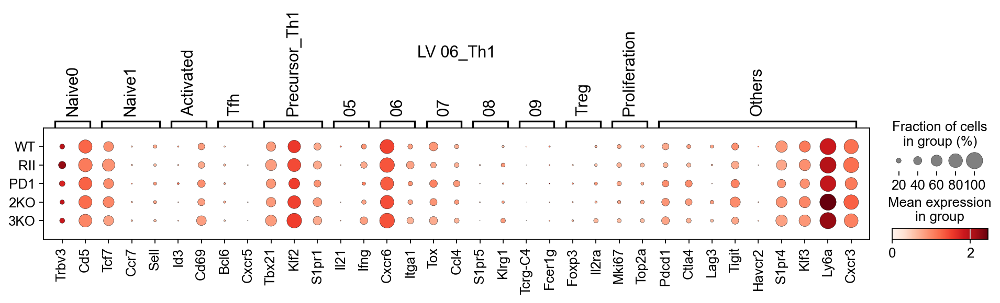

In [34]:
dataset = adata_LV
cluster = '06_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

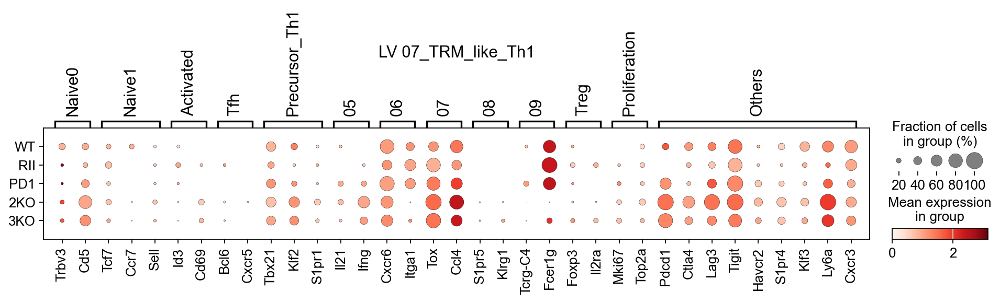

In [35]:
dataset = adata_LV
cluster = '07_TRM_like_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

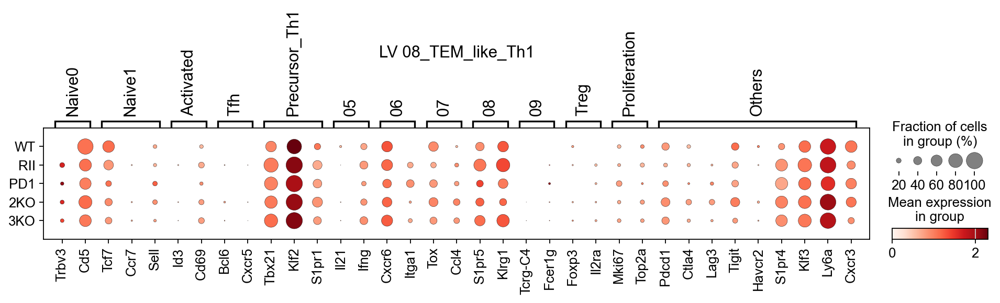

In [36]:
dataset = adata_LV
cluster = '08_TEM_like_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

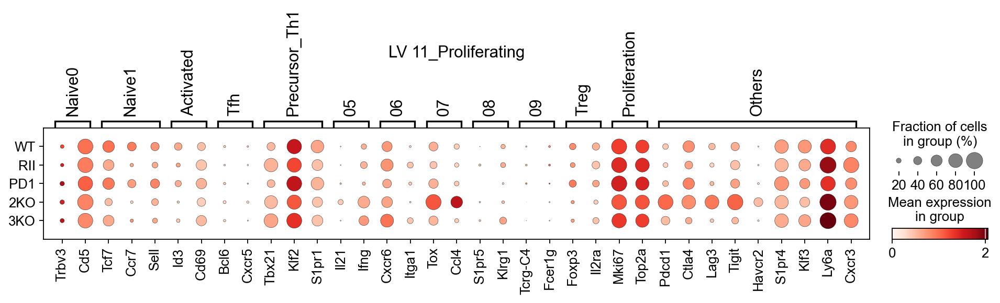

In [37]:
dataset = adata_LV
cluster = '11_Proliferating'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

#### LN

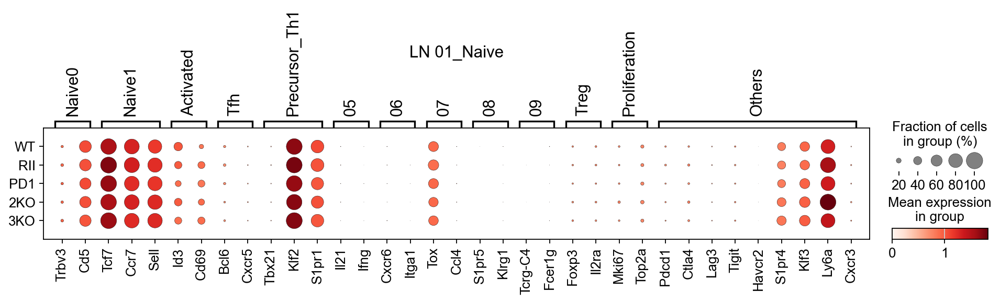

In [38]:
dataset = adata_LN
cluster = '01_Naive'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

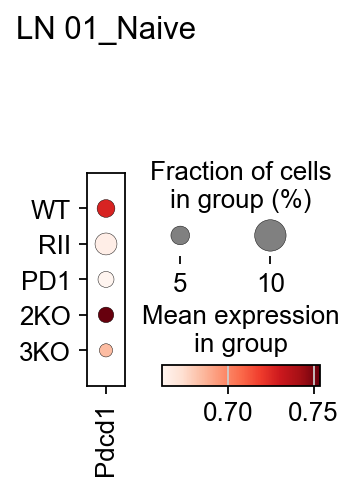

In [39]:
dataset = adata_LN
cluster = '01_Naive'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Pdcd1', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title + 'PD1')

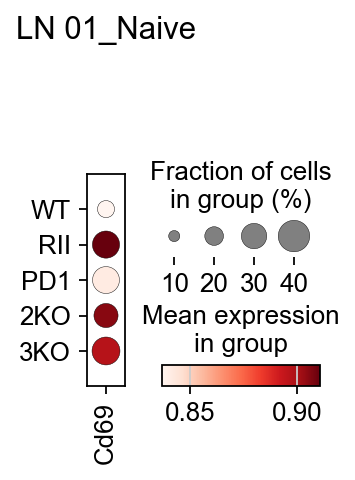

In [67]:
dataset = adata_LN
cluster = '01_Naive'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Cd69', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title + 'CD69')

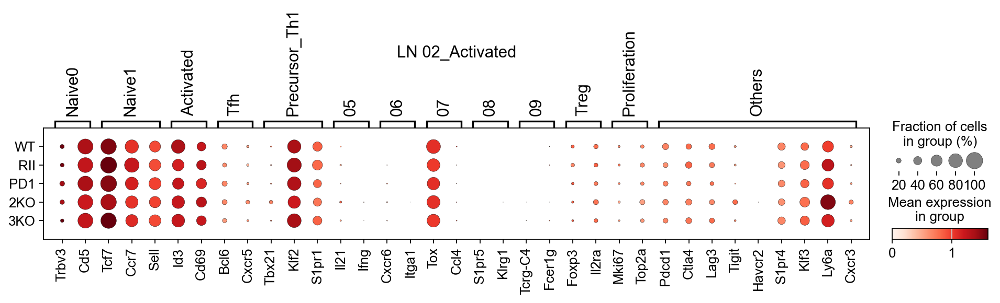

In [40]:
dataset = adata_LN
cluster = '02_Activated'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

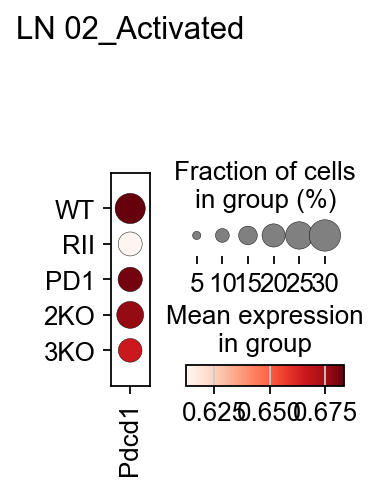

In [41]:
dataset = adata_LN
cluster = '02_Activated'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Pdcd1', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title + 'PD1')

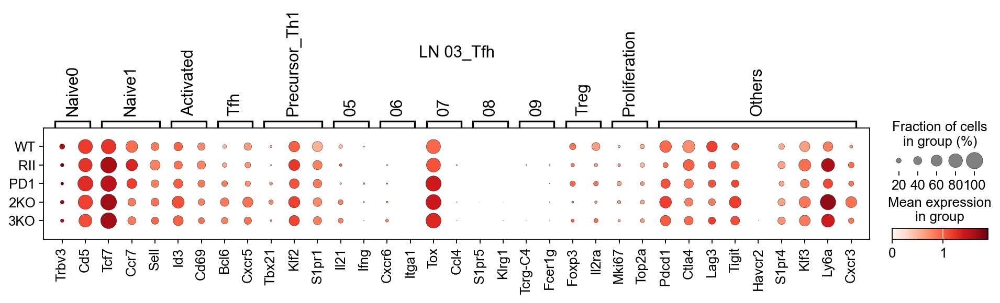

In [42]:
dataset = adata_LN
cluster = '03_Tfh'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

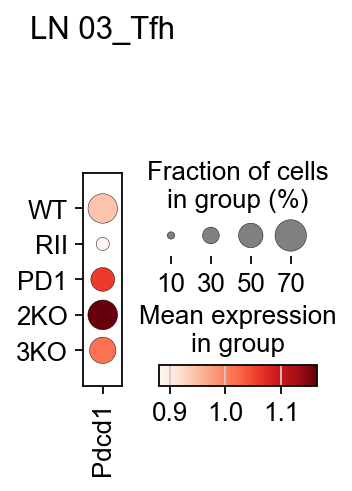

In [43]:
dataset = adata_LN
cluster = '03_Tfh'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Pdcd1', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title + 'PD1')

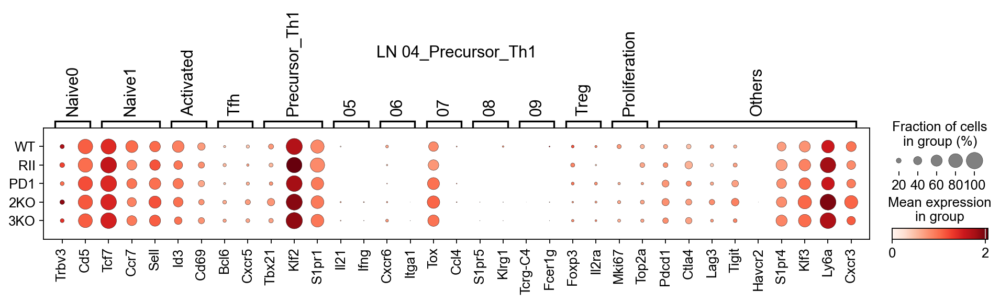

In [44]:
dataset = adata_LN
cluster = '04_Precursor_Th1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

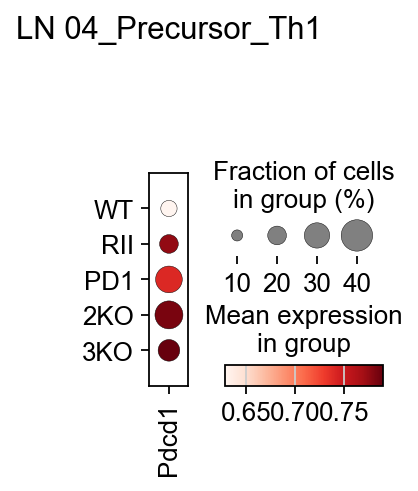

In [45]:
dataset = adata_LN
cluster = '04_Precursor_Th1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Pdcd1', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title + 'PD1')

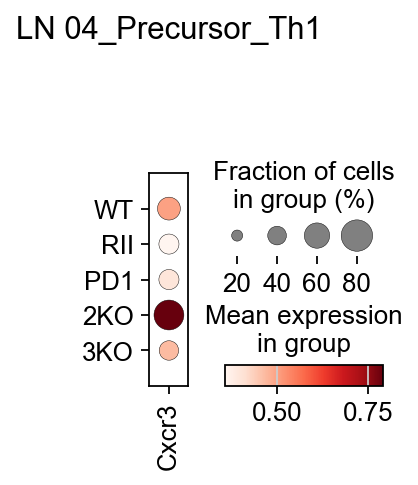

In [61]:
dataset = adata_LN
cluster = '04_Precursor_Th1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Cxcr3', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= False, title= title)

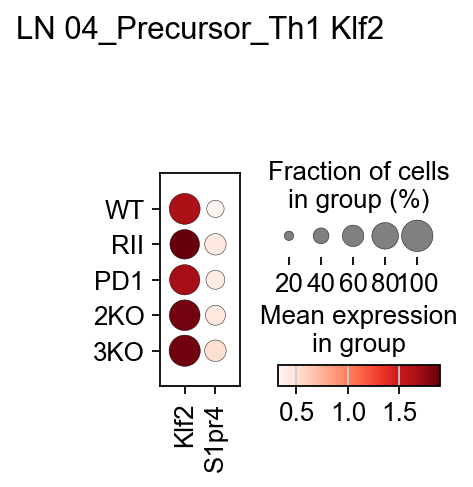

In [73]:
dataset = adata_LN
cluster = '04_Precursor_Th1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], ['Klf2', 'S1pr4'], groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= False, title= title + ' Klf2')

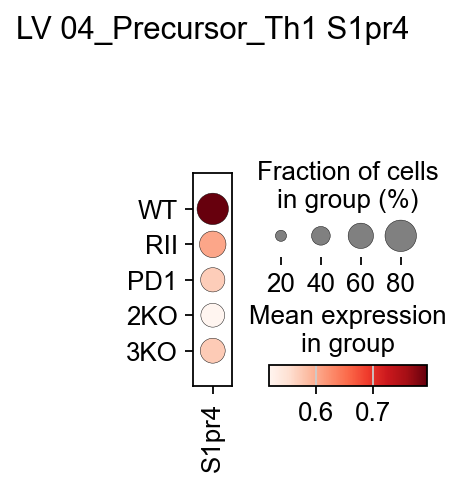

In [75]:
dataset = adata_LV
cluster = '04_Precursor_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], ['S1pr4'], groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= False, title= title + ' S1pr4')

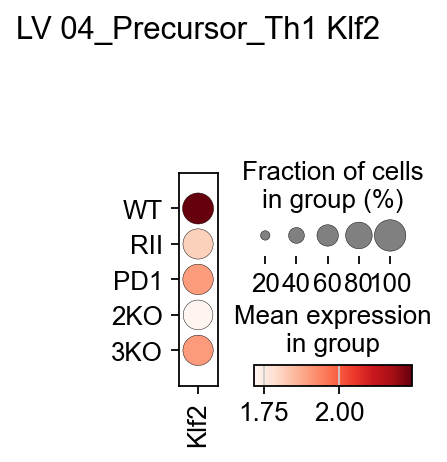

In [70]:
dataset = adata_LV
cluster = '04_Precursor_Th1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], 'Klf2', groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= False, title= title + ' Klf2')

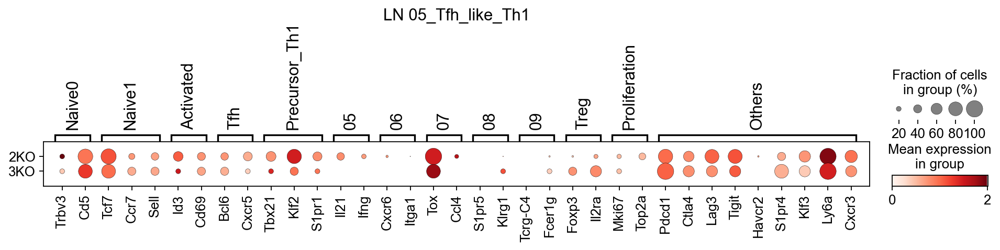

In [47]:
dataset = adata_LN
cluster = '05_Tfh_like_Th1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

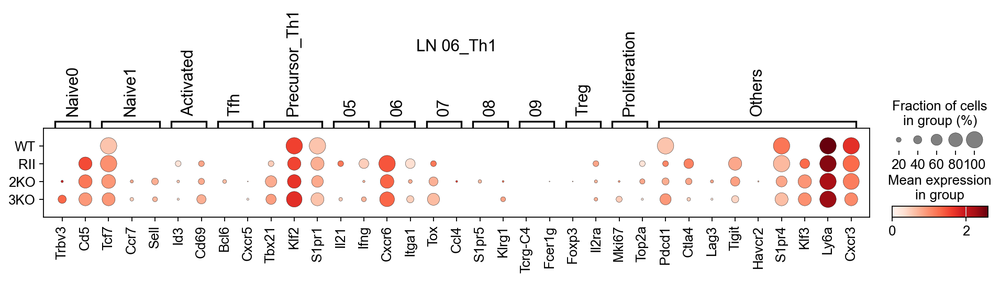

In [48]:
dataset = adata_LN
cluster = '06_Th1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['annotation'] == cluster], goi3, groupby = 'genotype', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

### dotplot across cluster by GT

#### WT

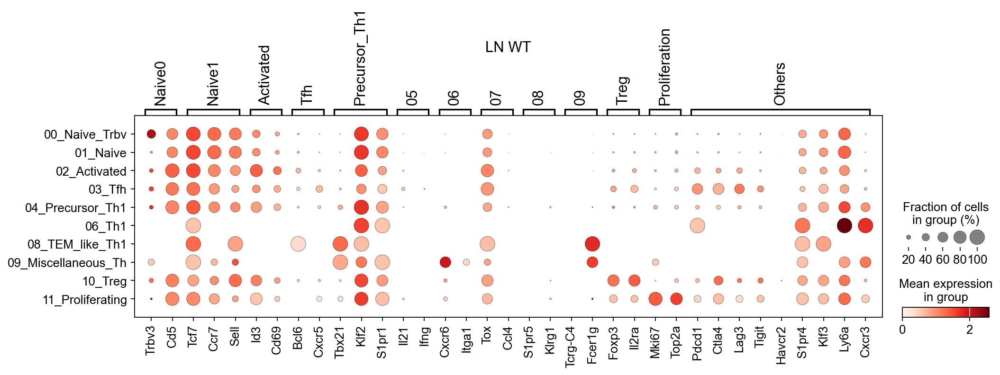

In [49]:
dataset = adata_LN
cluster = 'WT'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

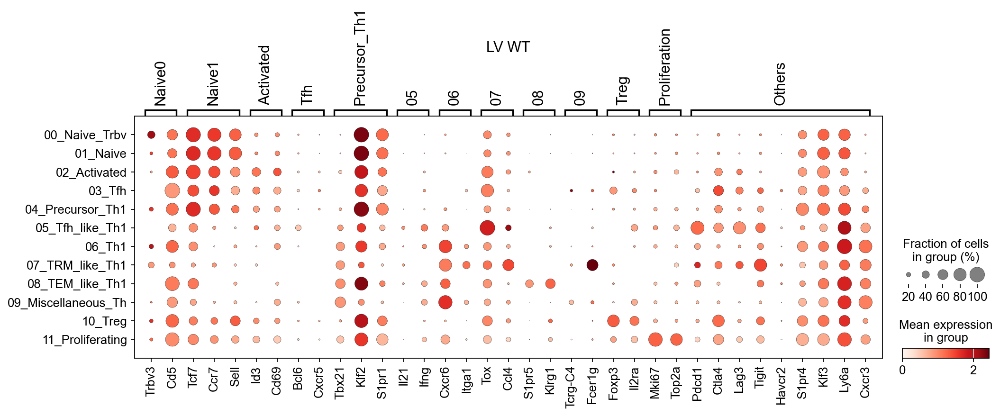

In [50]:
dataset = adata_LV
cluster = 'WT'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

#### RII

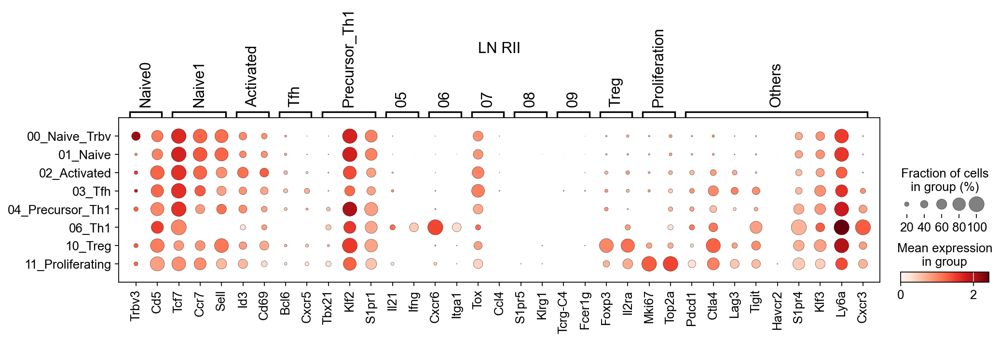

In [51]:
dataset = adata_LN
cluster = 'RII'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

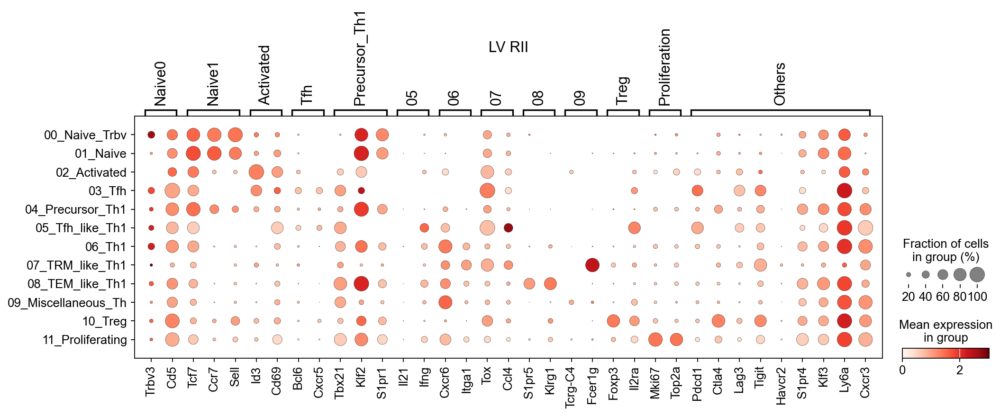

In [52]:
dataset = adata_LV
cluster = 'RII'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

#### PD1

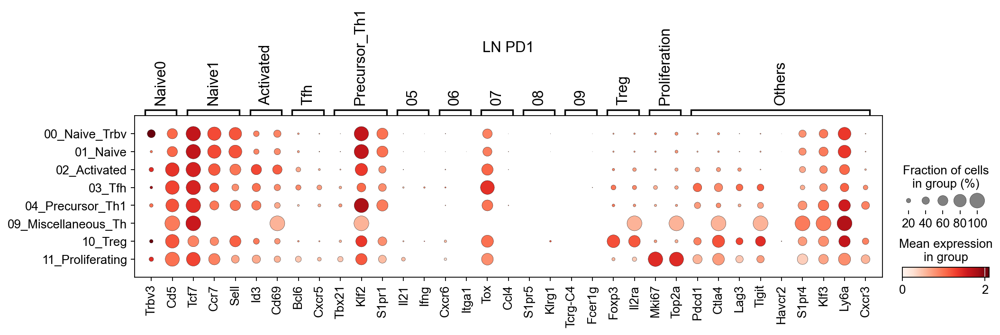

In [53]:
dataset = adata_LN
cluster = 'PD1'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

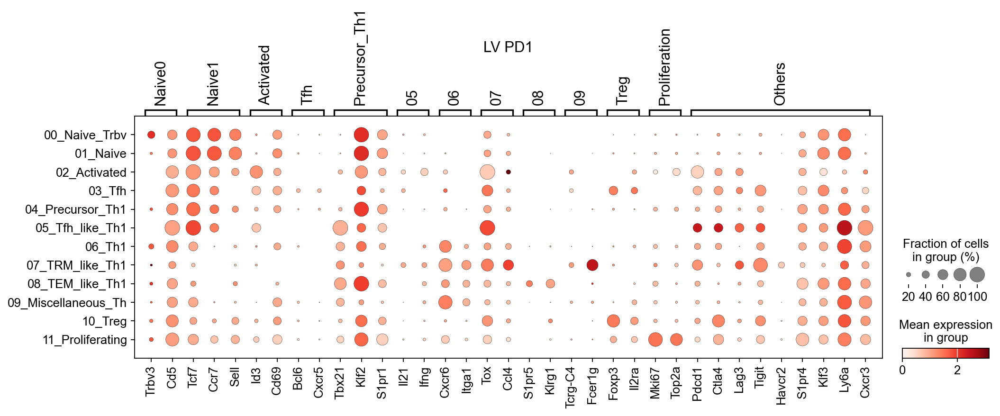

In [54]:
dataset = adata_LV
cluster = 'PD1'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

#### 2KO

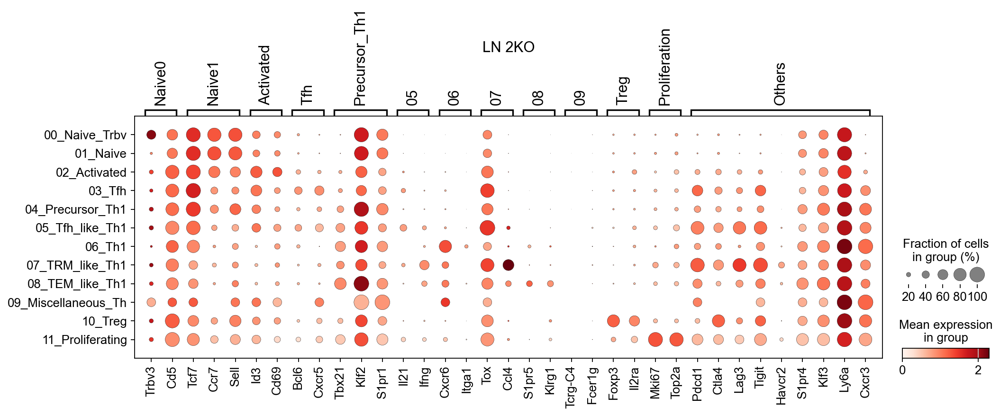

In [55]:
dataset = adata_LN
cluster = '2KO'
title = 'LN ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

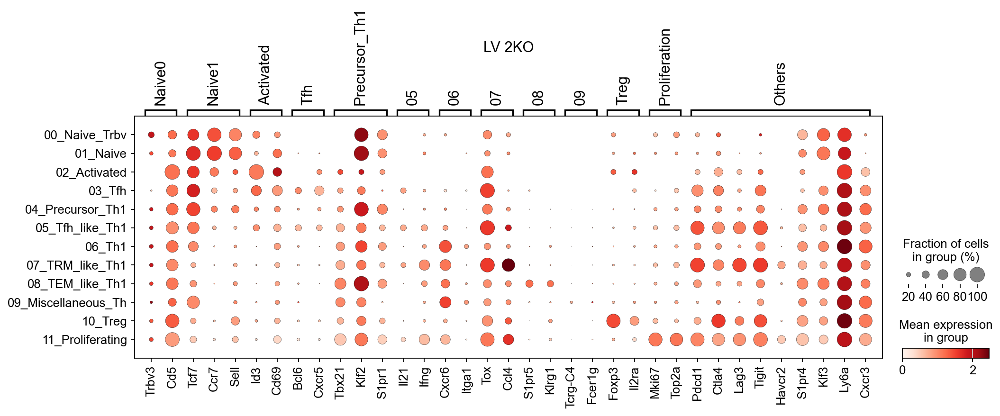

In [56]:
dataset = adata_LV
cluster = '2KO'
title = 'LV ' + cluster
ac = sc.pl.dotplot(dataset[dataset.obs['genotype'] == cluster], goi3, groupby = 'annotation', log=True, layer = 'norm_counts', 
                   show = True, mean_only_expressed= True, title= title, save = title)

# DEG 

## rank_genes_group across clusters
results saved in adata.uns[key]

In [7]:
sc.tl.rank_genes_groups(adata, 'annotation', method='wilcoxon', key_added = "wilcoxon_anno")

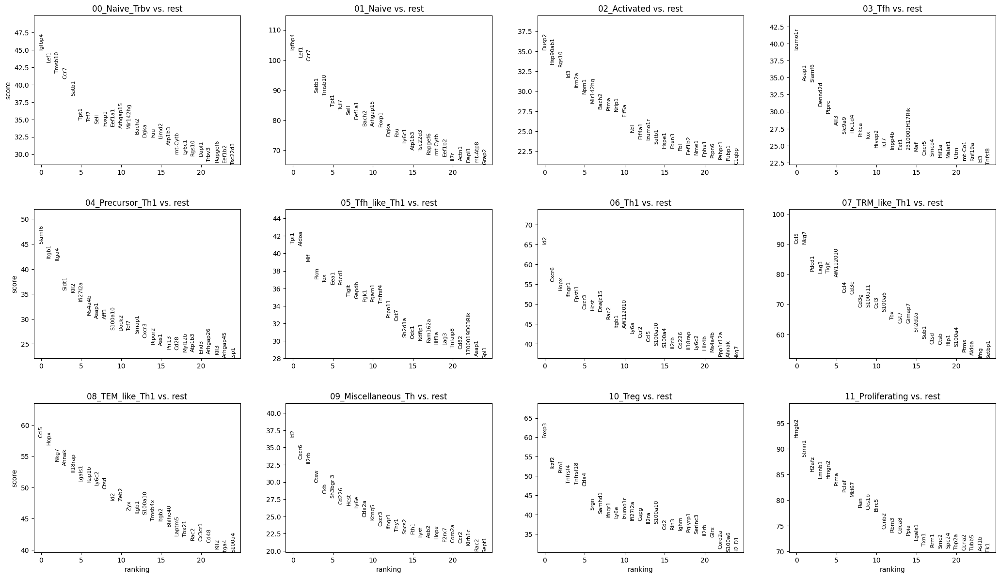

In [28]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key="wilcoxon_anno")

### vocano plot

In [33]:
print(*sorted(adata.obs['annotation'].unique()), sep='\n')

00_Naive_Trbv
01_Naive
02_Activated
03_Tfh
04_Precursor_Th1
05_Tfh_like_Th1
06_Th1
07_TRM_like_Th1
08_TEM_like_Th1
09_Miscellaneous_Th
10_Treg
11_Proliferating


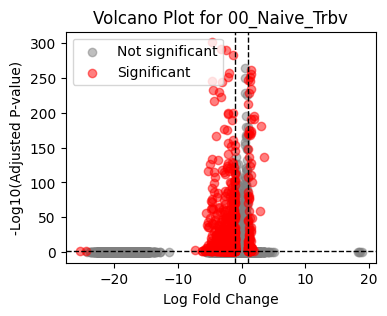

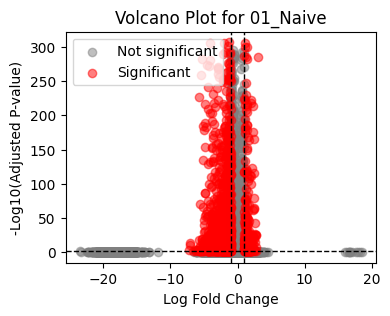

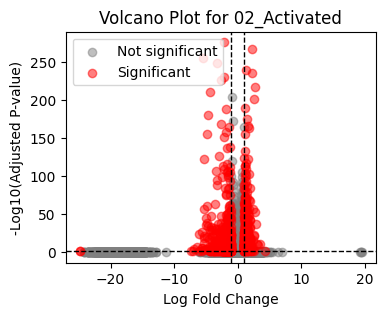

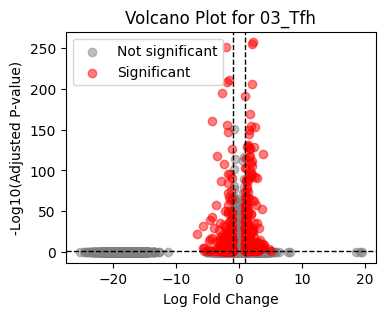

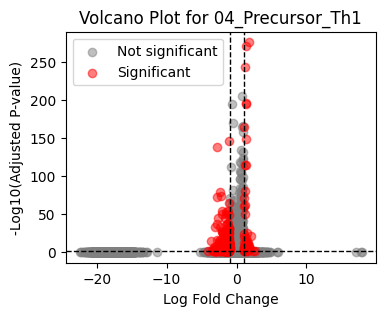

...

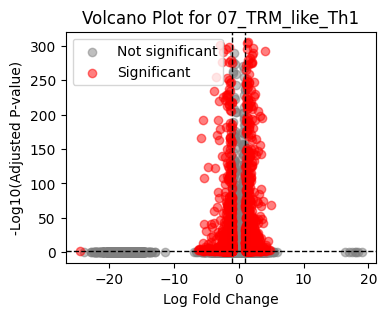

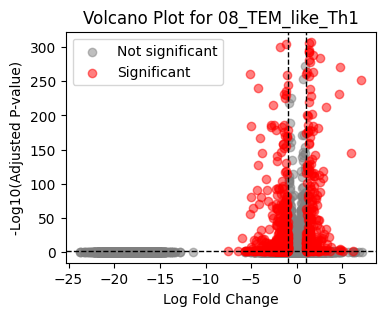

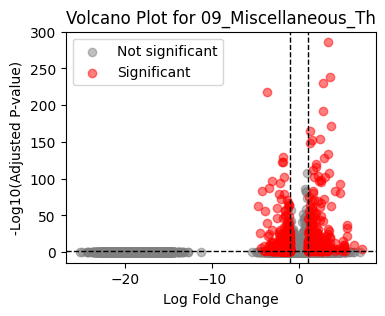

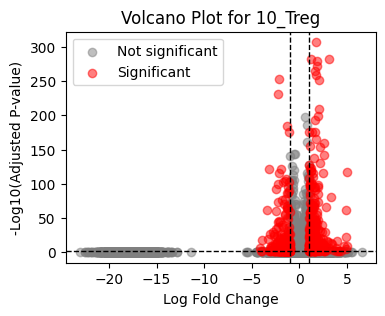

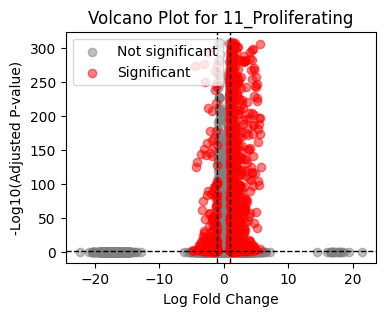

In [39]:
results = adata.uns['wilcoxon_anno']

for group in results['names'].dtype.names: #call customized function
    plot_volcano(group, results)


### heatmap of top 20

In [10]:
top_genes_dict = get_top_n_upregulated_genes(adata, n=20) # call customized function
# print(top_genes_dict)

{'00_Naive_Trbv': ['Trbv1', 'Trbv3', 'Trbv15', 'Igfbp4', 'Dapl1', 'A530021J07Rik', 'Ccr7', 'Ly6c1', 'Lef1', 'Trnp1', 'Satb1', 'Ampd1', 'Tspan9', 'Tbc1d16', 'Treml2', 'Pdlim4', 'Sell', 'Lypd6b', 'Slc16a5', 'Gabrr2'], '01_Naive': ['Igfbp4', 'Ly6c1', 'Ccr7', 'Dapl1', 'Pdlim4', 'Trnp1', 'Drc1', 'Acvrl1', 'Hotairm1', 'Atp1b1', 'Treml2', 'Ampd1', 'Nacc2', 'Slc16a5', 'Cd200r3', 'Tspan9', 'Ggt5', 'Actn1', 'Amigo2', 'Lef1'], '02_Activated': ['Arhgap20', 'Nr4a3', 'Egr3', 'Cldn10', 'Nr4a1', 'Id3', 'Myb', 'Egr2', 'Itm2a', 'Car12', 'Shmt1', 'Sox4', 'Egr1', 'Txnrd3', 'Bcat1', 'Rgs10', 'Pou2af1', 'Dusp2', '1110032F04Rik', 'Nefh'], '03_Tfh': ['Tnc', 'Ascl2', 'Cebpa', 'Cd22', 'Ces2c', 'Cxcr5', 'Sostdc1', 'Tnfsf11', 'Il4', 'Fam43a', 'Coro2b', 'Gpm6b', 'Grtp1', 'H2-Q2', 'Cdk5r1', 'C030034L19Rik', 'Atp1a3', 'Izumo1r', 'Zfyve28', 'Angptl2'], '04_Precursor_Th1': ['Zfhx3', 'Wfikkn2', 'Itgb1', 'Nebl', 'Il2', 'Mgarp', 'Slamf6', 'Sidt1', 'B3gnt5', 'Synpo', 'Slc9a7', 'Mctp1', 'C030034L19Rik', 'Itga4', 'Cxcr5', '

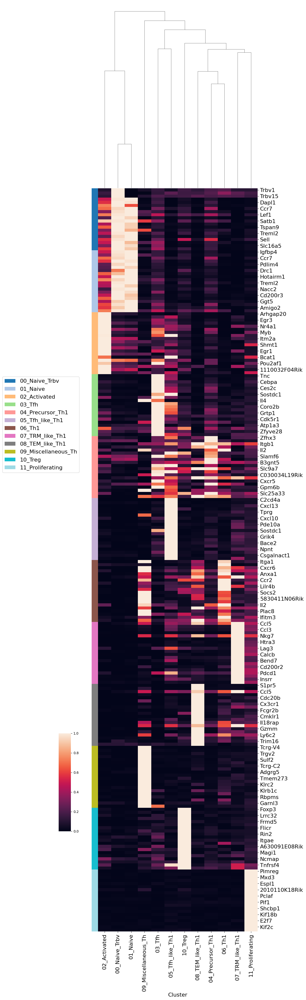

In [28]:
# need top_genes_dict and adata 
ALLMARKERS = []
for key, value in top_genes_dict.items():
    top_genes_dict[key] = [j for j in value if j in adata.var_names]
    ALLMARKERS += [j for j in top_genes_dict[key]]

# Extract unique categories for 'annotation' and define a color palette for them
categories_order = sorted(adata.obs['annotation'].dropna().astype('string').unique())
colors = plt.cm.tab20(np.linspace(0, 1, len(categories_order)))
palette_dict_anno = dict(zip(categories_order, colors))

# Assign colors to cell types based on the palette dictionary
celltype_col = []
for key, value in top_genes_dict.items():
    if key in palette_dict_anno:
        celltype_col += [palette_dict_anno[key]] * len(value)
    else:
        print(f"Warning: {key} not found in palette_dict_anno, using a fallback color.")
        celltype_col += ["#000000"] * len(value)  # Fallback color (black) if key not found

# Preparing the subset data
sub_data = adata.X[:, [adata.var_names.get_loc(j) for j in ALLMARKERS]]
sub_data = pd.DataFrame(sub_data, columns = ALLMARKERS, index = adata.obs_names)
sub_data['Cluster'] = adata.obs['annotation']

sub_data_avg = sub_data.groupby('Cluster').mean()

# Plotting the clustermap
g = sns.clustermap(sub_data_avg.T, standard_scale=0, row_cluster=False, col_cluster=True,
                   figsize=(10, 40), linewidths=0.002, cbar_pos=(0.05, .15, .05, .1), row_colors=celltype_col)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize=16)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize=16)
g.ax_heatmap.set_xlabel('Cluster', fontsize=16)
g.ax_heatmap.grid(False)  # Turn off the grid

# Drawing the legend bar for the clusters
for ct, label in enumerate(categories_order):
    g.ax_col_dendrogram.bar(0, 0, color=palette_dict_anno[label], label=label, linewidth=0)
g.ax_col_dendrogram.legend(ncol=1, bbox_to_anchor=(-0.1, -1), fontsize=16, markerscale=3)

Figure saved as figures/heatmap_top20_per_cluster_short_clustermap.png


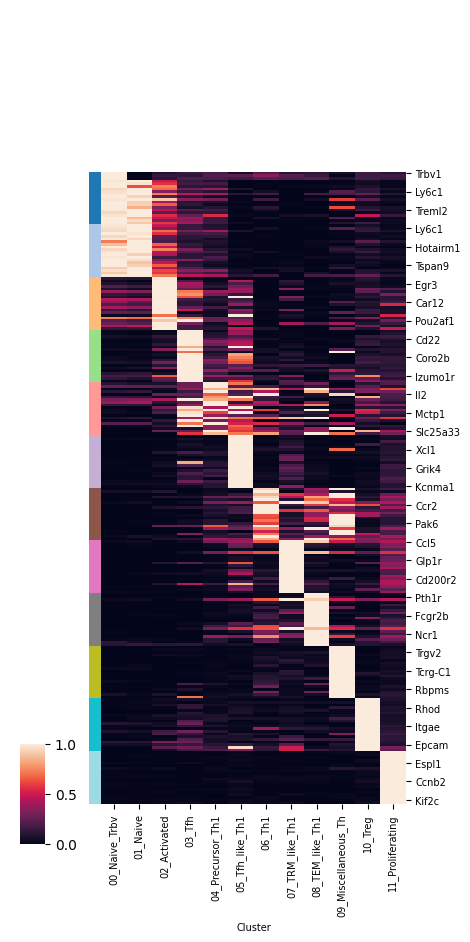

In [51]:
# wrap up the above clustermap into a customized function
plot_clustermap(top_genes_dict, adata, palette_dict_anno, plot_dendrogram=False, outbase='figures/heatmap_top20_per_cluster_short')

### write to csv

In [19]:
write_to_csv(adata, key_added = 'wilcoxon_anno', pval_threshold=0.05,  output = 'DEG_annotation/rank_genes_groups_annotation.xlsx')

### adata_4groups
exluding samples from 3KO genotype

In [23]:
sc.tl.rank_genes_groups(adata_4groups, 'annotation', method='wilcoxon', key_added = "wilcoxon_anno_4groups")

In [24]:
adata.uns['wilcoxon_anno_4groups'] = adata_4groups.uns['wilcoxon_anno_4groups']
write_to_csv(adata, key_added = 'wilcoxon_anno_4groups', pval_threshold=0.05,  output = 'DEG_annotation/rank_genes_groups_annotation_4groups.xlsx')

## hypothesis driven comparisons

### 06 Trm like 

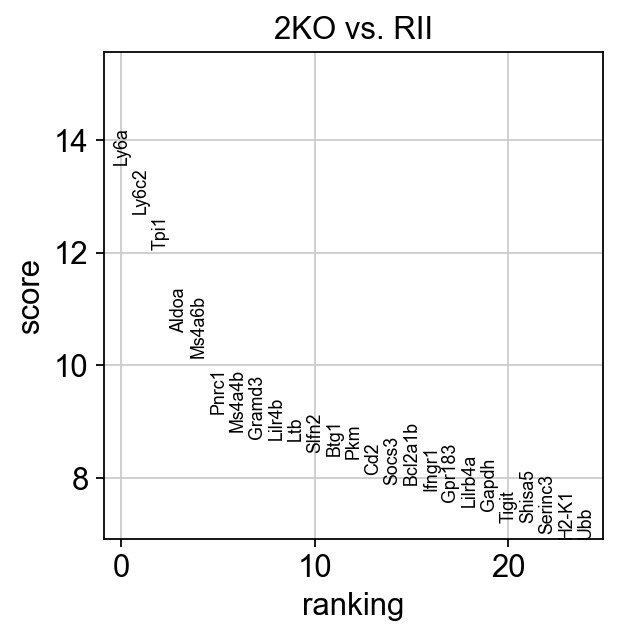

In [47]:
## subset on cluster 06, compare 2KO vs RII
adata_06 = adata[adata.obs['annotation'] == '06_Th1']
sc.tl.rank_genes_groups(adata_06, 'genotype', groups = ['2KO'], reference= 'RII', method='wilcoxon', key_added = "wilcoxon_06_2KO_RII")
sc.pl.rank_genes_groups(adata_06, n_genes=25, sharey=False, key="wilcoxon_06_2KO_RII")

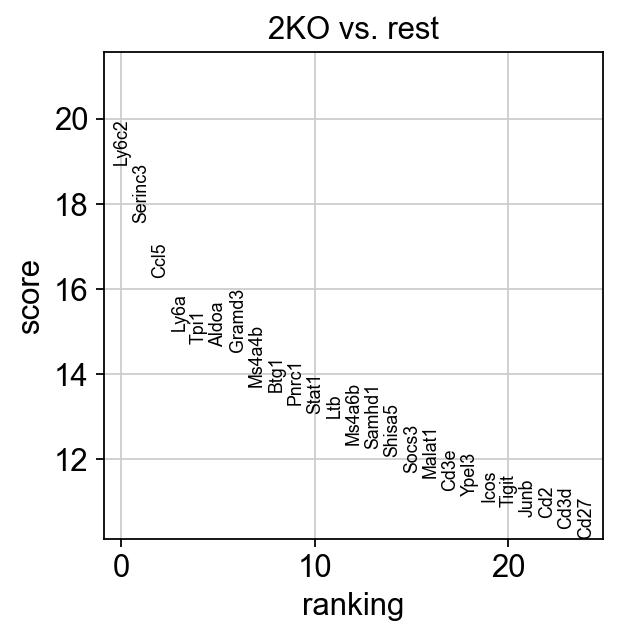

In [51]:
# 2KO vs rest
sc.tl.rank_genes_groups(adata_06, 'genotype', groups = ['2KO'], method='wilcoxon', key_added = "wilcoxon_06_2KO_rest")
sc.pl.rank_genes_groups(adata_06, n_genes=25, sharey=False, key="wilcoxon_06_2KO_rest")

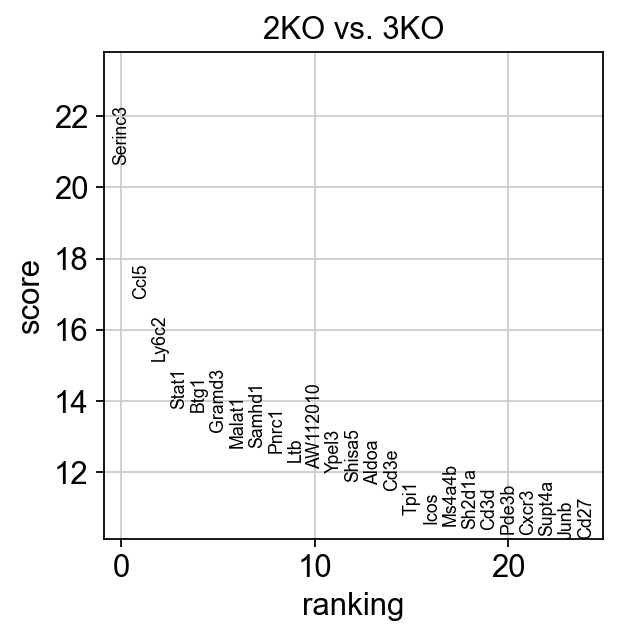

In [57]:
# 2KO vs 3KO
sc.tl.rank_genes_groups(adata_06, 'genotype', groups = ['2KO'], reference= '3KO', method='wilcoxon', key_added = "wilcoxon_06_2KO_3KO")
sc.pl.rank_genes_groups(adata_06, n_genes=25, sharey=False, key="wilcoxon_06_2KO_3KO")

In [55]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_06_2KO_rest.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_06.uns['wilcoxon_06_2KO_rest']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_06.uns['wilcoxon_06_2KO_rest'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [56]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_06_2KO_RII.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_06.uns['wilcoxon_06_2KO_RII']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_06.uns['wilcoxon_06_2KO_RII'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [58]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_06_2KO_3KO.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_06.uns['wilcoxon_06_2KO_3KO']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_06.uns['wilcoxon_06_2KO_3KO'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [ ]:
# write to csv in batch
keys = ["wilcoxon_06_2KO_RII", "wilcoxon_06_2KO_rest", "wilcoxon_06_2KO_3KO"]
for key in keys: #call customized function
    adata.uns[key] = adata_06.uns[key]
    output = 'DEG_annotation/rank_genes_groups_' + key
    print(output)
    write_to_csv(adata_06, key_added = key, pval_threshold=0.05,  output = output)

### 04 precursor Th1

In [63]:
## subset on cluster 06, compare 2KO vs rest within 06
adata_04 = adata[adata.obs['annotation'] == '04_Precursor_Th1']
adata_04_WT = adata_04[adata_04.obs['genotype'] == 'WT']
adata_04_WT

View of AnnData object with n_obs × n_vars = 342 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'pheno_louvain_0.6_colors', 'phen

In [64]:
adata_04_LV = adata_04[adata_04.obs['organ'] == 'LV']
adata_04_LN = adata_04[adata_04.obs['organ'] == 'LN']
adata_04_LN

View of AnnData object with n_obs × n_vars = 1597 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'pheno_louvain_0.6_colors', 'phe

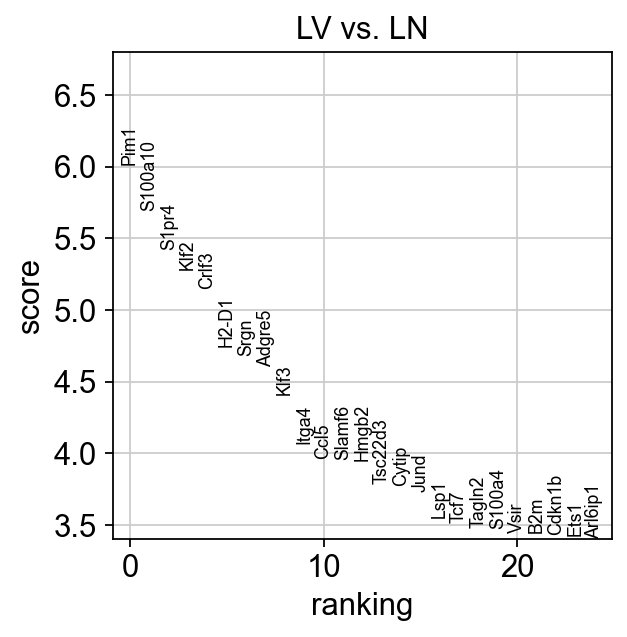

In [60]:
sc.tl.rank_genes_groups(adata_04_WT, 'organ', groups = ['LV'], reference= 'LN', method='wilcoxon', key_added = "wilcoxon_04_WT_LV_LN")
sc.pl.rank_genes_groups(adata_04_WT, n_genes=25, sharey=False, key="wilcoxon_04_WT_LV_LN")

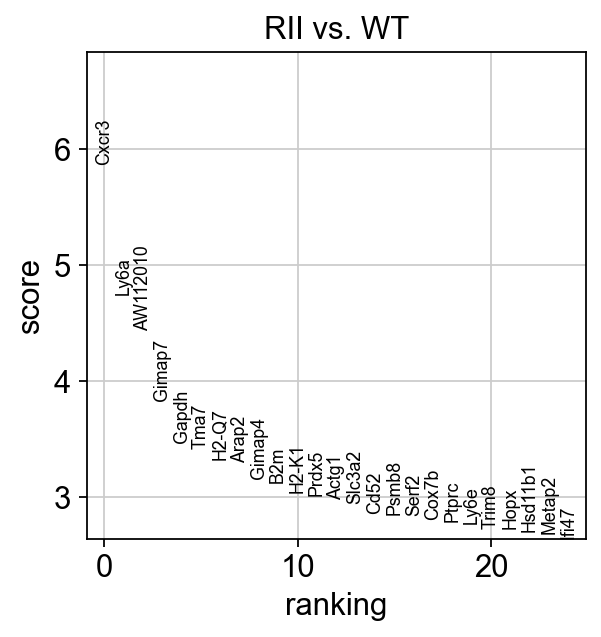

In [62]:
sc.tl.rank_genes_groups(adata_04_LV, 'genotype', groups = ['RII'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_04_LV_RII_WT")
sc.pl.rank_genes_groups(adata_04_LV, n_genes=25, sharey=False, key="wilcoxon_04_LV_RII_WT")

In [63]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_04_WT_LV_LN.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_04_WT.uns['wilcoxon_04_WT_LV_LN']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_04_WT.uns['wilcoxon_04_WT_LV_LN'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [68]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_04_LV_RII_WT.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_04_LV.uns['wilcoxon_04_LV_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_04_LV.uns['wilcoxon_04_LV_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [69]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_04_LV_RII_WT_all.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.999
    
    # Iterate through each group in the results
    for group in adata_04_LV.uns['wilcoxon_04_LV_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_04_LV.uns['wilcoxon_04_LV_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

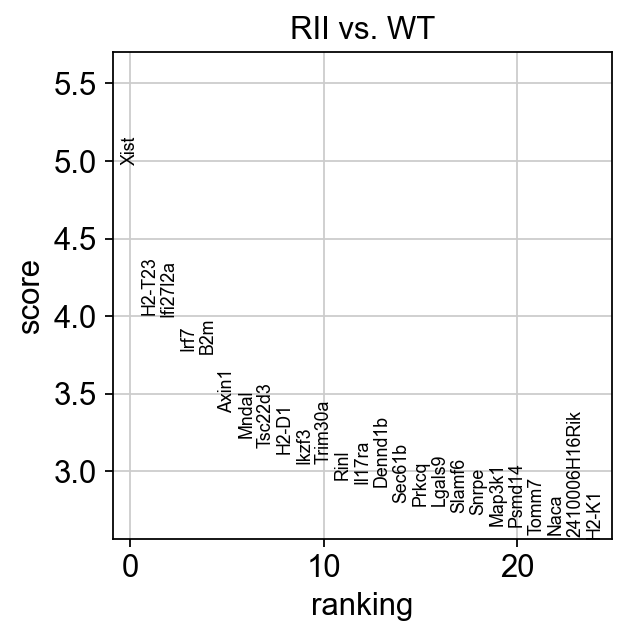

In [65]:
sc.tl.rank_genes_groups(adata_04_LN, 'genotype', groups = ['RII'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_04_LN_RII_WT")
sc.pl.rank_genes_groups(adata_04_LN, n_genes=25, sharey=False, key="wilcoxon_04_LN_RII_WT")

In [66]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_04_LN_RII_WT_all.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.999
    
    # Iterate through each group in the results
    for group in adata_04_LN.uns['wilcoxon_04_LN_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_04_LN.uns['wilcoxon_04_LN_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

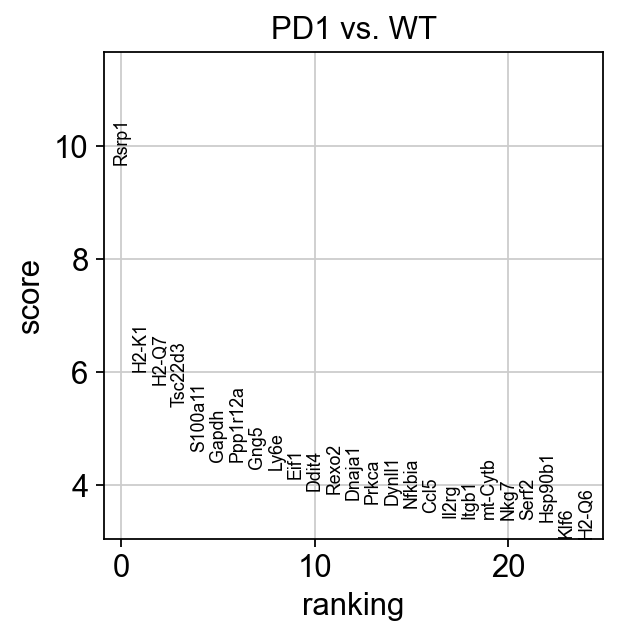

In [78]:
sc.tl.rank_genes_groups(adata_04_LV, 'genotype', groups = ['PD1'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_04_LV_PD1_WT")
sc.pl.rank_genes_groups(adata_04_LV, n_genes=25, sharey=False, key="wilcoxon_04_LV_PD1_WT")

In [80]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_04_LV_PD1_WT_all.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.999
    
    # Iterate through each group in the results
    for group in adata_04_LV.uns['wilcoxon_04_LV_PD1_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_04_LV.uns['wilcoxon_04_LV_PD1_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [81]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_04_LV_PD1_WT.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_04_LV.uns['wilcoxon_04_LV_PD1_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_04_LV.uns['wilcoxon_04_LV_PD1_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

### 10 Treg

In [70]:
## subset on Treg
adata_10 = adata[adata.obs['annotation'] == '10_Treg']
adata_10

View of AnnData object with n_obs × n_vars = 2043 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'pheno_louvain2_08', 'pheno_louvain2_16', 'pheno_louvain2_18', 'pheno_louvain2_20', 'pheno_louvain2_30', 'pheno_louvain2_08#', 'pheno_louvain2_16#', 'pheno_louvain2_18#', 'pheno_louvain2_20#', 'pheno_louvain2_30#'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1

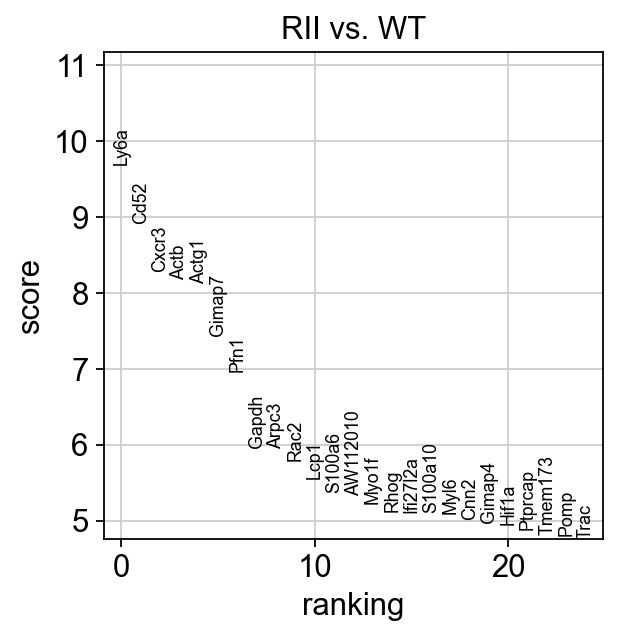

In [71]:
sc.tl.rank_genes_groups(adata_10, 'genotype', groups = ['RII'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_10_RII_WT")
sc.pl.rank_genes_groups(adata_10, n_genes=25, sharey=False, key="wilcoxon_10_RII_WT")

In [73]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_10_RII_WT.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_10.uns['wilcoxon_10_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_10.uns['wilcoxon_10_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

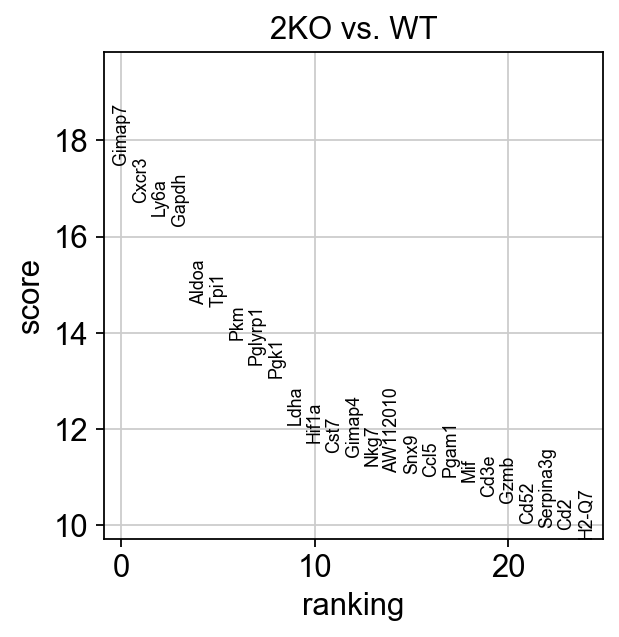

In [72]:
sc.tl.rank_genes_groups(adata_10, 'genotype', groups = ['2KO'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_10_2KO_WT")
sc.pl.rank_genes_groups(adata_10, n_genes=25, sharey=False, key="wilcoxon_10_2KO_WT")

In [74]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_10_2KO_WT.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_10.uns['wilcoxon_10_2KO_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_10.uns['wilcoxon_10_2KO_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

### 01 Naive

In [94]:
## subset on cluster 01
adata_01 = adata[adata.obs['annotation'] == '01_Naive']
adata_01

View of AnnData object with n_obs × n_vars = 9806 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'pheno_louvain2_08', 'pheno_louvain2_16', 'pheno_louvain2_18', 'pheno_louvain2_20', 'pheno_louvain2_30', 'pheno_louvain2_08#', 'pheno_louvain2_16#', 'pheno_louvain2_18#', 'pheno_louvain2_20#', 'pheno_louvain2_30#'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1

In [96]:
adata_01_LN = adata_01[adata_01.obs['organ'] == 'LN']
adata_01_LN

View of AnnData object with n_obs × n_vars = 7742 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation', 'pheno_louvain2_08', 'pheno_louvain2_16', 'pheno_louvain2_18', 'pheno_louvain2_20', 'pheno_louvain2_30', 'pheno_louvain2_08#', 'pheno_louvain2_16#', 'pheno_louvain2_18#', 'pheno_louvain2_20#', 'pheno_louvain2_30#'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1

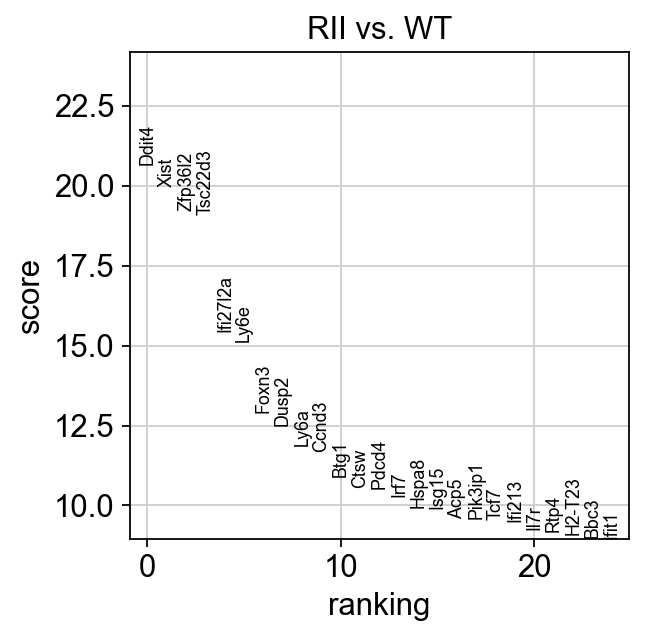

In [98]:
sc.tl.rank_genes_groups(adata_01_LN, 'genotype', groups = ['RII'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_01_RII_WT")
sc.pl.rank_genes_groups(adata_01_LN, n_genes=25, sharey=False, key="wilcoxon_01_RII_WT")

In [99]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_01_RII_WT.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_01_LN.uns['wilcoxon_01_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_01_LN.uns['wilcoxon_01_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

### 02 activated

In [ ]:
## subset on cluster 06, compare 2KO vs rest within 06
adata_02 = adata[adata.obs['annotation'] == '02_Activated']
adata_02

View of AnnData object with n_obs × n_vars = 1292 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'pheno_louvain_0.6_colors', 'phe

In [ ]:
## subset on cluster 06, compare 2KO vs rest within 06
adata_02_LN = adata_02[adata_02.obs['organ'] == 'LN']
adata_02_LN

View of AnnData object with n_obs × n_vars = 1262 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'pheno_louvain_0.6_colors', 'phe

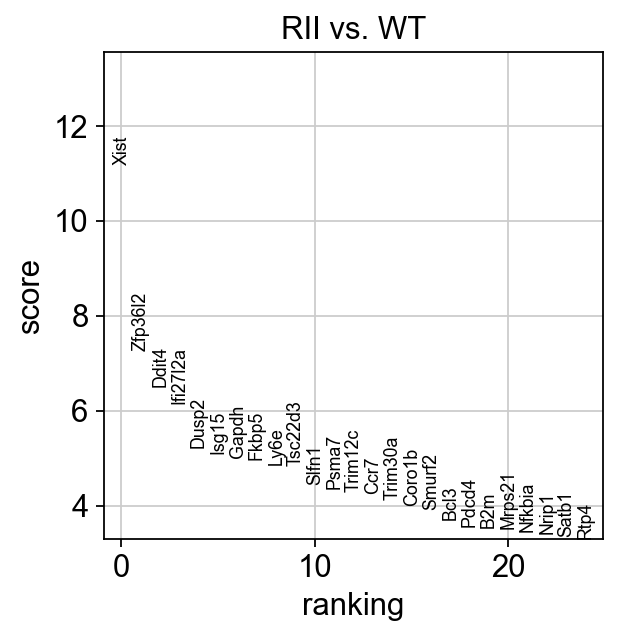

In [ ]:
sc.tl.rank_genes_groups(adata_02_LN, 'genotype', groups = ['RII'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_02_RII_WT")
sc.pl.rank_genes_groups(adata_02_LN, n_genes=25, sharey=False, key="wilcoxon_02_RII_WT")

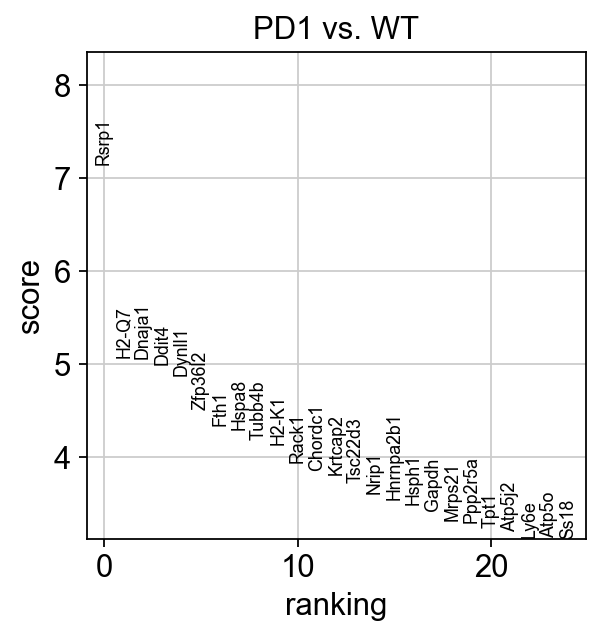

In [ ]:
sc.tl.rank_genes_groups(adata_02_LN, 'genotype', groups = ['PD1'], reference= 'WT', method='wilcoxon', key_added = "wilcoxon_02_PD1_WT")
sc.pl.rank_genes_groups(adata_02_LN, n_genes=25, sharey=False, key="wilcoxon_02_PD1_WT")

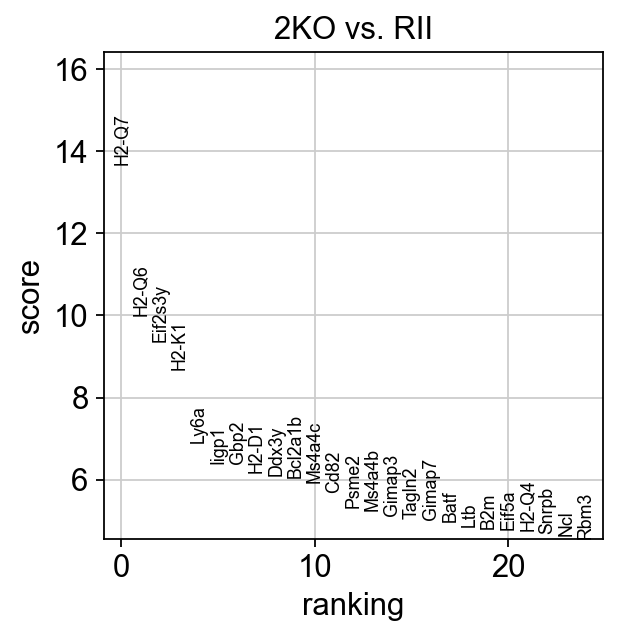

In [ ]:
sc.tl.rank_genes_groups(adata_02_LN, 'genotype', groups = ['2KO'], reference= 'RII', method='wilcoxon', key_added = "wilcoxon_02_2KO_RII")
sc.pl.rank_genes_groups(adata_02_LN, n_genes=25, sharey=False, key="wilcoxon_02_2KO_RII")

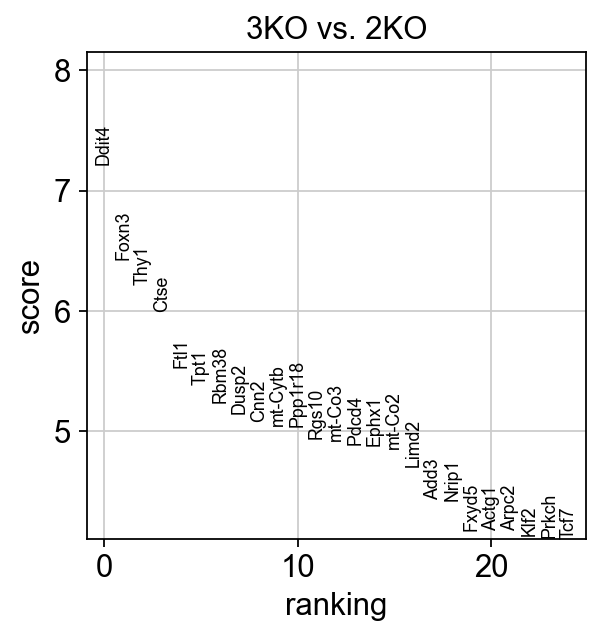

In [ ]:
sc.tl.rank_genes_groups(adata_02_LN, 'genotype', groups = ['3KO'], reference= '2KO', method='wilcoxon', key_added = "wilcoxon_02_3KO_2KO")
sc.pl.rank_genes_groups(adata_02_LN, n_genes=25, sharey=False, key="wilcoxon_02_3KO_2KO")

In [ ]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_LN_02_RII_WT.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_02_LN.uns['wilcoxon_02_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_02_LN.uns['wilcoxon_02_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [ ]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_LN_02_RII_WT_all.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_02_LN.uns['wilcoxon_02_RII_WT']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_02_LN.uns['wilcoxon_02_RII_WT'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [ ]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_02_LN_2KO_RII_sig.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_02_LN.uns['wilcoxon_02_2KO_RII']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_02_LN.uns['wilcoxon_02_2KO_RII'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

In [ ]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_02_LN_3KO_2KO_sig.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_02_LN.uns['wilcoxon_02_3KO_2KO']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_02_LN.uns['wilcoxon_02_3KO_2KO'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

### 02 activated vs 01 naive

In [82]:
adata_LN

View of AnnData object with n_obs × n_vars = 15518 × 16096
    obs: 'hash', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mito_frac', 'ribo_frac', 'doublet_score', 'predicted_doublet', 'predicted_doublet_as_string', 'organ', 'sample', 'genotype', 'pheno_louvain_1.4', 'pheno_louvain_1.4#', 'pheno_louvain', 'annotation_1.4_cluster', 'annotation'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'airr:clonal_expansion_colors', 'annotation_1.4_colors', 'color_colors', 'dendrogram_pheno_louvain', 'dendrogram_pheno_louvain_1.4', 'draw_graph', 'hvg', 'id_hvg', 'neighbors', 'neighbors_30', 'pca', 'pheno_louvain_0.4_colors', 'pheno_louvain_0.6_colors', 'ph

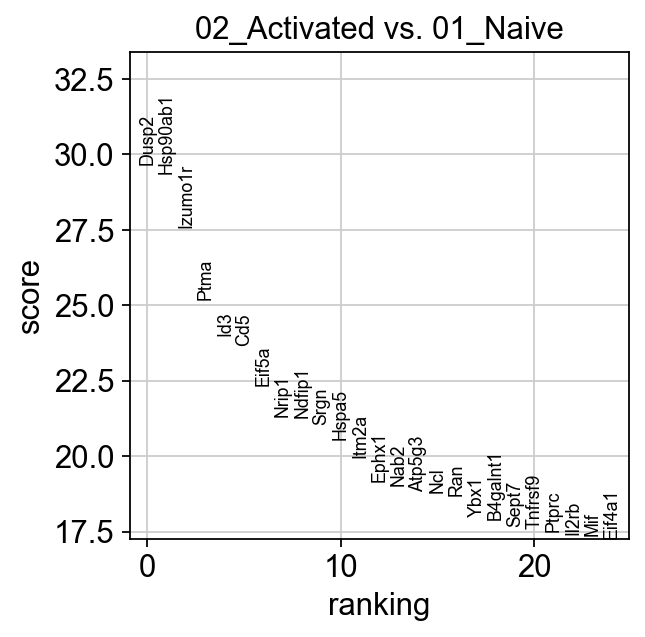

In [83]:
sc.tl.rank_genes_groups(adata_LN, 'annotation', groups = ['02_Activated'], reference= '01_Naive', method='wilcoxon', key_added = "wilcoxon_02_vs_01")
sc.pl.rank_genes_groups(adata_LN, n_genes=25, sharey=False, key="wilcoxon_02_vs_01")

In [84]:
# Open an Excel writer
with pd.ExcelWriter('DEG_annotation/rank_genes_groups_02_vs_01_LN.xlsx') as writer:
    # Assume pval_threshold is defined somewhere above this block
    # pval_threshold = 0.05
    
    # Iterate through each group in the results
    for group in adata_LN.uns['wilcoxon_02_vs_01']['names'].dtype.names:
        # For each group, create a DataFrame of results
        data = {key: adata_LN.uns['wilcoxon_02_vs_01'][key][group] for key in ['names', 'logfoldchanges', 'pvals_adj']}
        df = pd.DataFrame(data)
        
        # Filter genes based on significance
        df_significant = df[df['pvals_adj'] <= pval_threshold]
        
        # Sort by the absolute value of log fold change
        df_significant_sorted = df_significant.assign(abs_logfoldchanges=abs(df_significant['logfoldchanges'])).sort_values(by='abs_logfoldchanges', ascending=False)
        
        # Split into upregulated and downregulated based on log fold change
        df_up = df_significant_sorted[df_significant_sorted['logfoldchanges'] > 0]
        df_down = df_significant_sorted[df_significant_sorted['logfoldchanges'] < 0]
        
        # Drop the auxiliary 'abs_logfoldchanges' column used for sorting
        df_up = df_up.drop(columns=['abs_logfoldchanges'])
        df_down = df_down.drop(columns=['abs_logfoldchanges'])
        
        # Write to different sheets within the same Excel file
        df_up.to_excel(writer, sheet_name=f'{group}_upregulated', index=False)
        df_down.to_excel(writer, sheet_name=f'{group}_downregulated', index=False)

# MiloR

### data prep

In [27]:
# need to separate by LN and LV
# then need to randomly separate samples in the same genotype to 2 groups,
    # as milo require samples size >= 2
    # caveat: not able to do statastics, cal FDR

In [26]:
adata.obs['indices'] = np.random.choice(['_1', '_2'], size=len(adata.obs))

adata.obs['genotype_milo'] = adata.obs['genotype'].astype(str) + adata.obs['indices'].astype(str)
adata.obs['genotype_milo'] = adata.obs['genotype_milo'].astype('category')
adata.obs['genotype_milo'].unique()

['WT_1', 'WT_2', 'RII_1', 'RII_2', 'PD1_2', 'PD1_1', '2KO_2', '2KO_1', '3KO_1', '3KO_2']
Categories (10, object): ['2KO_1', '2KO_2', '3KO_1', '3KO_2', ..., 'RII_1', 'RII_2', 'WT_1', 'WT_2']

In [27]:
# Object for Milo
adata_milo = sc.AnnData(adata.X.copy(), 
                        obs = adata.obs[['sample', 'organ', 'genotype', 'genotype_milo', 'annotation']], 
                        var = adata.var)
adata_milo.obsm['X_pca'] = adata.obsm['X_pca']
adata_milo.obsm['X_umap'] = adata.obsm['X_umap']

In [29]:
# Check for NA values in 'col1'
has_na = pd.isna(adata_milo.obs['genotype_milo']).any()
has_na

False

In [30]:
# prevent causing error in R
adata_milo.obs[['sample', 'organ', 'genotype', 'genotype_milo', 'annotation']] = adata_milo.obs[['sample', 'organ', 'genotype', 'genotype_milo', 'annotation']].astype(str)

In [31]:
LV = adata.obs['organ'] == 'LV'
LN = adata.obs['organ'] == 'LN'
# Subset adata using the mask
adata_LV_milo = adata[LV].copy()
adata_LN_milo = adata[LN].copy()

#### design matrix

In [32]:
#design matrix LV
design_df = adata_LV_milo.obs[["genotype", "genotype_milo"]].copy()
design_df.drop_duplicates(inplace=True)
design_df.index = design_df['genotype_milo']
design_df

,genotype,genotype_milo
genotype_milo,,
WT_2,WT,WT_2
WT_1,WT,WT_1
RII_1,RII,RII_1
RII_2,RII,RII_2
PD1_1,PD1,PD1_1
PD1_2,PD1,PD1_2
2KO_1,2KO,2KO_1
2KO_2,2KO,2KO_2
3KO_1,3KO,3KO_1


### Custmized plot function

In [5]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
def plot_diff_analysis_results(DA_results, outbase="", title="sample 1 vs sample 2", sig_threshold=0.05):
    """
    Plots FDR results using sns.stripplot with automatic jitter, coloring points based on the sign of logFC and significance.

    Parameters:
    - DA_results: DataFrame with columns ['FDR', 'logFC', 'annotation']
    - title: Title of the plots
    - sig_threshold: Threshold for significance based on FDR
    """
    # Calculate log_FDR and determine significance
    DA_results['log_FDR'] = -np.log10(DA_results['FDR'])
    DA_results['is_sig'] = DA_results['FDR'] < sig_threshold

    # Assign significance direction based on the sign of logFC for significant points
    DA_results['sig'] = 'Not Significant'
    DA_results.loc[(DA_results['is_sig']) & (DA_results['logFC'] < 0), 'sig'] = 'Sig Down'
    DA_results.loc[(DA_results['is_sig']) & (DA_results['logFC'] > 0), 'sig'] = 'Sig Up'

    # Convert 'annotation' to a categorical type with categories sorted alphabetically
    DA_results['annotation'] = pd.Categorical(DA_results['annotation'], categories=sorted(DA_results['annotation'].unique()), ordered=True)


    # Plotting
    fig, ax = plt.subplots(figsize=(3, 4))
    plt.title(title, fontsize=10)

    # Use sns.stripplot with hue for coloring based on significance direction
    sns.stripplot(x='logFC', y='annotation', hue='sig', data=DA_results, jitter=0.2, size =3,
                  palette={'Sig Down': '#56B4E9', 'Sig Up': '#E69F00', 'Not Significant': 'grey'},
                  edgecolor='none', ax=ax)

    # Customize plot
    ax.set_xlabel('logFC', fontsize=10)
    ax.set_ylabel('Celltypes', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=10)
    sns.despine()
    
    # Adjust legend to only show significance-related categories
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles=handles[1:], labels=labels[1:], title='Significance', bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

    # Optionally save the figure
    if outbase:
      fig.savefig(f"{outbase}milor_swarmplot_highlighted_sig_FDR for {title}.pdf", dpi=300, bbox_inches='tight')

    plt.show()

In [6]:
def plot_diff_analysis_results_fc(DA_results, outbase="", title="sample 1 vs sample 2", logFC_cut=2.5):
    """
    Plots FDR results using sns.stripplot with automatic jitter, coloring points based on the value of logFC and a specific cut-off.

    Parameters:
    - DA_results: DataFrame with columns ['FDR', 'logFC', 'annotation']
    - title: Title of the plots
    - sig_threshold: Threshold for significance based on FDR
    - logFC_cut: Threshold for logFC to color points orange if >= logFC_cut or blue if <= -logFC_cut
    """
    # Calculate log_FDR and determine significance
    DA_results['log_FDR'] = -np.log10(DA_results['FDR'])

    # Assign color based on the value of logFC
    DA_results['color'] = 'grey'  # default color for non-significant or mid-range logFC values
    DA_results.loc[DA_results['logFC'] >= logFC_cut, 'color'] = 'orange'
    DA_results.loc[DA_results['logFC'] <= -logFC_cut, 'color'] = 'blue'

    # Convert 'annotation' to a categorical type with categories sorted alphabetically
    DA_results['annotation'] = pd.Categorical(DA_results['annotation'], categories=sorted(DA_results['annotation'].unique()), ordered=True)

    # Plotting
    fig, ax = plt.subplots(figsize=(3, 4))
    plt.title(title, fontsize=10)

    # Use sns.stripplot with color for coloring based on logFC threshold
    sns.stripplot(x='logFC', y='annotation', hue='color', data=DA_results, jitter=0.2, size=3,
                  palette={'orange': '#E69F00', 'blue': '#56B4E9', 'grey': 'grey'},
                  edgecolor='none', ax=ax)

    # Customize plot
    ax.set_xlabel('logFC', fontsize=10)
    ax.set_ylabel('Cell types', fontsize=10)
    ax.tick_params(axis='both', which='major', labelsize=10)
    sns.despine()

    # Adjust legend to show only color-related categories
    handles, labels = ax.get_legend_handles_labels()
    legend_dict = dict(zip(labels, handles))  # removing duplicate labels in legend
    ax.legend(legend_dict.values(), legend_dict.keys(), title='logFC Color', bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

    # Optionally save the figure
    if outbase:
        fig.savefig(f"{outbase}milor_swarmplot_highlighted_logFC {logFC_cut} for {title}.pdf", dpi=300, bbox_inches='tight')

    plt.show()

In [14]:
def plot_diff_analysis_results_scale(DA_results, outbase="", title = 'sample 1 vs sample 2'):
    """
    Plots differential analysis results.

    Parameters:
    - DA_results: DataFrame with columns ['FDR', 'SpatialFDR', 'PValue', 'logFC', 'annotation']
    - outbase: Base path for saving the plots
    """
    for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
        fig = plt.figure(figsize=(3, 4))
        DA_results['log_' + item] = -np.log10(DA_results[item])
        # Convert 'annotation' to a categorical type with categories sorted alphabetically
        DA_results['annotation'] = pd.Categorical(DA_results['annotation'], categories=sorted(DA_results['annotation'].unique()), ordered=True)

        ax = fig.add_subplot(1, 1, 1)
        plt.title(title, fontsize=10)
        plot = sns.stripplot(x='logFC', y='annotation', hue='log_' + item, data=DA_results, size=3,
                             palette='cividis', jitter=0.2, edgecolor='none', ax=ax)
        plot.get_legend().set_visible(False)
        ax.set_xticklabels(ax.get_xticks(), fontsize=10)
        ax.set_yticklabels(ax.get_yticklabels(), fontsize=10)
        ax.set_ylabel('Celltypes', fontsize=10)
        ax.set_xlabel('logFC', fontsize=10)
        sns.despine()

        # Drawing the side color bar
        #normalize = mcolors.Normalize(vmin=DA_results['log_' + item].min(), vmax=DA_results['log_' + item].max())
        normalize = mcolors.Normalize(vmin=0, vmax=3)
        colormap = cm.cividis
        scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
        scalarmappaple.set_array(DA_results['log_' + item])
        cbar = fig.colorbar(scalarmappaple)
        ticks = cbar.ax.get_yticks()
        cbar.ax.set_yticklabels(['{:.1f}'.format(-np.log10(tick)) for tick in np.power(10, -ticks)], fontsize=10)
        cbar.ax.set_ylabel('-log10(' + item + ')', labelpad=20, rotation=90, fontsize=10)
        ax.grid(False)

        # Optionally save the figure
        if outbase:
            fig.savefig(f"{outbase}mile_swarmplot_for_{title}_colored_by_log_{item}_scale.pdf", dpi=300, bbox_inches='tight')
        plt.show()

In [15]:
def plot_diff_analysis_results_capped(DA_results, vmax, outbase="", title='sample 1 vs sample 2'):
    # Define the colormap
    colormap = cm.cividis

    for j, item in enumerate(['FDR', 'SpatialFDR', 'PValue']):
        DA_results['log_' + item] = -np.log10(DA_results[item])

        # Cap the 'log_' + item values at vmax
        capped_values = np.minimum(DA_results['log_' + item], vmax)
        # Convert 'annotation' to a categorical type with categories sorted alphabetically
        DA_results['annotation'] = pd.Categorical(DA_results['annotation'], categories=sorted(DA_results['annotation'].unique()), ordered=True)

        # Calculate the colors for each data point based on capped 'log_' + item values
        # Here, the normalization range is explicitly from the min to vmax, since we've capped the values
        normalize = mcolors.Normalize(vmin=capped_values.min(), vmax=vmax)
        colors = [colormap(normalize(value)) for value in capped_values]

        fig = plt.figure(figsize=(3, 4))
        ax = fig.add_subplot(1, 1, 1)
        plt.title(title, fontsize=10)

        # Manually assign colors to each point in the stripplot
        sns.stripplot(x='logFC', y='annotation', palette=colors, data=DA_results, size=3,
                      jitter=0.2, edgecolor='none', ax=ax)
        
        ax.set_xticklabels(ax.get_xticks(), fontsize=10)
        ax.set_yticklabels(sorted(ax.get_yticklabels(), key=lambda x: x.get_text()), fontsize=10)  # Sort y-axis alphabetically
        ax.set_ylabel('Celltypes', fontsize=10)
        ax.set_xlabel('logFC', fontsize=10)
        sns.despine()

        # Create a color bar with the correct scaling
        scalarmappaple = cm.ScalarMappable(norm=normalize, cmap=colormap)
        scalarmappaple.set_array([])
        cbar = fig.colorbar(scalarmappaple)
        cbar.ax.set_ylabel('-log10(' + item + ')', labelpad=20, rotation=90, fontsize=10)
        
        ax.grid(False)

        # Optionally save the figure
        if outbase:
            fig.savefig(f"{outbase}mile_swarmplot_for_{title}_capped_by_log_{item}.pdf", dpi=300, bbox_inches='tight')
        plt.show()

# Example usage:
#plot_diff_analysis_results_capped(DA_results_RIIWT, title = 'LV RII vs WT',outbase='figures/', vmax=5)

### set up R

In [3]:
# set up for MiloR
import os
os.environ['R_HOME'] = '/Library/Frameworks/R.framework/Resources'
os.environ['R_USER'] = '/Library/Frameworks/R.framework/Versions/4.3-x86_64/Resources/library'

import rpy2
import anndata2ri

# anndata2ri interconverts AnnData and Single Cell Experiment objects
anndata2ri.activate()
#%load_ext rpy2.ipython
%reload_ext rpy2.ipython

In [4]:
%%R
library(miloR)
library(igraph)
library(ggplot2)
library(SingleCellExperiment)
library(zellkonverter)

R[write to console]: Loading required package: edgeR

R[write to console]: Loading required package: limma



R[write to console]: 
Attaching package: ‘igraph’


R[write to console]: The following object is masked from ‘package:miloR’:

    graph


R[write to console]: The following objects are masked from ‘package:stats’:

    decompose, spectrum


R[write to console]: The following object is masked from ‘package:base’:

    union


R[write to console]: Loading required package: SummarizedExperiment

R[write to console]: Loading required package: MatrixGenerics

R[write to console]: Loading required package: matrixStats

R[write to console]: 
Attaching package: ‘MatrixGenerics’


R[write to console]: The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    col


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

R[write to console]: Registered S3 methods overwritten by 'zellkonverter':
  method                                             from      
  py_to_r.numpy.ndarray                              reticulate
  py_to_r.pandas.core.arrays.categorical.Categorical reticulate



### adata_LV

In [64]:
%%R -i adata_LV_milo
# save(adata_LV_milo, file = "intermediate/00_adata_LV_milo.RData")

# the anndata2ri packages will convert the anndata object into SingleCellExperiment object 
# (for more details see here: https://bioconductor.org/packages/release/bioc/html/SingleCellExperiment.html)
# kernel migth die, be prepared
# take long, 10+ min


In [19]:
%%R
# to load the saved file back
load("intermediate/00_adata_LV_milo.RData")

# Check the type of `adata_LV_milo`
print(class(adata_LV_milo))

[1] "SingleCellExperiment"
attr(,"package")
[1] "SingleCellExperiment"


In [20]:
%%R 
r_milo <- Milo(adata_LV_milo) # convert to a Milo object
r_milo

class: Milo 
dim: 16096 17948 
metadata(19): airr:clonal_expansion_colors annotation_1.4_colors ...
  wilcoxon_1.4 wilcoxon_anno
assays(4): X norm_counts raw_data zs_norm_log
rownames(16096): Xkr4 Mrpl15 ... CAAA01147332.1 AC149090.1
rowData names(12): n_cells_by_counts mean_counts ... variances
  variances_norm
colnames(17948): AAACCTGCAAGTTGTC-1 AAACCTGTCAACGCTA-1 ...
  TTTGTCACACCGGAAA-1 TTTGTCATCAAACGGG-1
colData names(24): hash n_genes_by_counts ... genotype_milo indices
reducedDimNames(3): X_draw_graph_fa PCA UMAP
mainExpName: NULL
altExpNames(0):
nhoods dimensions(2): 1 1
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(0):
nhoodIndex names(1): 0
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(0):
nhoodAdjacency dimension(2): 1 1


In [21]:
%%R 
r_milo <- buildGraph(r_milo, k=30, d=30, reduced.dim = "PCA") # build a graph in the milo object

R[write to console]: Constructing kNN graph with k:30



In [22]:
%%R 
# takes long 5min
## Define neighbourhoods
r_milo <- makeNhoods(r_milo, prop = 0.05, k = 30, d=30, refined = TRUE, reduced_dims = "PCA")
## Count cells in neighbourhoods
r_milo <- countCells(r_milo, meta.data = data.frame(colData(r_milo)), sample="genotype_milo")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
r_milo <- calcNhoodDistance(r_milo, d=30, reduced.dim = "PCA")

R[write to console]: Checking valid object



R[write to console]: Running refined sampling with reduced_dim

R[write to console]: Checking meta.data validity

R[write to console]: Counting cells in neighbourhoods

R[write to console]: 'as(<dgTMatrix>, "dgCMatrix")' is deprecated.
Use 'as(., "CsparseMatrix")' instead.
See help("Deprecated") and help("Matrix-deprecated").



##### save rmilo

In [23]:
%%R
print(class(r_milo))
saveRDS(r_milo, file = "intermediate/r_milo_LV_object.RData") # takes long 
#r_milo <- readRDS(file = "path/to/your_directory/r_milo_object.rds")
# doesn't work r_milo <- readRDS(file = "intermediate/r_milo_LV_object.rds")

#load("")


[1] "Milo"
attr(,"package")
[1] "miloR"


In [ ]:
%%R
load("intermediate/r_milo_LV_object.RData")

In [48]:
%%R
# run last
## ensure the color scale for plot is the same across all comparisons
global_min_logFC <- min(DA_results_RIIWT$logFC,DA_results_PD1WT$logFC, DA_results_2KORII$logFC, DA_results_2KOPD1$logFC, DA_results_3KO2KO$logFC, DA_results_3KORII$logFC)
global_max_logFC <- max(DA_results_RIIWT$logFC,DA_results_PD1WT$logFC, DA_results_2KORII$logFC, DA_results_2KOPD1$logFC, DA_results_3KO2KO$logFC, DA_results_3KORII$logFC)

print(global_min_logFC)
print(global_max_logFC)

[1] -9.518417
[1] 9.518417


In [314]:
%%R
global_min_logFC = -8.832508
global_max_logFC = 8.925359

##### RII vs WT

In [33]:
%%R -i design_df -o DA_results_RIIWT
contrast.1 <- c("genotypeRII - genotypeWT")

## Test for differential abundance
DA_results_RIIWT <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_RIIWT <- annotateNhoods(r_milo, DA_results_RIIWT, coldata_col = "annotation")

# https://rdrr.io/github/MarioniLab/miloR/man/testNhoods.html
# https://bioconductor.org/packages/release/bioc/vignettes/miloR/inst/doc/milo_contrasts.html

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


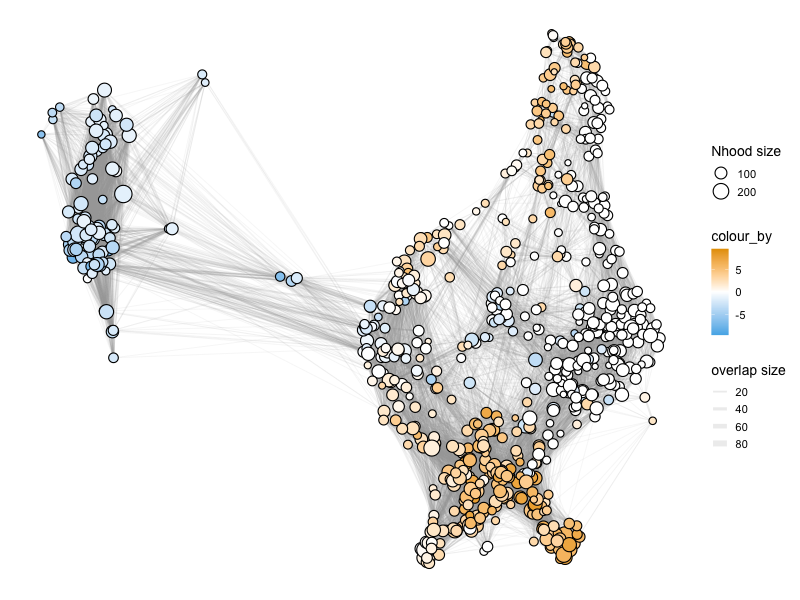

In [49]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_RIIWT, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LV_RII_WT.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [34]:
DA_results_RIIWT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,2.532799,10.753338,13.362731,2.601736e-04,1.037941e-03,1.0,1.624662e-03,11_Proliferating,0.916667
2,0.000000,10.230827,0.000000,1.000000e+00,1.000000e+00,2.0,1.000000e+00,11_Proliferating,1.000000
3,3.737494,10.688157,2.933516,8.684056e-02,1.846160e-01,3.0,2.263349e-01,11_Proliferating,1.000000
4,7.278041,10.409254,38.245457,6.903523e-10,1.084428e-08,4.0,2.702081e-08,06_Th1,0.976744
5,3.736926,10.630363,2.932019,8.692107e-02,1.846160e-01,5.0,2.263349e-01,08_TEM_like_Th1,0.851852
...,...,...,...,...,...,...,...,...,...
750,0.430768,10.862469,0.052478,8.188184e-01,1.000000e+00,750.0,1.000000e+00,04_Precursor_Th1,0.835821
751,-3.904921,10.736176,27.273316,1.861797e-07,1.559772e-06,751.0,3.050588e-06,01_Naive,0.949153
752,-4.063426,11.954778,84.699704,5.611391e-20,8.461978e-18,752.0,3.031896e-17,01_Naive,0.938650
753,-1.918018,10.754854,9.328670,2.271722e-03,7.257960e-03,753.0,1.066186e-02,00_Naive_Trbv,0.733333


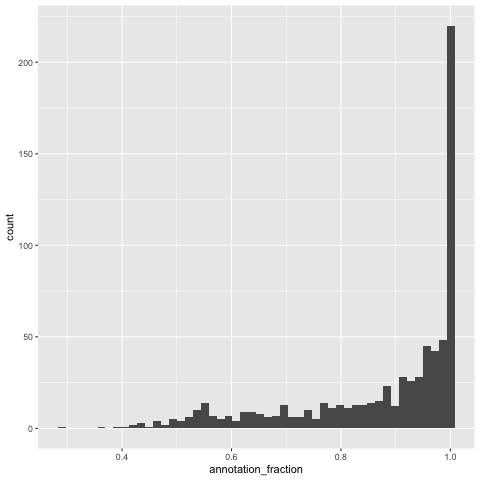

In [269]:
%%R
library(ggplot2)
ggplot(DA_results_RIIWT, aes(annotation_fraction)) + geom_histogram(bins=50)

In [35]:
%%R -o DA_results_RIIWT
DA_results_RIIWT$annotation <- ifelse(DA_results_RIIWT$annotation_fraction < 0.5, "Mixed", DA_results_RIIWT$annotation)
print(class(DA_results_RIIWT))

[1] "data.frame"


In [271]:
DA_results_RIIWT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,5.562714,10.827767,11.018256,9.110078e-04,0.003210,1.0,0.004729,08_TEM_like_Th1,1.000000
2,0.000000,11.679936,0.000000,1.000000e+00,1.000000,2.0,1.000000,07_TRM_like_Th1,1.000000
3,4.799683,10.703759,25.315976,5.100331e-07,0.000004,3.0,0.000007,08_TEM_like_Th1,1.000000
4,-2.777194,11.574280,27.137226,1.999531e-07,0.000002,4.0,0.000003,01_Naive,0.909836
5,0.000000,10.911657,0.000000,1.000000e+00,1.000000,5.0,1.000000,11_Proliferating,1.000000
...,...,...,...,...,...,...,...,...,...
729,-3.173636,10.749111,1.512217,2.188800e-01,0.410330,729.0,0.484631,08_TEM_like_Th1,1.000000
730,-1.187446,10.668247,4.059283,4.400204e-02,0.108965,730.0,0.139007,01_Naive,0.892857
731,3.742173,10.683331,10.514035,1.195329e-03,0.004094,731.0,0.006019,06_Th1,0.736842
732,0.000000,10.396901,0.000000,1.000000e+00,1.000000,732.0,1.000000,07_TRM_like_Th1,0.909091


In [ ]:
%%R -o DA_results_RIIWT
load("intermediate/milo_LV_RII_WT_df.RData")

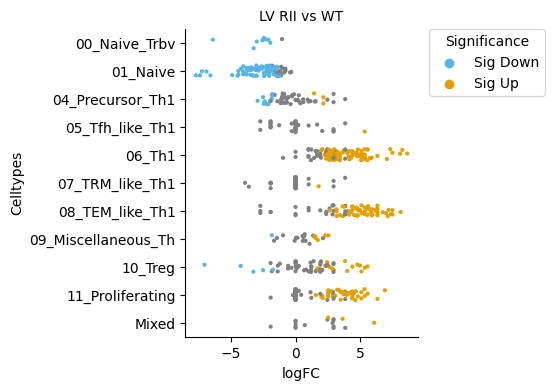

In [ ]:
plot_diff_analysis_results(DA_results_RIIWT, title = 'LV RII vs WT',outbase='figures/')

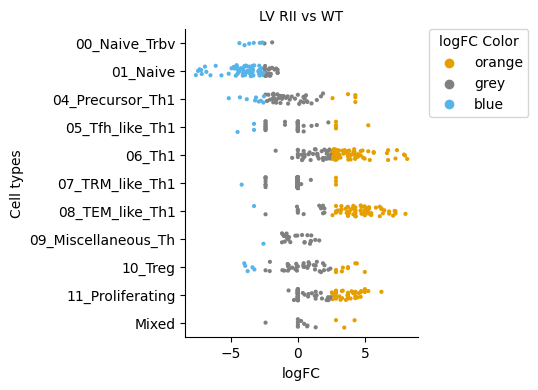

In [ ]:
plot_diff_analysis_results_fc(DA_results_RIIWT, title = 'LV RII vs WT',outbase='figures/', logFC_cut=2.5)

##### PD1 vs WT

In [36]:
%%R -i design_df -o DA_results_PD1WT
contrast.1 <- c("genotypePD1 - genotypeWT")

## Test for differential abundance
DA_results_PD1WT <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_PD1WT <- annotateNhoods(r_milo, DA_results_PD1WT, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


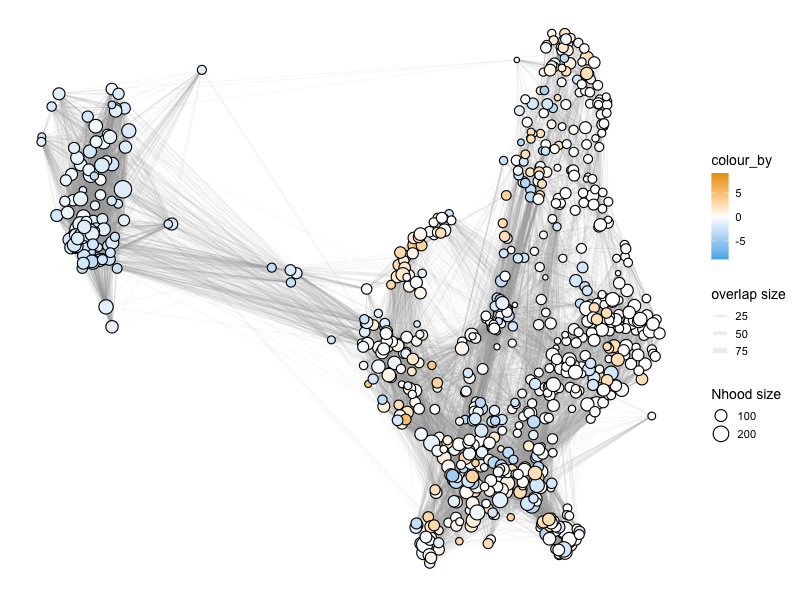

In [317]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_PD1WT, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LV_PD1_WT.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [148]:
DA_results_PD1WT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-1.712878,10.538527,5.830896,0.015795,0.137744,1.0,0.173811,01_Naive,0.940000
2,-0.782706,11.797014,4.376195,0.036511,0.251225,2.0,0.307913,01_Naive,0.838926
3,2.587707,11.691436,1.761585,0.184508,0.646323,3.0,0.675940,11_Proliferating,1.000000
4,0.000000,11.052620,0.000000,1.000000,1.000000,4.0,1.000000,07_TRM_like_Th1,0.560976
5,-1.810861,11.458304,15.951634,0.000066,0.002160,5.0,0.003157,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,0.000000,11.477050,0.000000,1.000000,1.000000,746.0,1.000000,07_TRM_like_Th1,1.000000
747,0.000000,11.237203,0.000000,1.000000,1.000000,747.0,1.000000,07_TRM_like_Th1,1.000000
748,0.000000,10.800646,0.000000,1.000000,1.000000,748.0,1.000000,11_Proliferating,1.000000
749,-0.543569,11.491182,1.793626,0.180566,0.646323,749.0,0.675940,01_Naive,0.879310


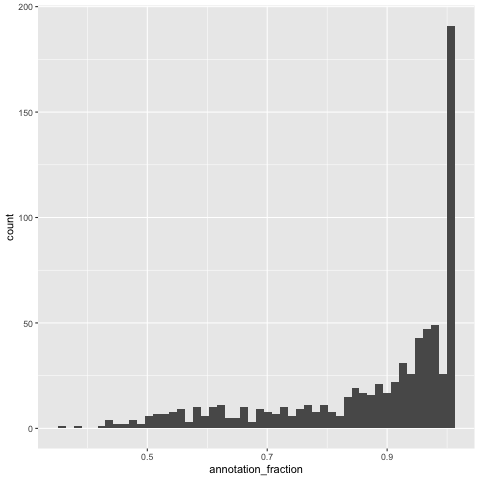

In [149]:
%%R
library(ggplot2)
ggplot(DA_results_PD1WT, aes(annotation_fraction)) + geom_histogram(bins=50)

In [38]:
%%R -o DA_results_PD1WT
DA_results_PD1WT$annotation <- ifelse(DA_results_PD1WT$annotation_fraction < 0.5, "Mixed", DA_results_PD1WT$annotation)

save(DA_results_PD1WT, file = "intermediate/milo_LV_PD1_WT_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [151]:
DA_results_PD1WT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-1.712878,10.538527,5.830896,0.015795,0.137744,1.0,0.173811,01_Naive,0.940000
2,-0.782706,11.797014,4.376195,0.036511,0.251225,2.0,0.307913,01_Naive,0.838926
3,2.587707,11.691436,1.761585,0.184508,0.646323,3.0,0.675940,11_Proliferating,1.000000
4,0.000000,11.052620,0.000000,1.000000,1.000000,4.0,1.000000,07_TRM_like_Th1,0.560976
5,-1.810861,11.458304,15.951634,0.000066,0.002160,5.0,0.003157,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,0.000000,11.477050,0.000000,1.000000,1.000000,746.0,1.000000,07_TRM_like_Th1,1.000000
747,0.000000,11.237203,0.000000,1.000000,1.000000,747.0,1.000000,07_TRM_like_Th1,1.000000
748,0.000000,10.800646,0.000000,1.000000,1.000000,748.0,1.000000,11_Proliferating,1.000000
749,-0.543569,11.491182,1.793626,0.180566,0.646323,749.0,0.675940,01_Naive,0.879310


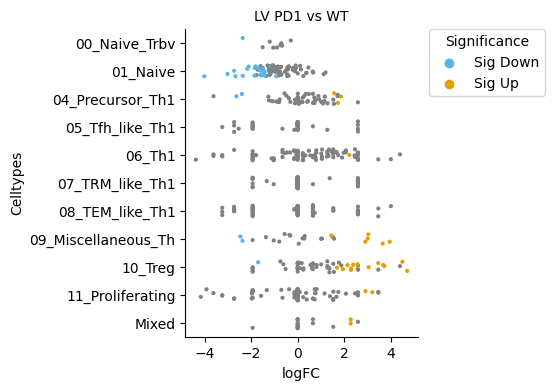

In [154]:
plot_diff_analysis_results(DA_results_PD1WT, title = 'LV PD1 vs WT', outbase='figures/')

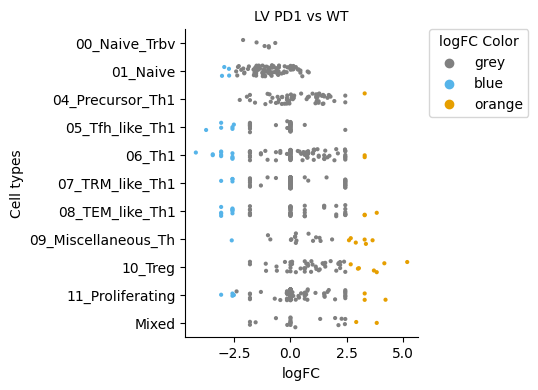

In [52]:
plot_diff_analysis_results_fc(DA_results_PD1WT, title = 'LV PD1 vs WT', outbase='figures/')

##### 2KO vs RII

In [39]:
%%R -i design_df -o DA_results_2KORII
contrast.1 <- c("genotype2KO - genotypeRII")

## Test for differential abundance
DA_results_2KORII <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_2KORII <- annotateNhoods(r_milo, DA_results_2KORII, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


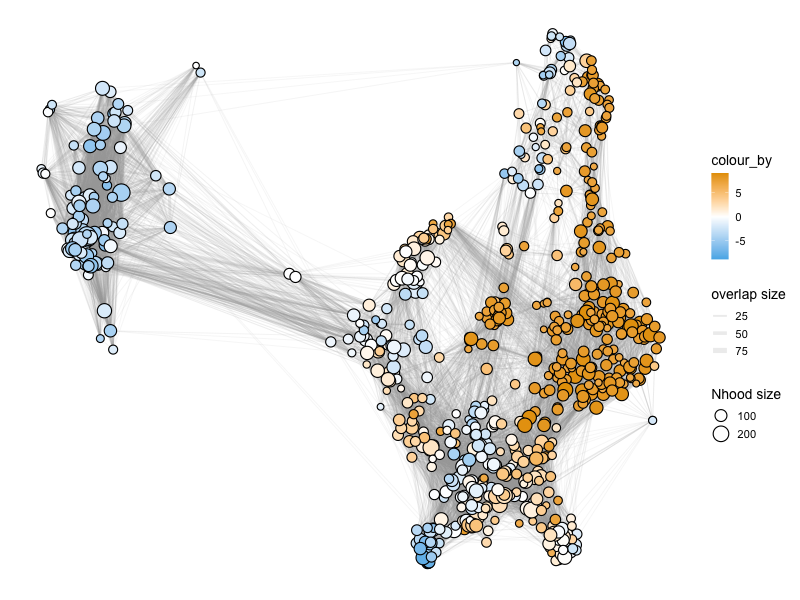

In [273]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_2KORII, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LV_2KO_RII.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [160]:
DA_results_2KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-4.048163,10.538527,12.918296,3.295707e-04,5.734989e-04,1.0,5.356687e-04,01_Naive,0.940000
2,-2.158360,11.797014,8.679672,3.237598e-03,4.996294e-03,2.0,4.798857e-03,01_Naive,0.838926
3,3.484458,11.691436,43.008237,6.195489e-11,4.891175e-10,3.0,7.925286e-10,11_Proliferating,1.000000
4,4.994050,11.052620,35.437482,2.875520e-09,1.261193e-08,4.0,1.650418e-08,07_TRM_like_Th1,0.560976
5,-4.401647,11.458304,5.832503,1.578027e-02,2.233057e-02,5.0,2.171962e-02,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,8.516804,11.477050,62.891312,2.858638e-15,7.146594e-14,746.0,1.495072e-13,07_TRM_like_Th1,1.000000
747,8.243064,11.237203,51.939565,6.886838e-13,8.070514e-12,747.0,1.467935e-11,07_TRM_like_Th1,1.000000
748,7.686633,10.800646,38.125022,7.342408e-10,3.797797e-09,748.0,5.303395e-09,11_Proliferating,1.000000
749,-2.515547,11.491182,11.220406,8.170217e-04,1.361703e-03,749.0,1.295640e-03,01_Naive,0.879310


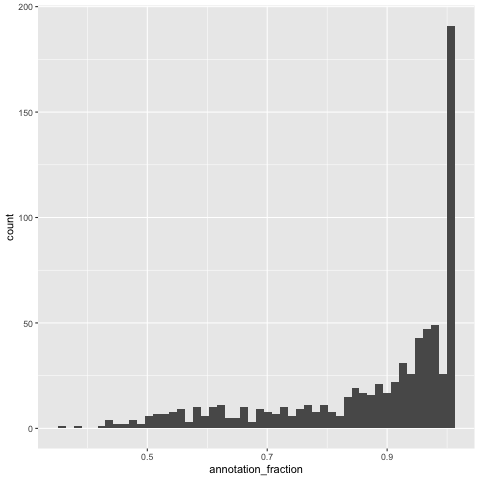

In [162]:
%%R
library(ggplot2)
ggplot(DA_results_2KORII, aes(annotation_fraction)) + geom_histogram(bins=50)

In [41]:
%%R -o DA_results_2KORII
DA_results_2KORII$annotation <- ifelse(DA_results_2KORII$annotation_fraction < 0.5, "Mixed", DA_results_2KORII$annotation)

save(DA_results_2KORII, file = "intermediate/milo_LV_2KO_RII_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [164]:
DA_results_2KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-4.048163,10.538527,12.918296,3.295707e-04,5.734989e-04,1.0,5.356687e-04,01_Naive,0.940000
2,-2.158360,11.797014,8.679672,3.237598e-03,4.996294e-03,2.0,4.798857e-03,01_Naive,0.838926
3,3.484458,11.691436,43.008237,6.195489e-11,4.891175e-10,3.0,7.925286e-10,11_Proliferating,1.000000
4,4.994050,11.052620,35.437482,2.875520e-09,1.261193e-08,4.0,1.650418e-08,07_TRM_like_Th1,0.560976
5,-4.401647,11.458304,5.832503,1.578027e-02,2.233057e-02,5.0,2.171962e-02,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,8.516804,11.477050,62.891312,2.858638e-15,7.146594e-14,746.0,1.495072e-13,07_TRM_like_Th1,1.000000
747,8.243064,11.237203,51.939565,6.886838e-13,8.070514e-12,747.0,1.467935e-11,07_TRM_like_Th1,1.000000
748,7.686633,10.800646,38.125022,7.342408e-10,3.797797e-09,748.0,5.303395e-09,11_Proliferating,1.000000
749,-2.515547,11.491182,11.220406,8.170217e-04,1.361703e-03,749.0,1.295640e-03,01_Naive,0.879310


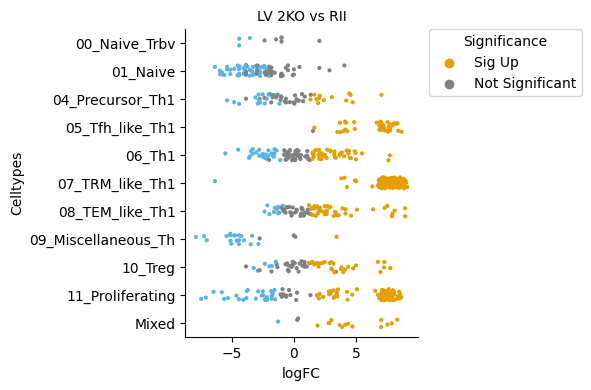

In [165]:
plot_diff_analysis_results(DA_results_2KORII, title = 'LV 2KO vs RII',outbase='figures/')

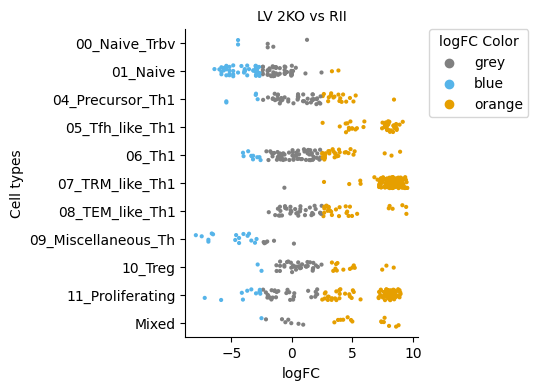

In [53]:
plot_diff_analysis_results_fc(DA_results_2KORII, title = 'LV 2KO vs RII',outbase='figures/')

##### 2KO vs PD1

In [42]:
%%R -i design_df -o DA_results_2KOPD1
contrast.1 <- c("genotype2KO - genotypePD1")

## Test for differential abundance
DA_results_2KOPD1 <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_2KOPD1 <- annotateNhoods(r_milo, DA_results_2KOPD1, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


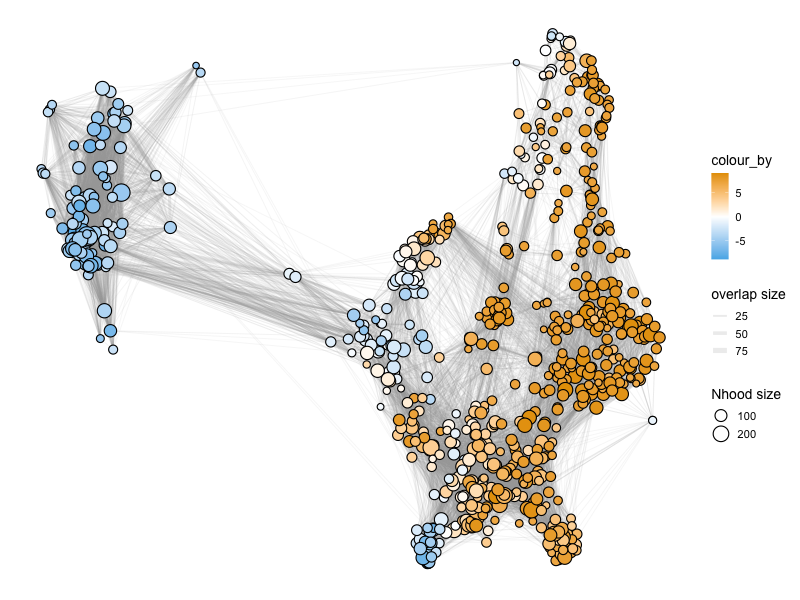

In [274]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_2KOPD1, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LV_2KO_PD1.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [170]:
DA_results_2KOPD1

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-2.662345,10.538527,3.978971,4.614396e-02,5.251589e-02,1.0,5.338819e-02,01_Naive,0.940000
2,-2.837339,11.797014,21.447493,3.759846e-06,5.974331e-06,2.0,6.304664e-06,01_Naive,0.838926
3,6.007818,11.691436,74.900035,7.232869e-18,1.390936e-16,3.0,3.187693e-16,11_Proliferating,1.000000
4,7.941095,11.052620,51.999477,6.682668e-13,3.977779e-12,4.0,7.162371e-12,07_TRM_like_Th1,0.560976
5,-6.048037,11.458304,20.476602,6.223583e-06,9.683998e-06,5.0,1.028906e-05,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,8.516804,11.477050,77.606199,1.888087e-18,4.425203e-17,746.0,1.030325e-16,07_TRM_like_Th1,1.000000
747,8.243064,11.237203,64.296690,1.417409e-15,1.417409e-14,747.0,2.943101e-14,07_TRM_like_Th1,1.000000
748,7.686633,10.800646,47.396753,6.768137e-12,2.731281e-11,748.0,4.146300e-11,11_Proliferating,1.000000
749,-2.926936,11.491182,19.794458,8.873552e-06,1.363763e-05,749.0,1.447100e-05,01_Naive,0.879310


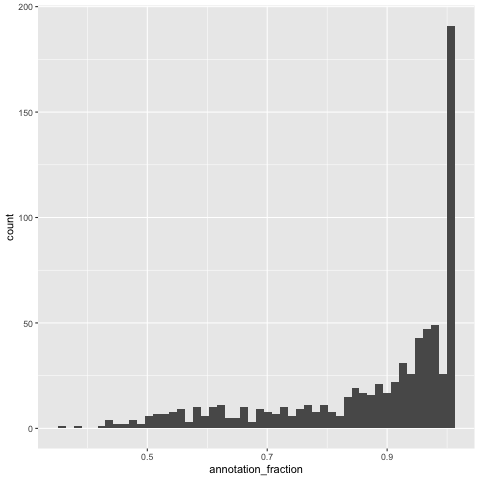

In [171]:
%%R
library(ggplot2)
ggplot(DA_results_2KOPD1, aes(annotation_fraction)) + geom_histogram(bins=50)

In [43]:
%%R -o DA_results_2KOPD1
DA_results_2KOPD1$annotation <- ifelse(DA_results_2KOPD1$annotation_fraction < 0.5, "Mixed", DA_results_2KOPD1$annotation)

save(DA_results_2KOPD1, file = "intermediate/milo_LV_2KO_PD1_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [173]:
DA_results_2KOPD1

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-2.662345,10.538527,3.978971,4.614396e-02,5.251589e-02,1.0,5.338819e-02,01_Naive,0.940000
2,-2.837339,11.797014,21.447493,3.759846e-06,5.974331e-06,2.0,6.304664e-06,01_Naive,0.838926
3,6.007818,11.691436,74.900035,7.232869e-18,1.390936e-16,3.0,3.187693e-16,11_Proliferating,1.000000
4,7.941095,11.052620,51.999477,6.682668e-13,3.977779e-12,4.0,7.162371e-12,07_TRM_like_Th1,0.560976
5,-6.048037,11.458304,20.476602,6.223583e-06,9.683998e-06,5.0,1.028906e-05,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,8.516804,11.477050,77.606199,1.888087e-18,4.425203e-17,746.0,1.030325e-16,07_TRM_like_Th1,1.000000
747,8.243064,11.237203,64.296690,1.417409e-15,1.417409e-14,747.0,2.943101e-14,07_TRM_like_Th1,1.000000
748,7.686633,10.800646,47.396753,6.768137e-12,2.731281e-11,748.0,4.146300e-11,11_Proliferating,1.000000
749,-2.926936,11.491182,19.794458,8.873552e-06,1.363763e-05,749.0,1.447100e-05,01_Naive,0.879310


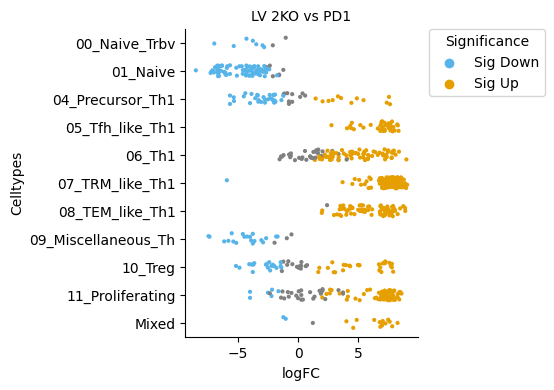

In [175]:
plot_diff_analysis_results(DA_results_2KOPD1, title = 'LV 2KO vs PD1',outbase='figures/')

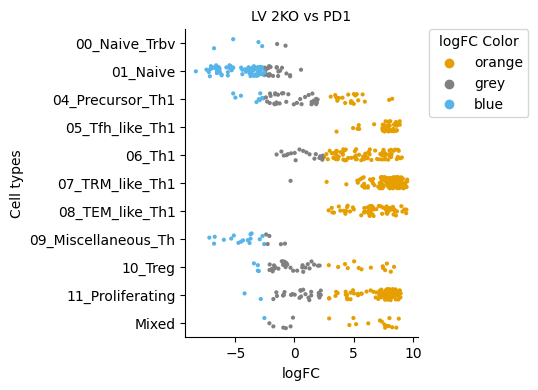

In [54]:
plot_diff_analysis_results_fc(DA_results_2KOPD1, title = 'LV 2KO vs PD1',outbase='figures/')

##### 3KO vs 2KO

In [44]:
%%R -i design_df -o DA_results_3KO2KO
contrast.1 <- c("genotype3KO - genotype2KO")

## Test for differential abundance
DA_results_3KO2KO <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_3KO2KO <- annotateNhoods(r_milo, DA_results_3KO2KO, coldata_col = "annotation")


R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


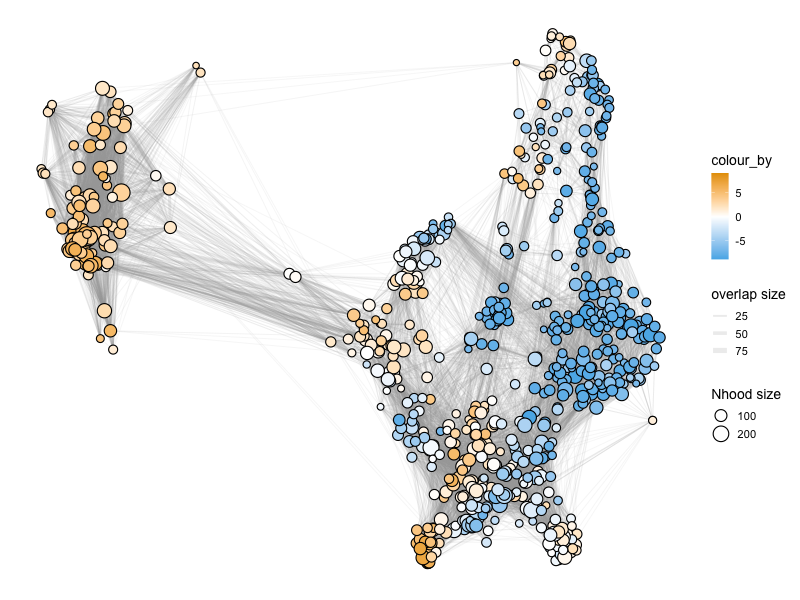

In [275]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_3KO2KO, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LV_3KO_2KO.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [179]:
DA_results_3KO2KO

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,2.181436,10.538527,2.425957,1.194247e-01,1.382231e-01,1.0,1.418116e-01,01_Naive,0.940000
2,1.856212,11.797014,7.067697,7.881943e-03,1.049992e-02,2.0,1.062868e-02,01_Naive,0.838926
3,-3.096827,11.691436,49.731422,2.089620e-12,1.037891e-11,3.0,1.483100e-11,11_Proliferating,1.000000
4,-4.642265,11.052620,45.189684,2.059240e-11,8.393641e-11,4.0,1.133914e-10,07_TRM_like_Th1,0.560976
5,6.251746,11.458304,24.412758,8.114848e-07,1.658348e-06,5.0,1.657397e-06,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,-5.218632,11.477050,71.538316,3.844534e-17,5.653727e-16,746.0,1.126892e-15,07_TRM_like_Th1,1.000000
747,-8.243064,11.237203,70.267693,7.233568e-17,1.004662e-15,747.0,1.987512e-15,07_TRM_like_Th1,1.000000
748,-7.686633,10.800646,51.892028,7.053272e-13,3.833300e-12,748.0,5.609109e-12,11_Proliferating,1.000000
749,0.943813,11.491182,1.138213,2.860990e-01,3.105271e-01,749.0,3.133791e-01,01_Naive,0.879310


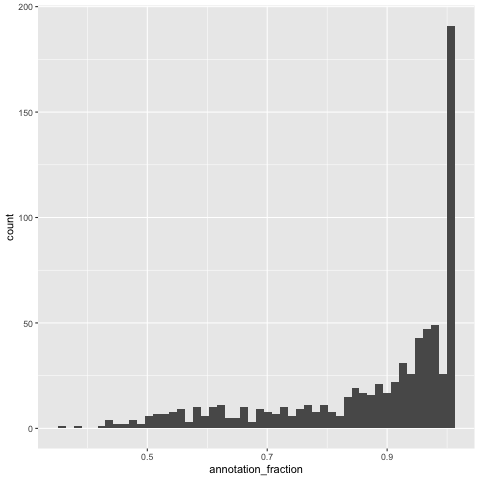

In [180]:
%%R
library(ggplot2)
ggplot(DA_results_3KO2KO, aes(annotation_fraction)) + geom_histogram(bins=50)

In [45]:
%%R -o DA_results_3KO2KO
DA_results_3KO2KO$annotation <- ifelse(DA_results_3KO2KO$annotation_fraction < 0.5, "Mixed", DA_results_3KO2KO$annotation)

save(DA_results_3KO2KO, file = "intermediate/milo_LV_3KO2KO_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [182]:
DA_results_3KO2KO

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,2.181436,10.538527,2.425957,1.194247e-01,1.382231e-01,1.0,1.418116e-01,01_Naive,0.940000
2,1.856212,11.797014,7.067697,7.881943e-03,1.049992e-02,2.0,1.062868e-02,01_Naive,0.838926
3,-3.096827,11.691436,49.731422,2.089620e-12,1.037891e-11,3.0,1.483100e-11,11_Proliferating,1.000000
4,-4.642265,11.052620,45.189684,2.059240e-11,8.393641e-11,4.0,1.133914e-10,07_TRM_like_Th1,0.560976
5,6.251746,11.458304,24.412758,8.114848e-07,1.658348e-06,5.0,1.657397e-06,01_Naive,0.939130
...,...,...,...,...,...,...,...,...,...
746,-5.218632,11.477050,71.538316,3.844534e-17,5.653727e-16,746.0,1.126892e-15,07_TRM_like_Th1,1.000000
747,-8.243064,11.237203,70.267693,7.233568e-17,1.004662e-15,747.0,1.987512e-15,07_TRM_like_Th1,1.000000
748,-7.686633,10.800646,51.892028,7.053272e-13,3.833300e-12,748.0,5.609109e-12,11_Proliferating,1.000000
749,0.943813,11.491182,1.138213,2.860990e-01,3.105271e-01,749.0,3.133791e-01,01_Naive,0.879310


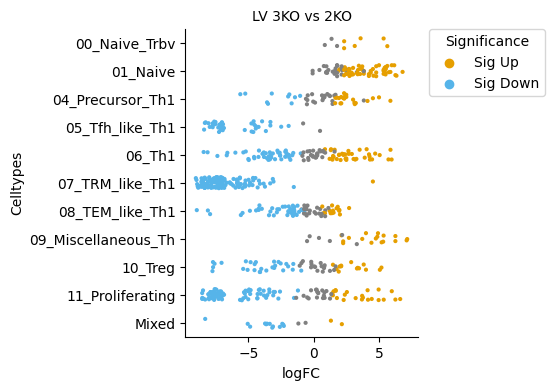

In [183]:
plot_diff_analysis_results(DA_results_3KO2KO, title = 'LV 3KO vs 2KO',outbase='figures/')

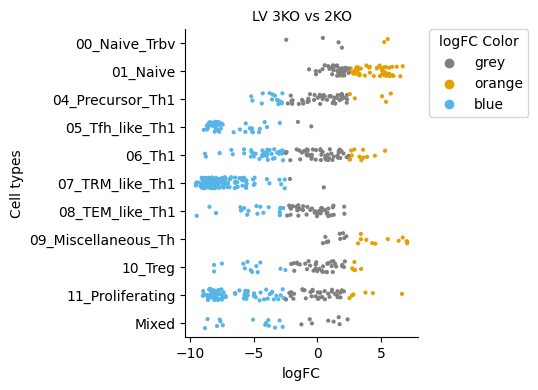

In [55]:
plot_diff_analysis_results_fc(DA_results_3KO2KO, title = 'LV 3KO vs 2KO',outbase='figures/')

##### 3KO vs RII

In [46]:
%%R -i design_df -o DA_results_3KORII
contrast.1 <- c("genotype3KO - genotypeRII")

## Test for differential abundance
DA_results_3KORII <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_3KORII <- annotateNhoods(r_milo, DA_results_3KORII, coldata_col = "annotation")


R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


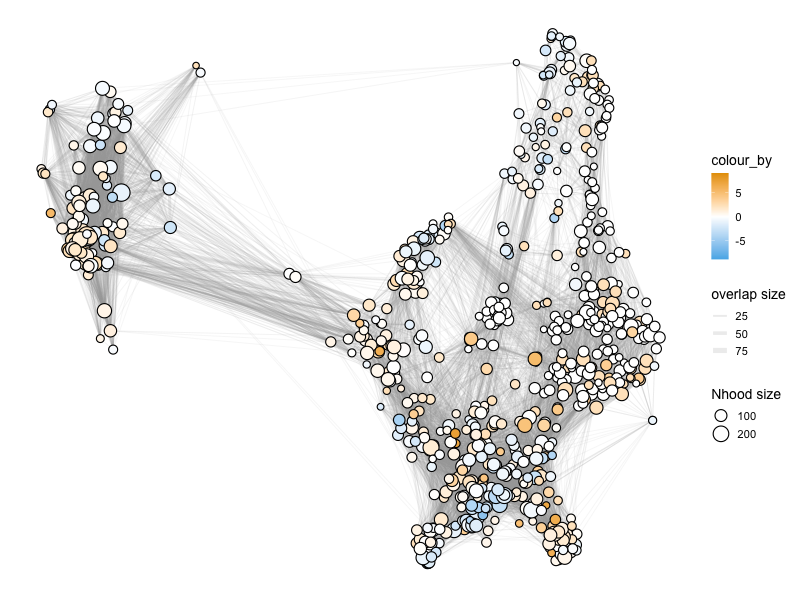

In [277]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_3KORII, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LV_3KO_RII.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [278]:
DA_results_3KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,0.543539,10.827767,0.606597,0.436122,0.828180,1.0,0.913358,08_TEM_like_Th1,1.000000
2,2.254349,11.679936,0.754954,0.384969,0.772867,2.0,0.850822,07_TRM_like_Th1,1.000000
3,-0.609968,10.703759,1.419850,0.233505,0.654600,3.0,0.774940,08_TEM_like_Th1,1.000000
4,0.593127,11.574280,0.647472,0.421070,0.801674,4.0,0.884240,01_Naive,0.909836
5,2.254169,10.911657,0.756015,0.384635,0.772867,5.0,0.850822,11_Proliferating,1.000000
...,...,...,...,...,...,...,...,...,...
729,3.094581,10.749111,1.439202,0.230346,0.654600,729.0,0.774940,08_TEM_like_Th1,1.000000
730,-1.607221,10.668247,3.402432,0.065181,0.320656,730.0,0.406194,01_Naive,0.892857
731,1.213902,10.683331,4.787944,0.028723,0.189963,731.0,0.243732,06_Th1,0.736842
732,0.000000,10.396901,0.000000,1.000000,1.000000,732.0,1.000000,07_TRM_like_Th1,0.909091


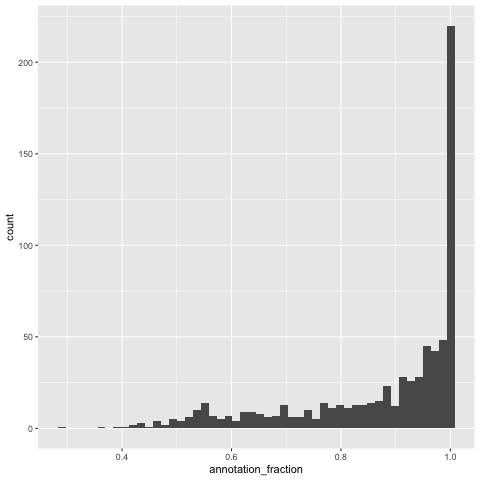

In [279]:
%%R
library(ggplot2)
ggplot(DA_results_3KORII, aes(annotation_fraction)) + geom_histogram(bins=50)

In [47]:
%%R -o DA_results_3KORII
DA_results_3KORII$annotation <- ifelse(DA_results_3KORII$annotation_fraction < 0.5, "Mixed", DA_results_3KORII$annotation)

save(DA_results_3KORII, file = "intermediate/milo_LV_3KO_RII_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [281]:
DA_results_3KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,0.543539,10.827767,0.606597,0.436122,0.828180,1.0,0.913358,08_TEM_like_Th1,1.000000
2,2.254349,11.679936,0.754954,0.384969,0.772867,2.0,0.850822,07_TRM_like_Th1,1.000000
3,-0.609968,10.703759,1.419850,0.233505,0.654600,3.0,0.774940,08_TEM_like_Th1,1.000000
4,0.593127,11.574280,0.647472,0.421070,0.801674,4.0,0.884240,01_Naive,0.909836
5,2.254169,10.911657,0.756015,0.384635,0.772867,5.0,0.850822,11_Proliferating,1.000000
...,...,...,...,...,...,...,...,...,...
729,3.094581,10.749111,1.439202,0.230346,0.654600,729.0,0.774940,08_TEM_like_Th1,1.000000
730,-1.607221,10.668247,3.402432,0.065181,0.320656,730.0,0.406194,01_Naive,0.892857
731,1.213902,10.683331,4.787944,0.028723,0.189963,731.0,0.243732,06_Th1,0.736842
732,0.000000,10.396901,0.000000,1.000000,1.000000,732.0,1.000000,07_TRM_like_Th1,0.909091


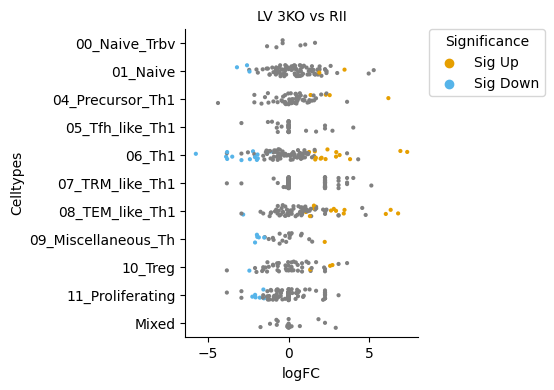

In [282]:
plot_diff_analysis_results(DA_results_3KORII, title = 'LV 3KO vs RII',outbase='figures/')

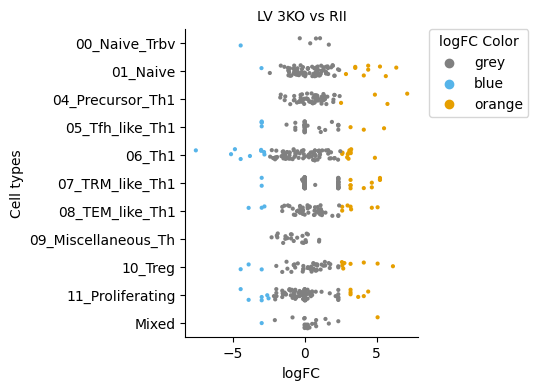

In [56]:
plot_diff_analysis_results_fc(DA_results_3KORII, title = 'LV 3KO vs RII',outbase='figures/')

### adata_LN

In [184]:
%%R -i adata_LN_milo
save(adata_LN_milo, file = "intermediate/00_adata_LN_milo.RData")

# the anndata2ri packages will convert the anndata object into SingleCellExperiment object 
# (for more details see here: https://bioconductor.org/packages/release/bioc/html/SingleCellExperiment.html)
# kernel migth die, be prepared
# take long, 10+ min

In [57]:
%%R
load("intermediate/00_adata_LN_milo.RData")

In [58]:
%%R 
r_milo <- Milo(adata_LN_milo) # convert to a Milo object
r_milo

class: Milo 
dim: 16096 15518 
metadata(19): airr:clonal_expansion_colors annotation_1.4_colors ...
  wilcoxon_1.4 wilcoxon_anno
assays(4): X norm_counts raw_data zs_norm_log
rownames(16096): Xkr4 Mrpl15 ... CAAA01147332.1 AC149090.1
rowData names(12): n_cells_by_counts mean_counts ... variances
  variances_norm
colnames(15518): AAACCTGAGTGTGAAT-1 AAACCTGCAAATTGCC-1 ...
  TTTGTCACATGGGAAC-1 TTTGTCATCTCGCATC-1
colData names(24): hash n_genes_by_counts ... genotype_milo indices
reducedDimNames(3): X_draw_graph_fa PCA UMAP
mainExpName: NULL
altExpNames(0):
nhoods dimensions(2): 1 1
nhoodCounts dimensions(2): 1 1
nhoodDistances dimension(1): 0
graph names(0):
nhoodIndex names(1): 0
nhoodExpression dimension(2): 1 1
nhoodReducedDim names(0):
nhoodGraph names(0):
nhoodAdjacency dimension(2): 1 1


In [59]:
%%R 
r_milo <- buildGraph(r_milo, k=30, d=30, reduced.dim = "PCA") # build a graph in the milo object

R[write to console]: Constructing kNN graph with k:30



In [60]:
%%R 
## Define neighbourhoods
r_milo <- makeNhoods(r_milo, prop = 0.05, k = 30, d=30, refined = TRUE, reduced_dims = "PCA")
## Count cells in neighbourhoods
r_milo <- countCells(r_milo, meta.data = data.frame(colData(r_milo)), sample="genotype_milo")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
r_milo <- calcNhoodDistance(r_milo, d=30, reduced.dim = "PCA")

R[write to console]: Checking valid object

R[write to console]: Running refined sampling with reduced_dim

R[write to console]: Checking meta.data validity

R[write to console]: Counting cells in neighbourhoods



##### save rmilo

In [61]:
%%R
saveRDS(r_milo, file = "intermediate/r_milo_LN_object.RData")

#load("")

In [294]:
%%R
## ensure the color scale for plot is the same across all comparisons
global_min_logFC <- min(DA_results_RIIWT$logFC,DA_results_PD1WT$logFC, DA_results_2KORII$logFC, DA_results_2KOPD1$logFC, DA_results_3KO2KO$logFC, DA_results_3KORII$logFC)
global_max_logFC <- max(DA_results_RIIWT$logFC,DA_results_PD1WT$logFC, DA_results_2KORII$logFC, DA_results_2KOPD1$logFC, DA_results_3KO2KO$logFC, DA_results_3KORII$logFC)

print(global_min_logFC)
print(global_max_logFC)

[1] -7.91337
[1] 8.91916


In [68]:
%%R
global_min_logFC <- -7.91337
global_max_logFC <- 8.91916

##### RII vs WT

In [62]:
%%R -i design_df -o DA_results_RIIWT
contrast.1 <- c("genotypeRII - genotypeWT")

## Test for differential abundance
DA_results_RIIWT <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_RIIWT <- annotateNhoods(r_milo, DA_results_RIIWT, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


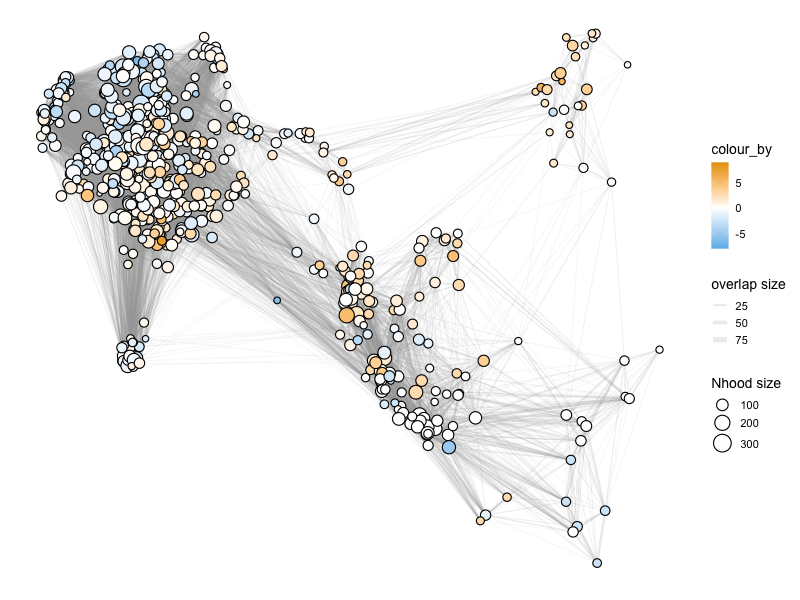

In [227]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_RIIWT, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LN_RII_WT.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [228]:
DA_results_RIIWT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,1.347005,10.063444,1.148959,0.283848,0.512039,1.0,0.539721,11_Proliferating,0.918919
2,-0.668179,10.930922,1.503318,0.220251,0.460525,2.0,0.514023,01_Naive,1.000000
3,0.101335,10.063043,0.004348,0.947430,1.000000,3.0,1.000000,01_Naive,1.000000
4,1.597584,11.360897,17.115168,0.000036,0.000558,4.0,0.000835,01_Naive,0.808333
5,1.911025,10.859066,2.114735,0.145985,0.344374,5.0,0.391739,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,1.471149,10.319244,6.999015,0.008195,0.039982,640.0,0.050771,01_Naive,0.958333
641,-0.057378,10.479181,0.006097,0.937769,1.000000,641.0,1.000000,01_Naive,1.000000
642,-0.578075,10.534847,0.747890,0.387210,0.602326,642.0,0.625591,01_Naive,0.983051
643,-2.273479,10.497024,3.136922,0.076633,0.222304,643.0,0.260891,01_Naive,0.771930


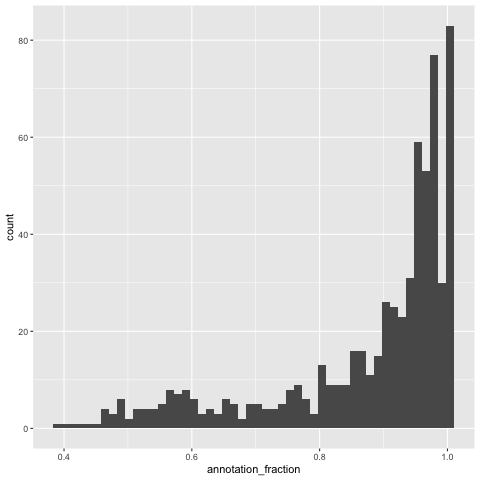

In [229]:
%%R
library(ggplot2)
ggplot(DA_results_RIIWT, aes(annotation_fraction)) + geom_histogram(bins=50)

In [66]:
%%R -o DA_results_RIIWT
DA_results_RIIWT$annotation <- ifelse(DA_results_RIIWT$annotation_fraction < 0.5, "Mixed", DA_results_RIIWT$annotation)

save(DA_results_RIIWT, file = "intermediate/milo_LN_RII_WT_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [81]:
DA_results_RIIWT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-1.855249,11.105134,2.084746,0.148873,0.353505,1.0,0.401954,04_Precursor_Th1,0.686869
2,1.159727,10.883119,7.721247,0.005489,0.030119,2.0,0.037393,00_Naive_Trbv,0.719512
3,0.000000,10.686072,0.000000,1.000000,1.000000,3.0,1.000000,03_Tfh,0.724638
4,-1.367976,11.265798,7.909403,0.004947,0.028589,4.0,0.035259,01_Naive,0.946903
5,1.249289,10.911145,10.319616,0.001329,0.010210,5.0,0.012917,01_Naive,0.630952
...,...,...,...,...,...,...,...,...,...
649,-0.847435,10.360241,0.891375,0.345175,0.577946,649.0,0.618737,00_Naive_Trbv,0.960784
650,4.886809,10.951792,7.736653,0.005442,0.030119,650.0,0.037393,10_Treg,1.000000
651,-0.797151,11.360296,3.117601,0.077544,0.229124,651.0,0.261967,01_Naive,0.795082
652,0.501457,10.897103,1.209462,0.271520,0.508030,652.0,0.555704,00_Naive_Trbv,0.722892


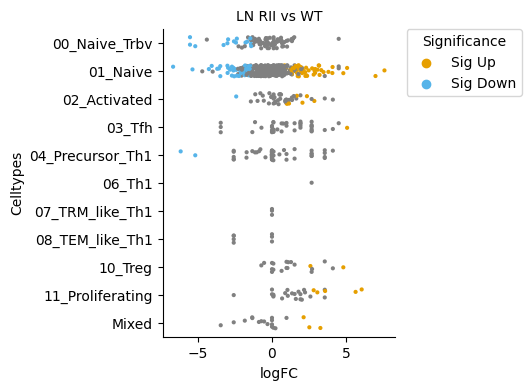

In [232]:
plot_diff_analysis_results(DA_results_RIIWT, title = 'LN RII vs WT',outbase='figures/')

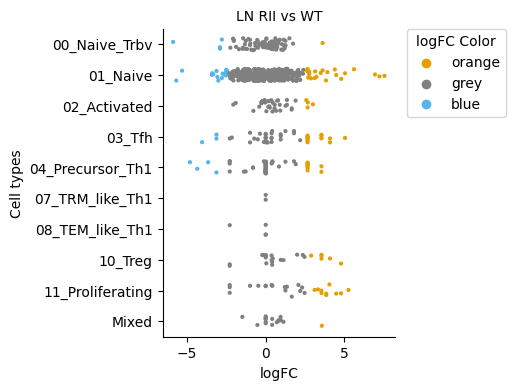

In [75]:
plot_diff_analysis_results_fc(DA_results_RIIWT, title = 'LN RII vs WT',outbase='figures/')

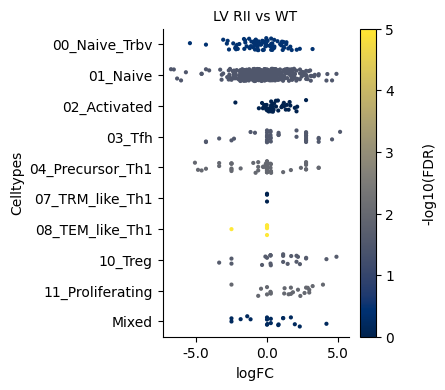

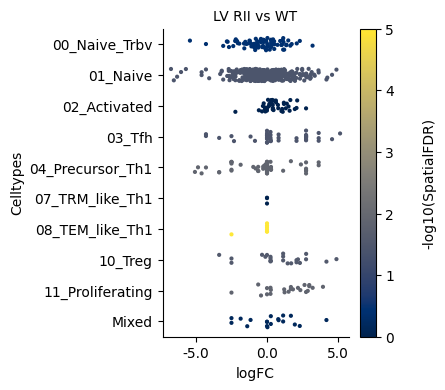

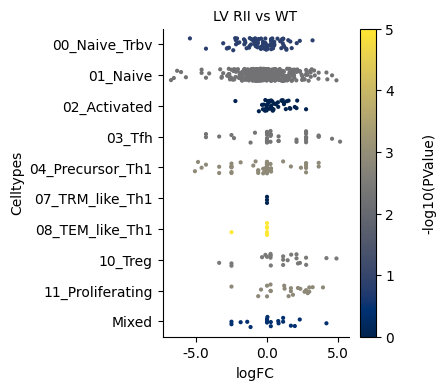

In [104]:
plot_diff_analysis_results_capped(DA_results_RIIWT, title = 'LV RII vs WT',outbase='figures/', vmax=5)

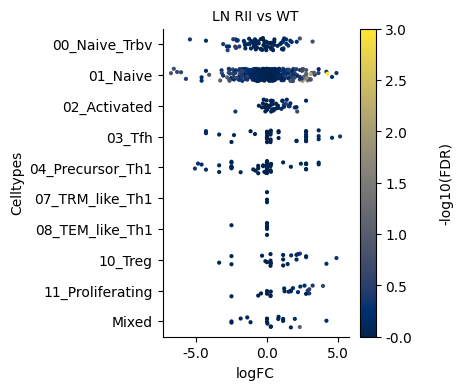

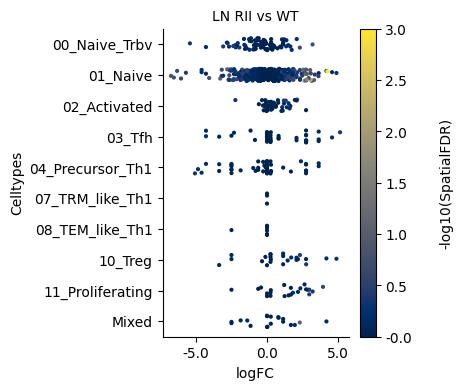

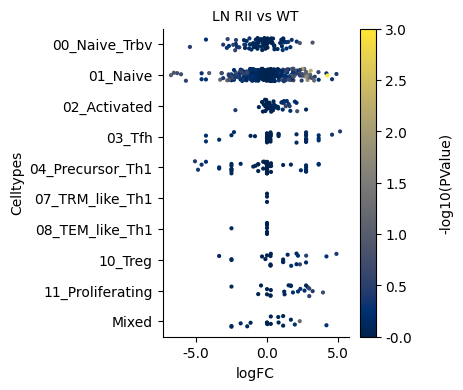

In [98]:
# after scale bar global adjustment
plot_diff_analysis_results_scale(DA_results_RIIWT, title = 'LN RII vs WT', outbase = 'figures/')

##### PD1 vs WT

In [64]:
%%R -i design_df -o DA_results_PD1WT
contrast.1 <- c("genotypePD1 - genotypeWT")

## Test for differential abundance
DA_results_PD1WT <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_PD1WT <- annotateNhoods(r_milo, DA_results_PD1WT, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


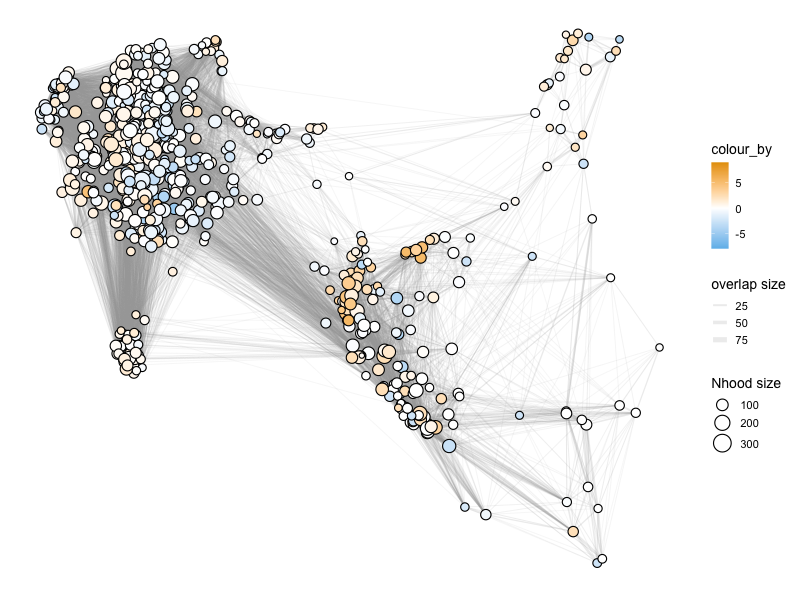

In [70]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_PD1WT, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LN_PD1_WT.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [234]:
DA_results_PD1WT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,1.330022,10.063444,1.208085,0.271794,0.546326,1.0,0.629380,11_Proliferating,0.918919
2,-2.352706,10.930922,11.815389,0.000595,0.025263,2.0,0.056464,01_Naive,1.000000
3,0.771226,10.063043,0.340530,0.559565,0.813453,3.0,0.859864,01_Naive,1.000000
4,-1.233524,11.360897,4.375009,0.036548,0.202903,4.0,0.307116,01_Naive,0.808333
5,1.950456,10.859066,2.403416,0.121169,0.349923,5.0,0.452531,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-1.440336,10.319244,2.759249,0.096791,0.313233,640.0,0.404697,01_Naive,0.958333
641,0.893632,10.479181,2.235708,0.134953,0.366707,641.0,0.470102,01_Naive,1.000000
642,0.036459,10.534847,0.004048,0.949277,1.000000,642.0,1.000000,01_Naive,0.983051
643,0.403665,10.497024,0.265261,0.606564,0.847347,643.0,0.894333,01_Naive,0.771930


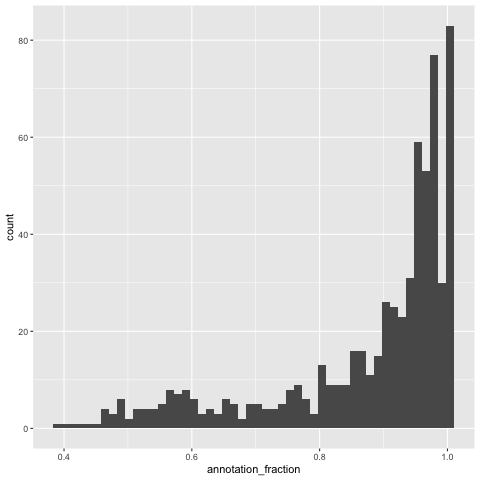

In [235]:
%%R
library(ggplot2)
ggplot(DA_results_PD1WT, aes(annotation_fraction)) + geom_histogram(bins=50)

In [65]:
%%R -o DA_results_PD1WT
DA_results_PD1WT$annotation <- ifelse(DA_results_PD1WT$annotation_fraction < 0.5, "Mixed", DA_results_PD1WT$annotation)

save(DA_results_PD1WT, file = "intermediate/milo_LN_PD1_WT_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [237]:
DA_results_PD1WT

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,1.330022,10.063444,1.208085,0.271794,0.546326,1.0,0.629380,11_Proliferating,0.918919
2,-2.352706,10.930922,11.815389,0.000595,0.025263,2.0,0.056464,01_Naive,1.000000
3,0.771226,10.063043,0.340530,0.559565,0.813453,3.0,0.859864,01_Naive,1.000000
4,-1.233524,11.360897,4.375009,0.036548,0.202903,4.0,0.307116,01_Naive,0.808333
5,1.950456,10.859066,2.403416,0.121169,0.349923,5.0,0.452531,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-1.440336,10.319244,2.759249,0.096791,0.313233,640.0,0.404697,01_Naive,0.958333
641,0.893632,10.479181,2.235708,0.134953,0.366707,641.0,0.470102,01_Naive,1.000000
642,0.036459,10.534847,0.004048,0.949277,1.000000,642.0,1.000000,01_Naive,0.983051
643,0.403665,10.497024,0.265261,0.606564,0.847347,643.0,0.894333,01_Naive,0.771930


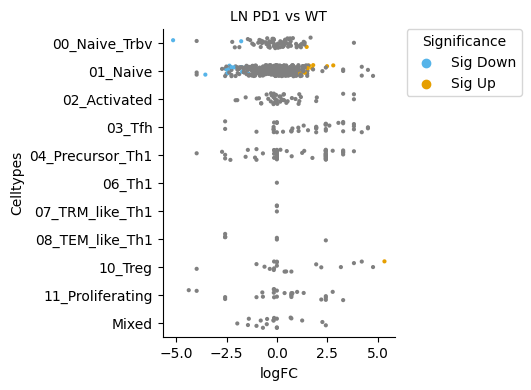

In [238]:
plot_diff_analysis_results(DA_results_PD1WT, title = 'LN PD1 vs WT', outbase='figures/')

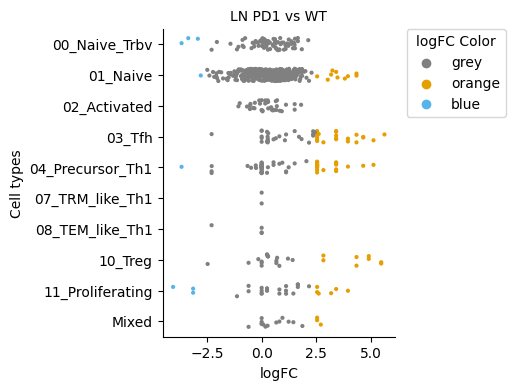

In [76]:
plot_diff_analysis_results_fc(DA_results_PD1WT, title = 'LN PD1 vs WT', outbase='figures/')

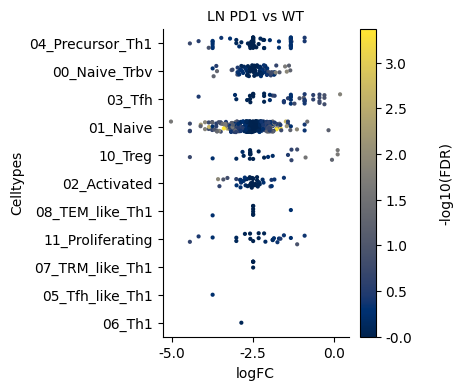

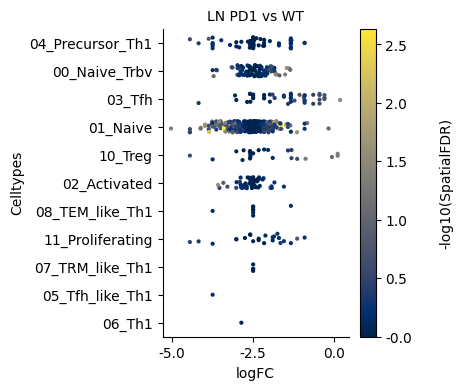

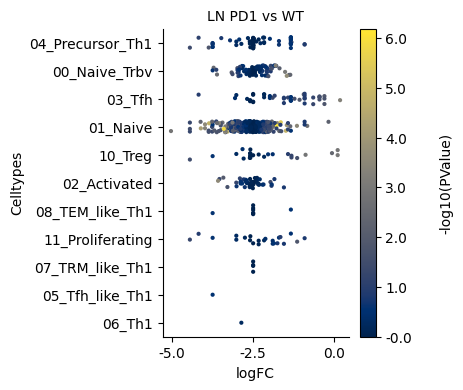

In [78]:
plot_diff_analysis_results_scale(DA_results_PD1WT, title = 'LN PD1 vs WT', outbase = 'figures/')

##### 2KO vs RII

In [67]:
%%R -i design_df -o DA_results_2KORII
contrast.1 <- c("genotype2KO - genotypeRII")

## Test for differential abundance
DA_results_2KORII <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_2KORII <- annotateNhoods(r_milo, DA_results_2KORII, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


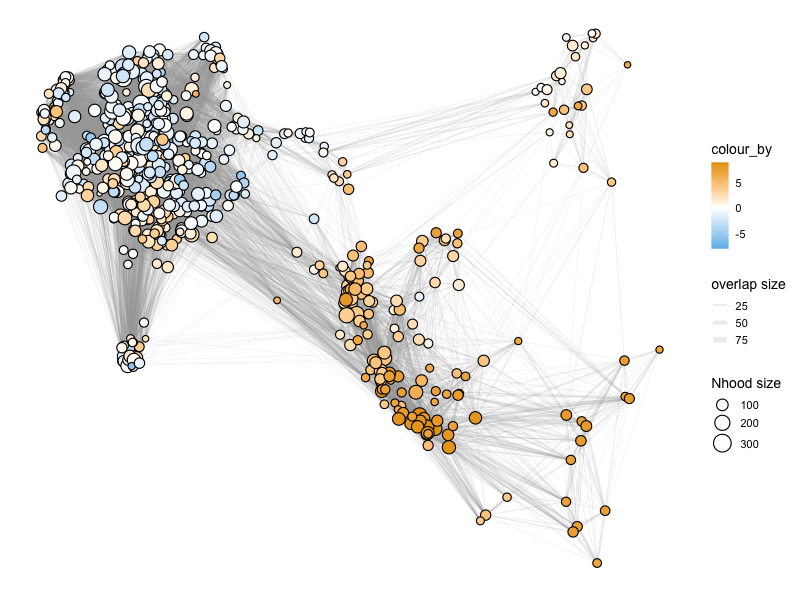

In [239]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_2KORII, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LN_2KO_RII.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [240]:
DA_results_2KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,0.802506,10.063444,0.999473,3.175132e-01,0.384358,1.0,0.382484,11_Proliferating,0.918919
2,0.847000,10.930922,3.105787,7.810939e-02,0.113294,2.0,0.116020,01_Naive,1.000000
3,2.790818,10.063043,9.778447,1.781450e-03,0.003559,3.0,0.003833,01_Naive,1.000000
4,-1.181781,11.360897,13.637825,2.253540e-04,0.000527,4.0,0.000567,01_Naive,0.808333
5,2.183002,10.859066,12.339351,4.496081e-04,0.000993,5.0,0.001070,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-3.146852,10.319244,24.804971,6.677307e-07,0.000002,640.0,0.000003,01_Naive,0.958333
641,-1.221837,10.479181,2.323546,1.275274e-01,0.172175,641.0,0.176887,01_Naive,1.000000
642,-0.260935,10.534847,0.143796,7.045609e-01,0.751684,642.0,0.743268,01_Naive,0.983051
643,3.314587,10.497024,10.872495,9.866270e-04,0.002050,643.0,0.002204,01_Naive,0.771930


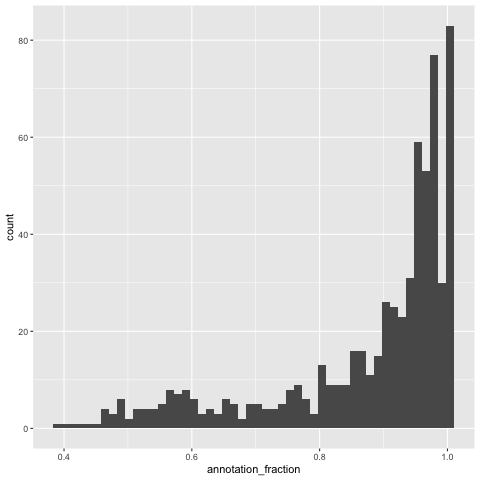

In [241]:
%%R
library(ggplot2)
ggplot(DA_results_2KORII, aes(annotation_fraction)) + geom_histogram(bins=50)

In [68]:
%%R -o DA_results_2KORII
DA_results_2KORII$annotation <- ifelse(DA_results_2KORII$annotation_fraction < 0.5, "Mixed", DA_results_2KORII$annotation)

save(DA_results_2KORII, file = "intermediate/milo_LN_2KO_RII_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [243]:
DA_results_2KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,0.802506,10.063444,0.999473,3.175132e-01,0.384358,1.0,0.382484,11_Proliferating,0.918919
2,0.847000,10.930922,3.105787,7.810939e-02,0.113294,2.0,0.116020,01_Naive,1.000000
3,2.790818,10.063043,9.778447,1.781450e-03,0.003559,3.0,0.003833,01_Naive,1.000000
4,-1.181781,11.360897,13.637825,2.253540e-04,0.000527,4.0,0.000567,01_Naive,0.808333
5,2.183002,10.859066,12.339351,4.496081e-04,0.000993,5.0,0.001070,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-3.146852,10.319244,24.804971,6.677307e-07,0.000002,640.0,0.000003,01_Naive,0.958333
641,-1.221837,10.479181,2.323546,1.275274e-01,0.172175,641.0,0.176887,01_Naive,1.000000
642,-0.260935,10.534847,0.143796,7.045609e-01,0.751684,642.0,0.743268,01_Naive,0.983051
643,3.314587,10.497024,10.872495,9.866270e-04,0.002050,643.0,0.002204,01_Naive,0.771930


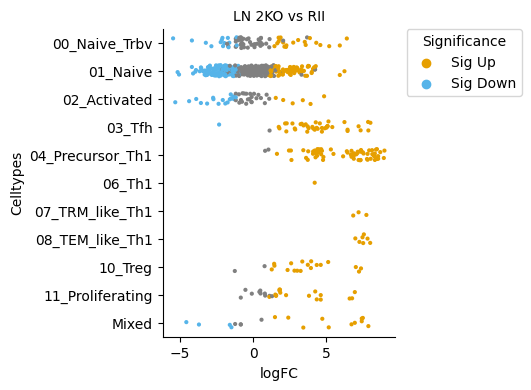

In [244]:
plot_diff_analysis_results(DA_results_2KORII, title = 'LN 2KO vs RII',outbase='figures/')

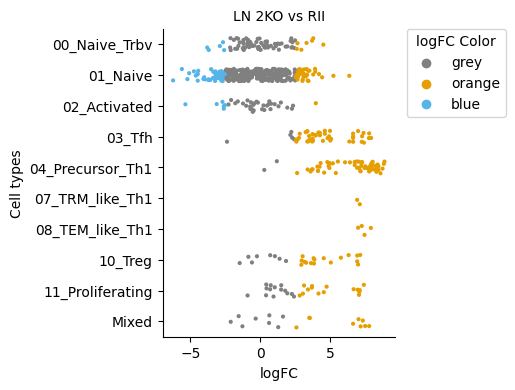

In [77]:
plot_diff_analysis_results_fc(DA_results_2KORII, title = 'LN 2KO vs RII',outbase='figures/')

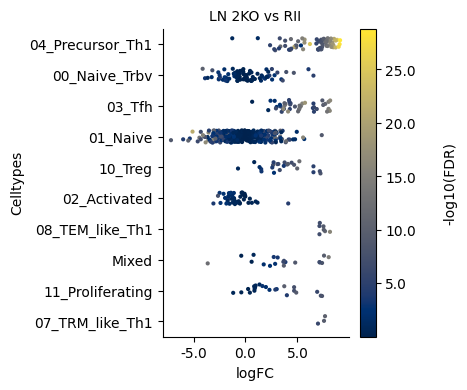

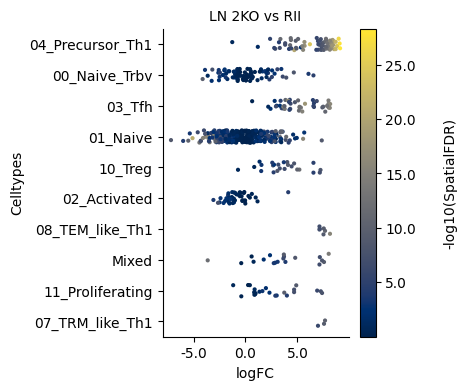

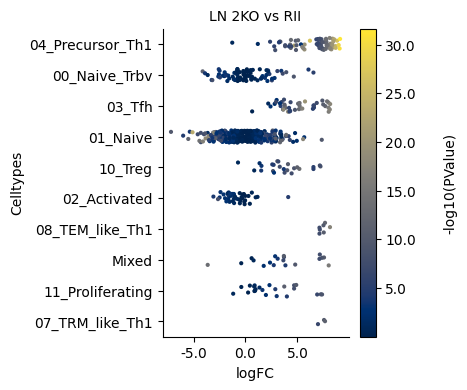

In [86]:
plot_diff_analysis_results_scale(DA_results_2KORII, title = 'LN 2KO vs RII',outbase='figures/')

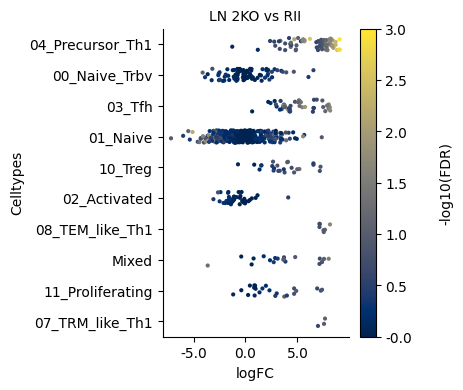

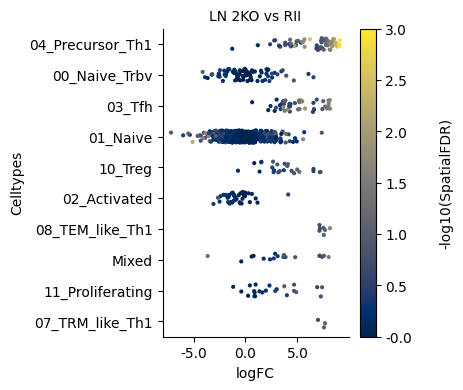

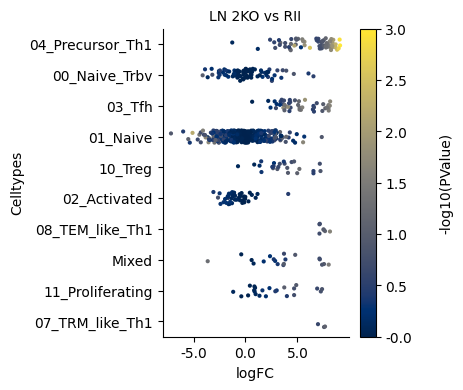

In [92]:
# after scale bar global adjustment
plot_diff_analysis_results_scale(DA_results_2KORII, title = 'LN 2KO vs RII',outbase='figures/')

##### 2KO vs PD1

In [69]:
%%R -i design_df -o DA_results_2KOPD1
contrast.1 <- c("genotype2KO - genotypePD1")

## Test for differential abundance
DA_results_2KOPD1 <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_2KOPD1 <- annotateNhoods(r_milo, DA_results_2KOPD1, coldata_col = "annotation")

R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


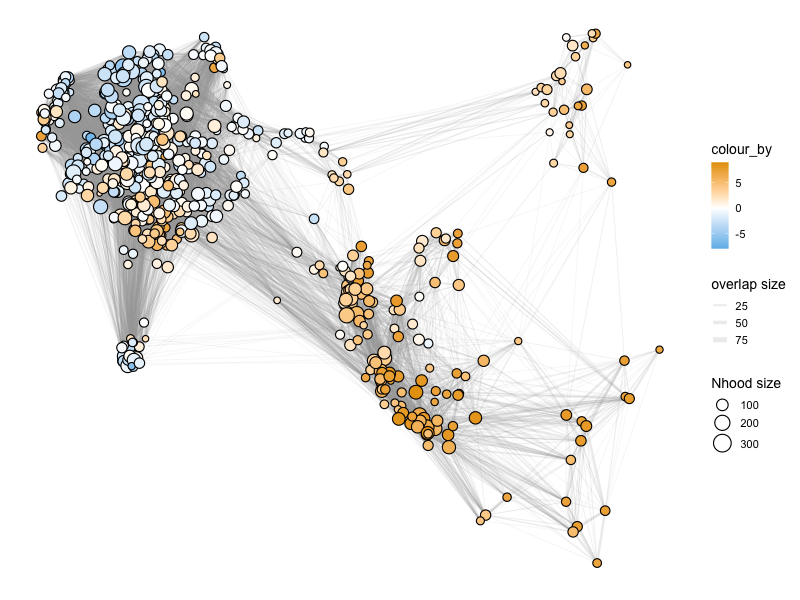

In [245]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_2KOPD1, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LN_2KO_PD1.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [246]:
DA_results_2KOPD1

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,0.819489,10.063444,1.178469,0.277749,0.333092,1.0,0.333858,11_Proliferating,0.918919
2,2.531527,10.930922,17.351495,0.000032,0.000074,2.0,0.000080,01_Naive,1.000000
3,2.120927,10.063043,8.209791,0.004193,0.007260,3.0,0.007361,01_Naive,1.000000
4,1.649327,11.360897,10.861903,0.000992,0.001826,4.0,0.001823,01_Naive,0.808333
5,2.143571,10.859066,13.873492,0.000199,0.000413,5.0,0.000429,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-0.235367,10.319244,0.053607,0.816917,0.843100,640.0,0.842462,01_Naive,0.958333
641,-2.172848,10.479181,11.496888,0.000706,0.001325,641.0,0.001327,01_Naive,1.000000
642,-0.875470,10.534847,2.273676,0.131686,0.171324,642.0,0.174641,01_Naive,0.983051
643,0.637443,10.497024,1.180521,0.277331,0.333092,643.0,0.333858,01_Naive,0.771930


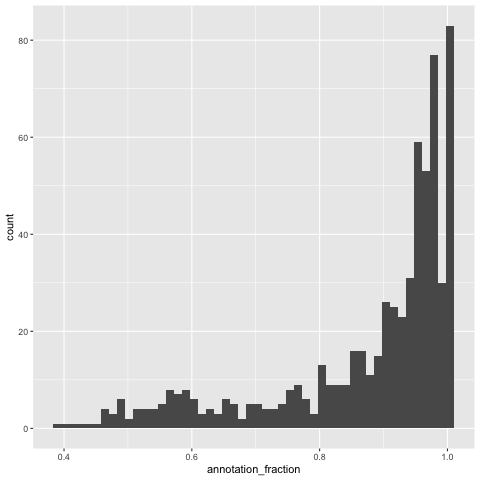

In [247]:
%%R
library(ggplot2)
ggplot(DA_results_2KOPD1, aes(annotation_fraction)) + geom_histogram(bins=50)

In [70]:
%%R -o DA_results_2KOPD1
DA_results_2KOPD1$annotation <- ifelse(DA_results_2KOPD1$annotation_fraction < 0.5, "Mixed", DA_results_2KOPD1$annotation)

save(DA_results_2KOPD1, file = "intermediate/milo_LN_2KO_PD1_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [249]:
DA_results_2KOPD1

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,0.819489,10.063444,1.178469,0.277749,0.333092,1.0,0.333858,11_Proliferating,0.918919
2,2.531527,10.930922,17.351495,0.000032,0.000074,2.0,0.000080,01_Naive,1.000000
3,2.120927,10.063043,8.209791,0.004193,0.007260,3.0,0.007361,01_Naive,1.000000
4,1.649327,11.360897,10.861903,0.000992,0.001826,4.0,0.001823,01_Naive,0.808333
5,2.143571,10.859066,13.873492,0.000199,0.000413,5.0,0.000429,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-0.235367,10.319244,0.053607,0.816917,0.843100,640.0,0.842462,01_Naive,0.958333
641,-2.172848,10.479181,11.496888,0.000706,0.001325,641.0,0.001327,01_Naive,1.000000
642,-0.875470,10.534847,2.273676,0.131686,0.171324,642.0,0.174641,01_Naive,0.983051
643,0.637443,10.497024,1.180521,0.277331,0.333092,643.0,0.333858,01_Naive,0.771930


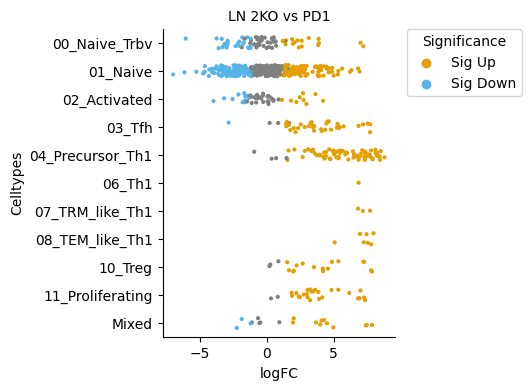

In [250]:
plot_diff_analysis_results(DA_results_2KOPD1, title = 'LN 2KO vs PD1',outbase='figures/')

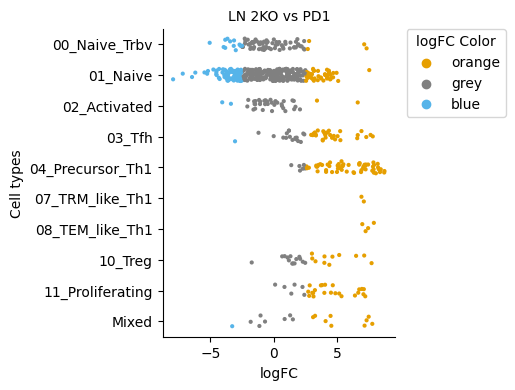

In [78]:
plot_diff_analysis_results_fc(DA_results_2KOPD1, title = 'LN 2KO vs PD1',outbase='figures/')

##### 3KO vs 2KO

In [71]:
%%R -i design_df -o DA_results_3KO2KO
contrast.1 <- c("genotype3KO - genotype2KO")

## Test for differential abundance
DA_results_3KO2KO <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_3KO2KO <- annotateNhoods(r_milo, DA_results_3KO2KO, coldata_col = "annotation")


R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


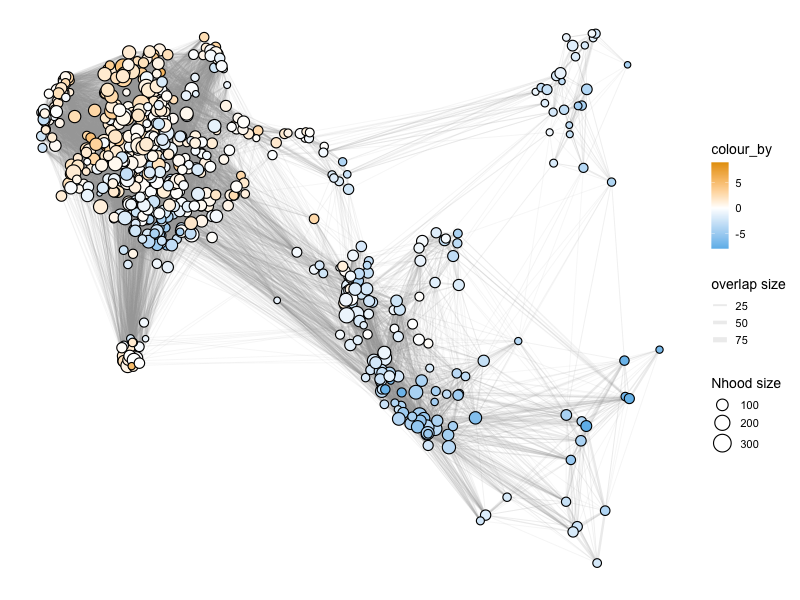

In [251]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_3KO2KO, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LN_3KO_2KO.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [252]:
DA_results_3KO2KO

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-0.765284,10.063444,1.219631,2.695156e-01,3.546845e-01,1.0,3.498440e-01,11_Proliferating,0.918919
2,-1.133178,10.930922,6.667239,9.863899e-03,1.948574e-02,2.0,1.909814e-02,01_Naive,1.000000
3,-3.362855,10.063043,16.172681,5.914920e-05,1.885747e-04,3.0,1.947511e-04,01_Naive,1.000000
4,-1.833412,11.360897,14.783460,1.229209e-04,3.614661e-04,4.0,3.618332e-04,01_Naive,0.808333
5,0.252661,10.859066,0.524827,4.688427e-01,5.498050e-01,5.0,5.504045e-01,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-0.484297,10.319244,0.205189,6.505955e-01,7.202936e-01,640.0,7.252491e-01,01_Naive,0.958333
641,1.386084,10.479181,3.981548,4.608540e-02,7.649225e-02,641.0,7.648269e-02,01_Naive,1.000000
642,0.085245,10.534847,0.018640,8.914117e-01,9.159801e-01,642.0,9.169719e-01,01_Naive,0.983051
643,0.140570,10.497024,0.087495,7.674049e-01,8.141825e-01,643.0,8.226897e-01,01_Naive,0.771930


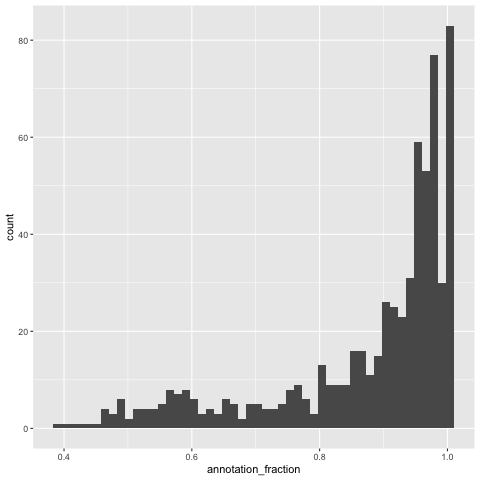

In [253]:
%%R
library(ggplot2)
ggplot(DA_results_3KO2KO, aes(annotation_fraction)) + geom_histogram(bins=50)

In [72]:
%%R -o DA_results_3KO2KO
DA_results_3KO2KO$annotation <- ifelse(DA_results_3KO2KO$annotation_fraction < 0.5, "Mixed", DA_results_3KO2KO$annotation)

save(DA_results_3KO2KO, file = "intermediate/milo_LN_3KO_2KO_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [255]:
DA_results_3KO2KO

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-0.765284,10.063444,1.219631,2.695156e-01,3.546845e-01,1.0,3.498440e-01,11_Proliferating,0.918919
2,-1.133178,10.930922,6.667239,9.863899e-03,1.948574e-02,2.0,1.909814e-02,01_Naive,1.000000
3,-3.362855,10.063043,16.172681,5.914920e-05,1.885747e-04,3.0,1.947511e-04,01_Naive,1.000000
4,-1.833412,11.360897,14.783460,1.229209e-04,3.614661e-04,4.0,3.618332e-04,01_Naive,0.808333
5,0.252661,10.859066,0.524827,4.688427e-01,5.498050e-01,5.0,5.504045e-01,03_Tfh,1.000000
...,...,...,...,...,...,...,...,...,...
640,-0.484297,10.319244,0.205189,6.505955e-01,7.202936e-01,640.0,7.252491e-01,01_Naive,0.958333
641,1.386084,10.479181,3.981548,4.608540e-02,7.649225e-02,641.0,7.648269e-02,01_Naive,1.000000
642,0.085245,10.534847,0.018640,8.914117e-01,9.159801e-01,642.0,9.169719e-01,01_Naive,0.983051
643,0.140570,10.497024,0.087495,7.674049e-01,8.141825e-01,643.0,8.226897e-01,01_Naive,0.771930


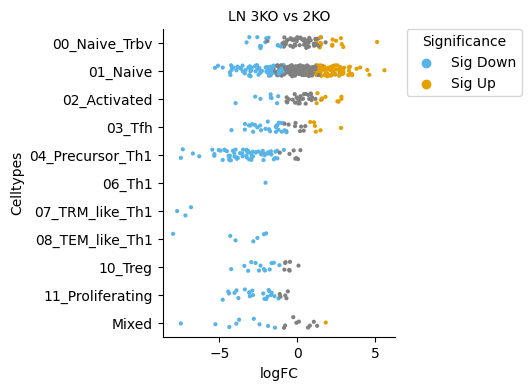

In [256]:
plot_diff_analysis_results(DA_results_3KO2KO, title = 'LN 3KO vs 2KO',outbase='figures/')

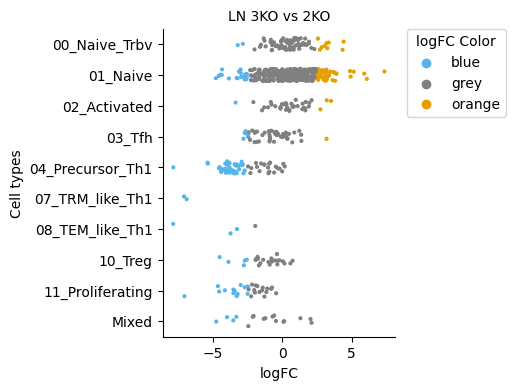

In [79]:
plot_diff_analysis_results_fc(DA_results_3KO2KO, title = 'LN 3KO vs 2KO',outbase='figures/')

##### 3KO vs RII

In [73]:
%%R -i design_df -o DA_results_3KORII
contrast.1 <- c("genotype3KO - genotypeRII")

## Test for differential abundance
DA_results_3KORII <- testNhoods(r_milo, design =  ~ 0 + genotype, design.df = design_df, model.contrasts = contrast.1, fdr.weighting="graph-overlap")
## annotate nhoods
DA_results_3KORII <- annotateNhoods(r_milo, DA_results_3KORII, coldata_col = "annotation")


R[write to console]: Using TMM normalisation

R[write to console]: Performing spatial FDR correction withgraph-overlap weighting



Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


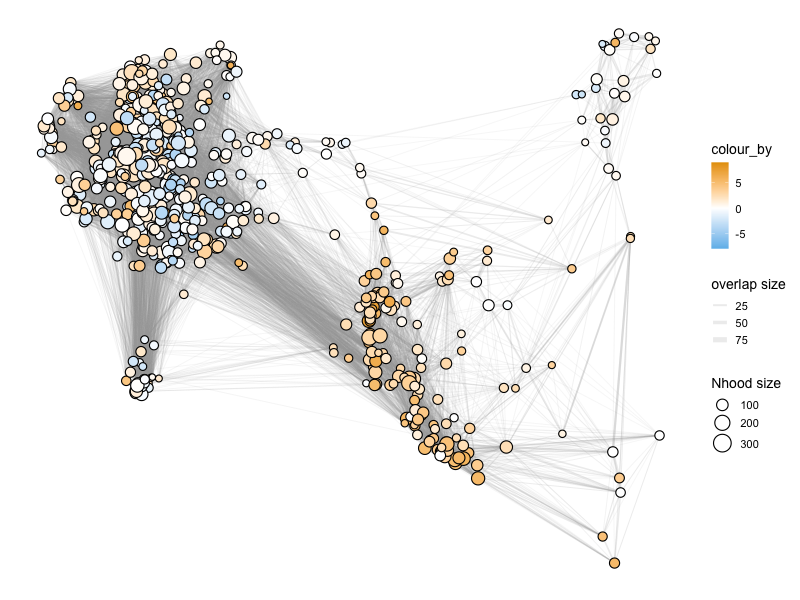

In [295]:
%%R -w 800 -h 600
r_milo <- buildNhoodGraph(r_milo)
alpha_val = 1
p1 <- plotNhoodGraphDA(r_milo, DA_results_3KORII, res_column = 'logFC', alpha=alpha_val, 
                 layout="UMAP", size_range = c(2, 8), node_stroke =0.8)
# Adjust the color scale for a continuous variable
p1 <- p1 + scale_fill_gradient2(low = "#56B4E9", high = "#E69F00", limits = c(global_min_logFC, global_max_logFC))
p1
print(p1)
# Save the plot to a file
ggsave("figures/milo_LN_3KO_RII.pdf", plot = p1, width = 8, height = 6, dpi = 300)

In [296]:
DA_results_3KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-0.103682,10.850253,0.027789,8.676157e-01,9.219826e-01,1.0,9.341295e-01,01_Naive,0.974684
2,3.754831,10.305585,3.048430,8.091136e-02,1.444200e-01,2.0,1.673523e-01,04_Precursor_Th1,0.583333
3,-2.898606,11.106167,43.581429,4.743832e-11,1.515654e-09,3.0,3.597969e-09,01_Naive,0.959184
4,-0.323135,10.447153,0.073249,7.866807e-01,8.585373e-01,4.0,8.781928e-01,01_Naive,0.963636
5,-4.400121,10.714162,39.313186,4.094705e-10,9.344701e-09,5.0,1.967534e-08,01_Naive,0.857143
...,...,...,...,...,...,...,...,...,...
635,-0.024285,10.804852,0.001672,9.673896e-01,9.938295e-01,635.0,1.000000e+00,01_Naive,1.000000
636,2.518998,10.876928,11.483430,7.107016e-04,2.523426e-03,636.0,3.786289e-03,03_Tfh,1.000000
637,2.369576,10.284096,1.022582,3.119840e-01,4.266268e-01,637.0,4.590498e-01,04_Precursor_Th1,0.957447
638,-2.025426,11.177136,20.667588,5.666100e-06,3.811198e-05,638.0,6.681143e-05,01_Naive,0.980769


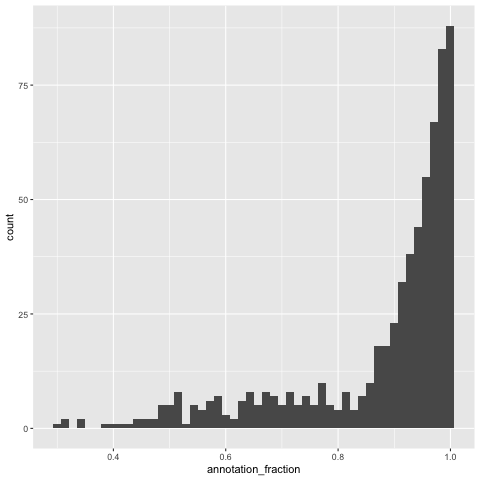

In [297]:
%%R
library(ggplot2)
ggplot(DA_results_3KORII, aes(annotation_fraction)) + geom_histogram(bins=50)

In [74]:
%%R -o DA_results_3KORII
DA_results_3KORII$annotation <- ifelse(DA_results_3KORII$annotation_fraction < 0.5, "Mixed", DA_results_3KORII$annotation)

save(DA_results_3KORII, file = "intermediate/milo_LN_3KO_RII_df.RData")
# Load the dataframe
#load("intermediate/milo_LV_RII_WT_df.RData")

In [299]:
DA_results_3KORII

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,annotation,annotation_fraction
1,-0.103682,10.850253,0.027789,8.676157e-01,9.219826e-01,1.0,9.341295e-01,01_Naive,0.974684
2,3.754831,10.305585,3.048430,8.091136e-02,1.444200e-01,2.0,1.673523e-01,04_Precursor_Th1,0.583333
3,-2.898606,11.106167,43.581429,4.743832e-11,1.515654e-09,3.0,3.597969e-09,01_Naive,0.959184
4,-0.323135,10.447153,0.073249,7.866807e-01,8.585373e-01,4.0,8.781928e-01,01_Naive,0.963636
5,-4.400121,10.714162,39.313186,4.094705e-10,9.344701e-09,5.0,1.967534e-08,01_Naive,0.857143
...,...,...,...,...,...,...,...,...,...
635,-0.024285,10.804852,0.001672,9.673896e-01,9.938295e-01,635.0,1.000000e+00,01_Naive,1.000000
636,2.518998,10.876928,11.483430,7.107016e-04,2.523426e-03,636.0,3.786289e-03,03_Tfh,1.000000
637,2.369576,10.284096,1.022582,3.119840e-01,4.266268e-01,637.0,4.590498e-01,04_Precursor_Th1,0.957447
638,-2.025426,11.177136,20.667588,5.666100e-06,3.811198e-05,638.0,6.681143e-05,01_Naive,0.980769


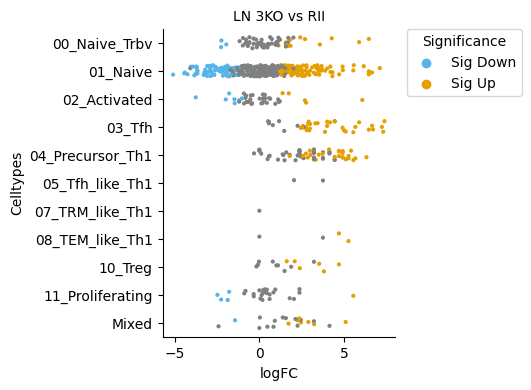

In [300]:
plot_diff_analysis_results(DA_results_3KORII, title = 'LN 3KO vs RII',outbase='figures/')

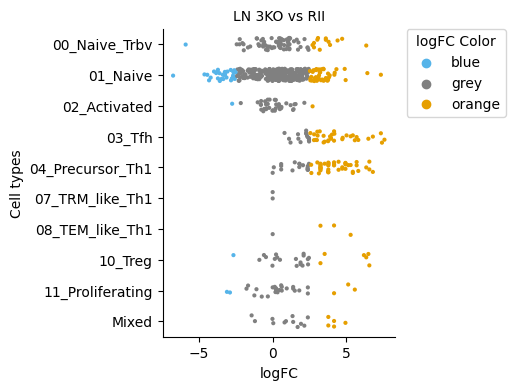

In [80]:
plot_diff_analysis_results_fc(DA_results_3KORII, title = 'LN 3KO vs RII',outbase='figures/')

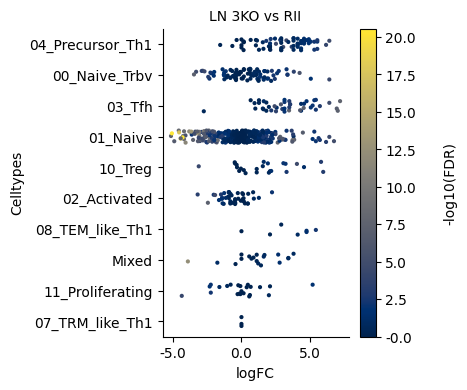

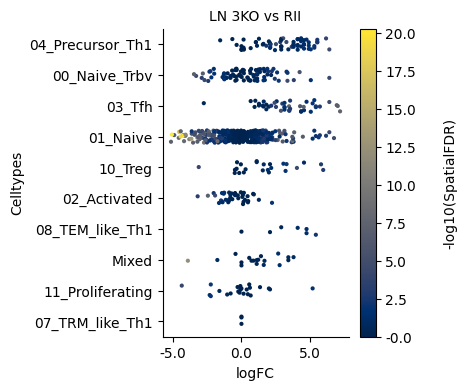

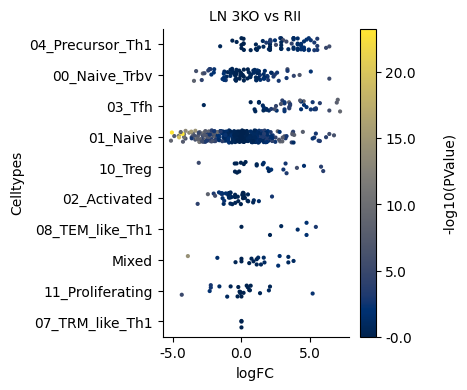

In [89]:
plot_diff_analysis_results_scale(DA_results_3KORII, title = 'LN 3KO vs RII',outbase='figures/')

## Plot in batch

In [ ]:
%%R
comparisons = list(c('RII', 'WT'), c('PD1', 'WT'), c('2KO', 'RII'), c('2KO', 'PD1'), c('3KO', '2KO'))

# Loop through each item in the comparisons list
for (item in comparisons) {
    filename = sprintf("intermediate/milo_LV_%s_%s_df.RData", item[1], item[2])
    print(filename)

    dfname = sprintf("DA_results_%s%s", item[1], item[2])
    print(dfname)

    csvname = sprintf("intermediate/milo_LV_%s_%s_df.csv", item[1], item[2])
    print(csvname)
}

[1] "intermediate/milo_LV_RII_WT_df.RData"
[1] "DA_results_RIIWT"
[1] "intermediate/milo_LV_RII_WT_df.csv"
[1] "intermediate/milo_LV_PD1_WT_df.RData"
[1] "DA_results_PD1WT"
[1] "intermediate/milo_LV_PD1_WT_df.csv"
[1] "intermediate/milo_LV_2KO_RII_df.RData"
[1] "DA_results_2KORII"
[1] "intermediate/milo_LV_2KO_RII_df.csv"
[1] "intermediate/milo_LV_2KO_PD1_df.RData"
[1] "DA_results_2KOPD1"
[1] "intermediate/milo_LV_2KO_PD1_df.csv"
[1] "intermediate/milo_LV_3KO_2KO_df.RData"
[1] "DA_results_3KO2KO"
[1] "intermediate/milo_LV_3KO_2KO_df.csv"


In [ ]:
%%R
# re-save all the differential analysis data in csv formate for easier direct access in python
load("intermediate/milo_LV_RII_WT_df.RData")
write.csv(DA_results_RIIWT, "intermediate/milo_LV_RII_WT_df.csv", row.names = FALSE)

load("intermediate/milo_LV_PD1_WT_df.RData")
write.csv(DA_results_PD1WT, "intermediate/milo_LV_PD1_WT_df.csv", row.names = FALSE)

load("intermediate/milo_LV_2KO_RII_df.RData")
write.csv(DA_results_2KORII, "intermediate/milo_LV_2KO_RII_df.csv", row.names = FALSE)

load("intermediate/milo_LV_2KO_PD1_df.RData")
write.csv(DA_results_2KOPD1, "intermediate/milo_LV_2KO_PD1_df.csv", row.names = FALSE)

load("intermediate/milo_LV_3KO_2KO_df.RData")
write.csv(DA_results_3KO2KO, "intermediate/milo_LV_3KO_2KO_df.csv", row.names = FALSE)

load("intermediate/milo_LN_RII_WT_df.RData")
write.csv(DA_results_RIIWT, "intermediate/milo_LN_RII_WT_df.csv", row.names = FALSE)

load("intermediate/milo_LN_PD1_WT_df.RData")
write.csv(DA_results_PD1WT, "intermediate/milo_LN_PD1_WT_df.csv", row.names = FALSE)

load("intermediate/milo_LN_2KO_RII_df.RData")
write.csv(DA_results_2KORII, "intermediate/milo_LN_2KO_RII_df.csv", row.names = FALSE)

load("intermediate/milo_LN_2KO_PD1_df.RData")
write.csv(DA_results_2KOPD1, "intermediate/milo_LN_2KO_PD1_df.csv", row.names = FALSE)

load("intermediate/milo_LN_3KO_2KO_df.RData")
write.csv(DA_results_3KO2KO, "intermediate/milo_LN_3KO_2KO_df.csv", row.names = FALSE)


intermediate/milo_LV_RII_WT_df.csv


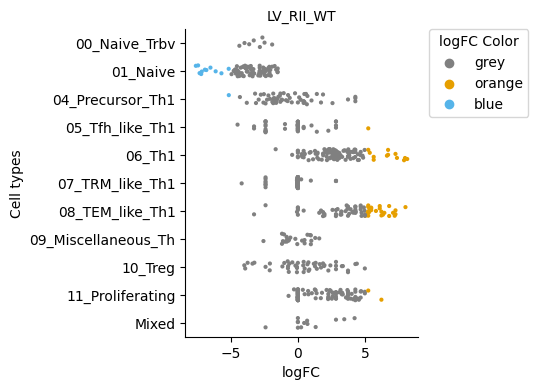

intermediate/milo_LV_PD1_WT_df.csv


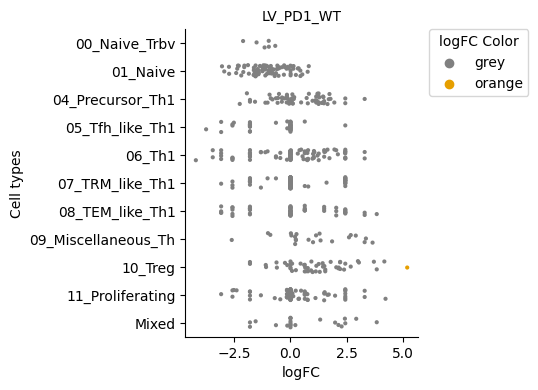

intermediate/milo_LV_2KO_RII_df.csv


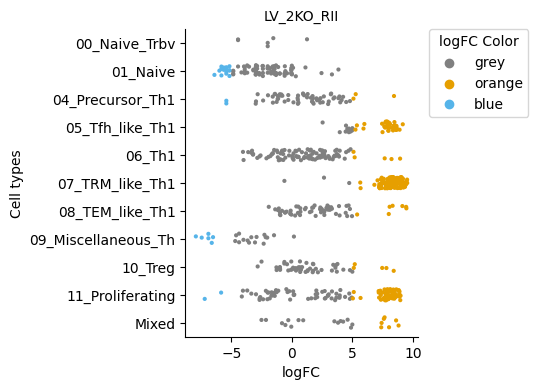

intermediate/milo_LV_2KO_PD1_df.csv


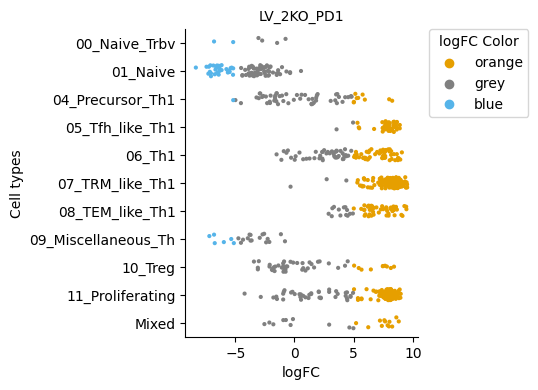

intermediate/milo_LV_3KO_2KO_df.csv


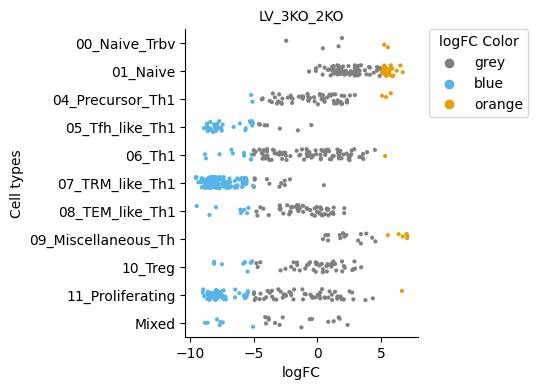

intermediate/milo_LN_RII_WT_df.csv


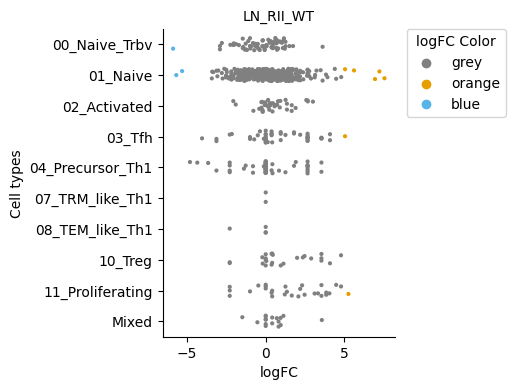

intermediate/milo_LN_PD1_WT_df.csv


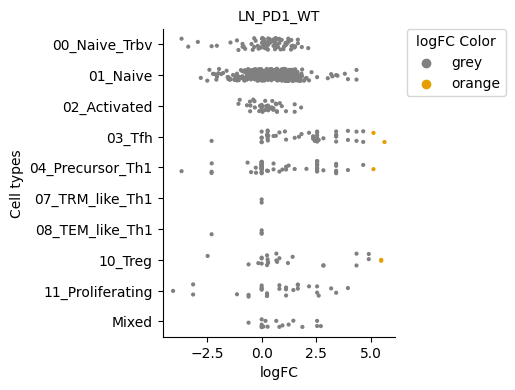

intermediate/milo_LN_2KO_RII_df.csv


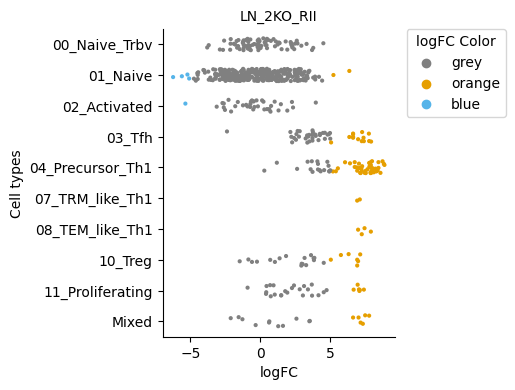

intermediate/milo_LN_2KO_PD1_df.csv


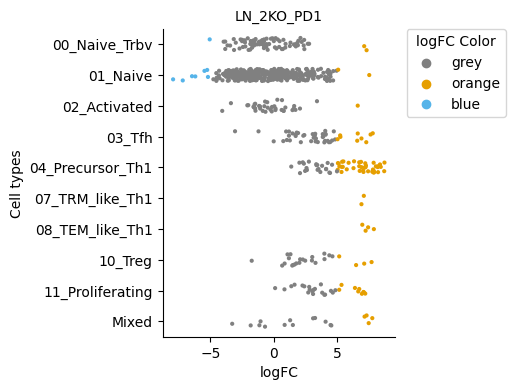

intermediate/milo_LN_3KO_2KO_df.csv


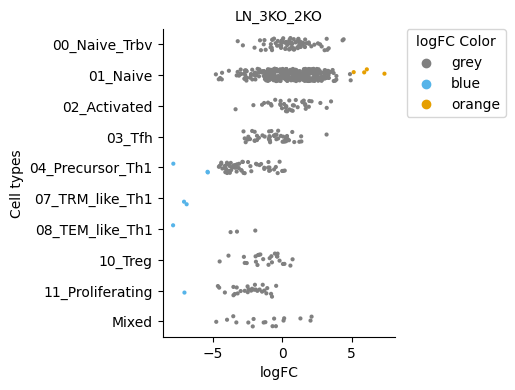

In [ ]:
# now we can directly plot the swarm plots in python
# cut_of set to logFC_cut=5 

comparisons = [('RII', 'WT'), ('PD1', 'WT'), ('2KO', 'RII'), ('2KO', 'PD1'), ('3KO', '2KO')]

for compare in comparisons:
    filename = f"intermediate/milo_LV_{compare[0]}_{compare[1]}_df.csv"
    print(filename)
    input_df = pd.read_csv(filename)
    title = f"LV_{compare[0]}_{compare[1]}"
    plot_diff_analysis_results_fc(input_df, title = title,outbase='figures/', logFC_cut=5)

for compare in comparisons:
    filename = f"intermediate/milo_LN_{compare[0]}_{compare[1]}_df.csv"
    print(filename)
    input_df = pd.read_csv(filename)
    title = f"LN_{compare[0]}_{compare[1]}"
    plot_diff_analysis_results_fc(input_df, title = title,outbase='figures/', logFC_cut=5)


# END